In [1]:
import jax
import jax.nn as jnn
import jax.numpy as jnp
import numpy as np

import equinox as eqx
import diffrax
import optax

In [2]:
import os
os.chdir("..")
from policy.policy_training import DPCTrainer
from exciting_environments.pmsm.pmsm_env import PMSM
from policy.networks import MLP#,MLP2
import matplotlib.pyplot as plt

2024-12-01 12:02:39.664624: W external/xla/xla/service/gpu/nvptx_compiler.cc:760] The NVIDIA driver's CUDA version is 12.2 which is older than the ptxas CUDA version (12.6.77). Because the driver is older than the ptxas version, XLA is disabling parallel compilation, which may slow down compilation. You should update your NVIDIA driver or use the NVIDIA-provided CUDA forward compatibility packages.


In [3]:
gpus = jax.devices()
jax.config.update("jax_default_device", gpus[0])

## Model Learning

In [4]:
from utils.interactions import rollout_traj_env_policy
from models.model_training import ModelTrainer
from models.models import NeuralEulerODE

In [5]:
def featurize_node(obs):
    return obs[:2]

In [6]:
import json
with open('model_data/dmpe4.json') as json_data:
    d = json.load(json_data)
long_obs=jnp.array(d["observations"])
long_acts=jnp.array(d["actions"])
long_obs_train=long_obs[:-400]
long_acts_train=long_acts[:-400]
long_obs_val=long_obs[-400:]
long_acts_val=long_acts[-399:]

In [7]:
def data_gen_single(rng, sequence_len):
    rng, subkey = jax.random.split(rng)
    idx = jax.random.randint(subkey, shape=(1,),minval=0, maxval=(long_obs_train.shape[0]-sequence_len-1))

    slice = jnp.linspace(
            start=idx, stop=idx + sequence_len, num=sequence_len+1, dtype=int
        ).T
    act_slice = jnp.linspace(
            start=idx, stop=idx + sequence_len-1, num=sequence_len, dtype=int
        ).T
    
    obs=long_obs_train[slice][0]
    acts=long_acts_train[act_slice][0]
    return obs,acts,rng

In [8]:
@eqx.filter_jit
def val_data_gen_single(rng, sequence_len):
    obs=long_obs_val
    acts=long_acts_val
    return obs,acts,rng

In [9]:
jax_key = jax.random.PRNGKey(4)
node=NeuralEulerODE([4,128,128,128,128,2],key=jax_key)
optimizer_node = optax.adam(1e-4)
opt_state = optimizer_node.init(node)

In [ ]:
batch_size=100
mtrainer=ModelTrainer(
    train_steps=100_000,
    batch_size=batch_size,
    sequence_len=50,
    featurize=featurize_node,
    train_data_gen_sin=data_gen_single,
    val_data_gen_sin= val_data_gen_single,
    model_optimizer=optimizer_node,
    tau= 1e-4
    )
keys=jax.vmap(jax.random.PRNGKey)(np.random.randint(0, 2**31, size=(batch_size,)))

  8%|████████████▉                                                                                                                                                     | 7999/100000 [01:40<18:22, 83.43it/s]

/home/olivers/.conda/envs/venv_proj/lib/python3.11/site-packages/jax/_src/numpy/lax_numpy.py:3042: UserWarning: Explicitly requested dtype float64 requested in asarray is not available, and will be truncated to dtype float32. To enable more dtypes, set the jax_enable_x64 configuration option or the JAX_ENABLE_X64 shell environment variable. See https://github.com/google/jax#current-gotchas for more.
  start = asarray(start, dtype=computation_dtype)
/home/olivers/.conda/envs/venv_proj/lib/python3.11/site-packages/jax/_src/numpy/lax_numpy.py:3043: UserWarning: Explicitly requested dtype float64 requested in asarray is not available, and will be truncated to dtype float32. To enable more dtypes, set the jax_enable_x64 configuration option or the JAX_ENABLE_X64 shell environment variable. See https://github.com/google/jax#current-gotchas for more.
  stop = asarray(stop, dtype=computation_dtype)
/home/olivers/.conda/envs/venv_proj/lib/python3.11/site-packages/jax/_src/numpy/array_methods.py

Current val_loss: 0.11136108


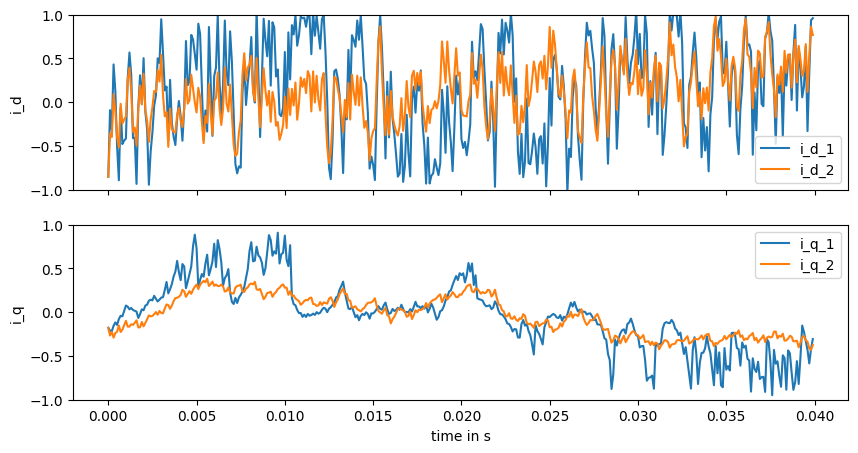

  2%|███▉                                                                                                                                                              | 2455/100000 [00:32<19:27, 83.58it/s]

Current val_loss: 0.04956467


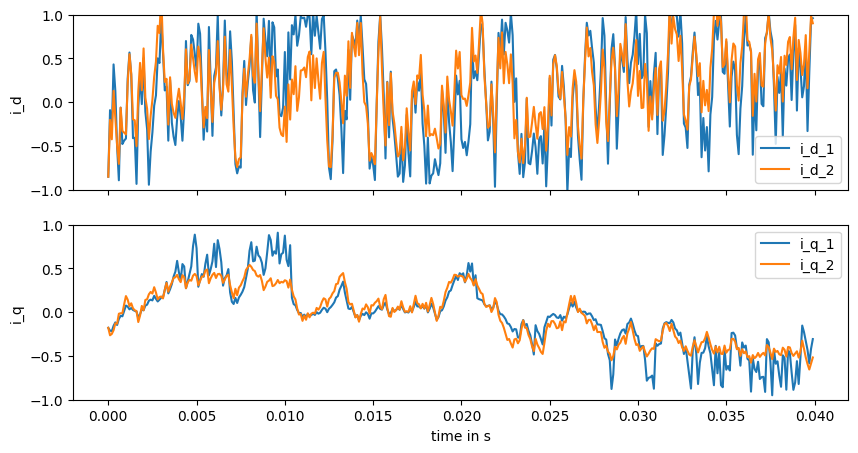

 10%|████████████████▏                                                                                                                                                 | 9992/100000 [02:04<17:58, 83.46it/s]

Current val_loss: 0.038720388


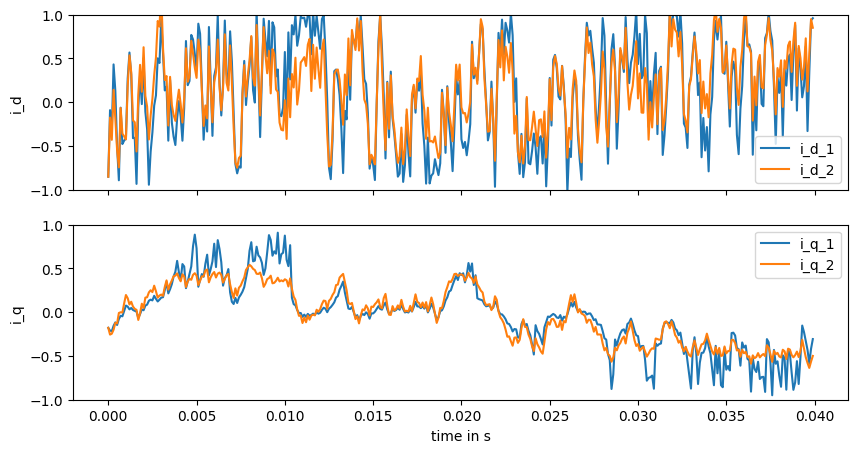

 12%|███████████████████▎                                                                                                                                             | 11999/100000 [02:29<20:50, 70.36it/s]

Current val_loss: 0.032749396


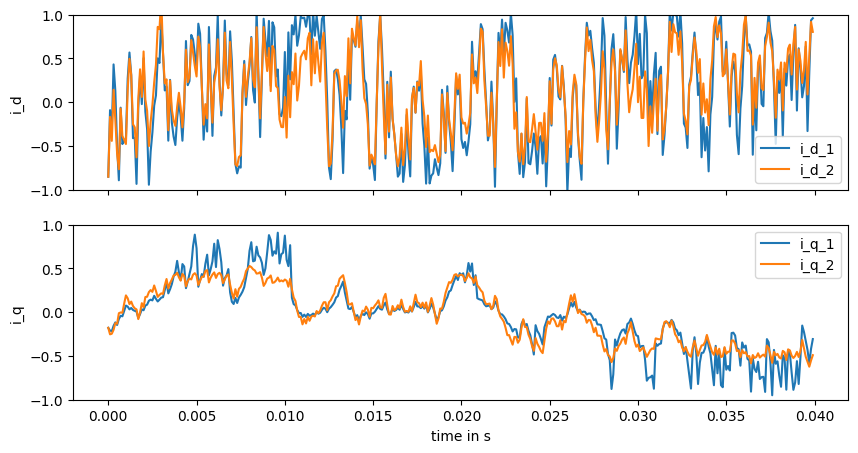

 14%|██████████████████████▌                                                                                                                                          | 13998/100000 [02:58<20:22, 70.37it/s]

Current val_loss: 0.030227337


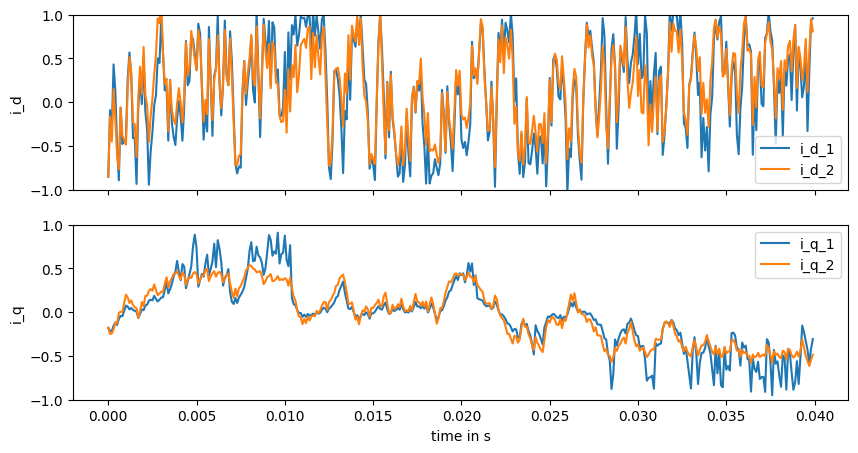

 16%|█████████████████████████▊                                                                                                                                       | 15994/100000 [03:27<20:04, 69.73it/s]

Current val_loss: 0.027023034


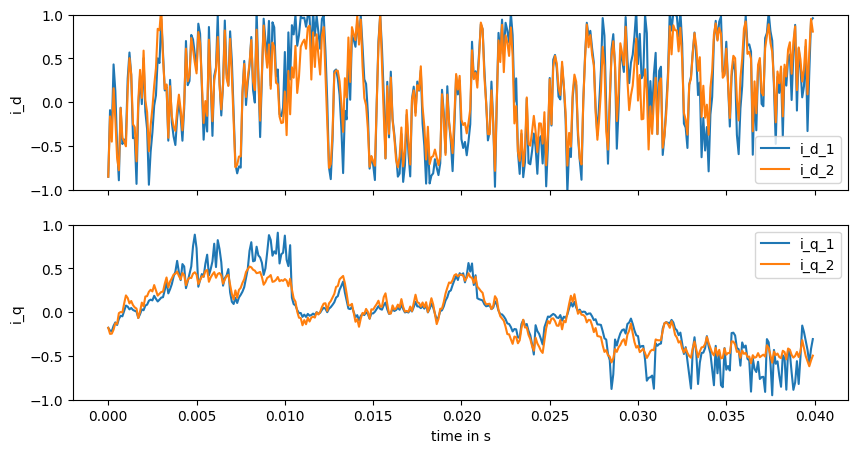

 18%|████████████████████████████▉                                                                                                                                    | 17998/100000 [03:56<19:35, 69.78it/s]

Current val_loss: 0.031550158


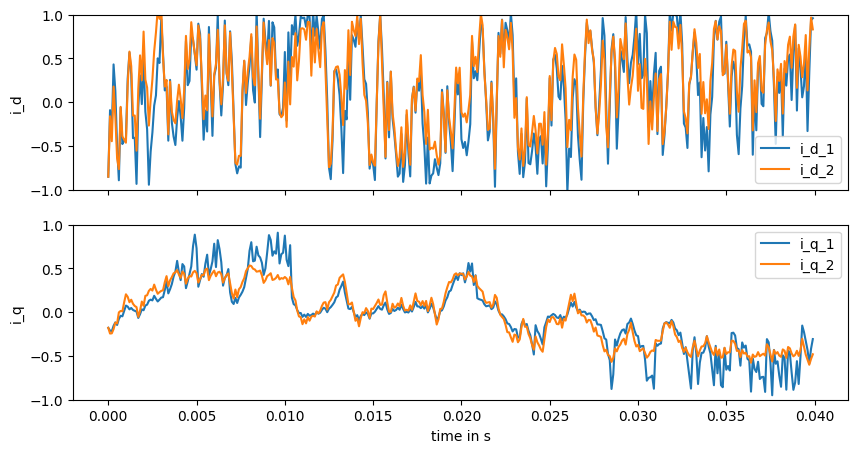

 20%|████████████████████████████████▏                                                                                                                                | 20000/100000 [04:21<15:56, 83.65it/s]

Current val_loss: 0.026531963


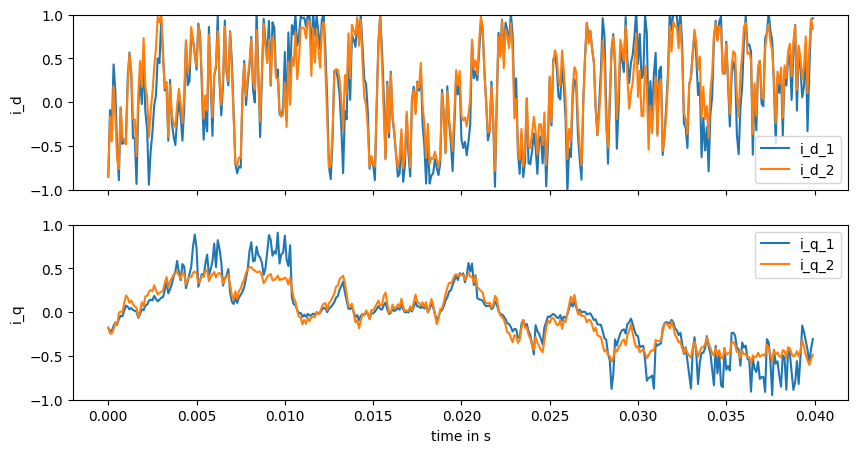

 22%|███████████████████████████████████▍                                                                                                                             | 21998/100000 [04:45<15:33, 83.54it/s]

Current val_loss: 0.028822927


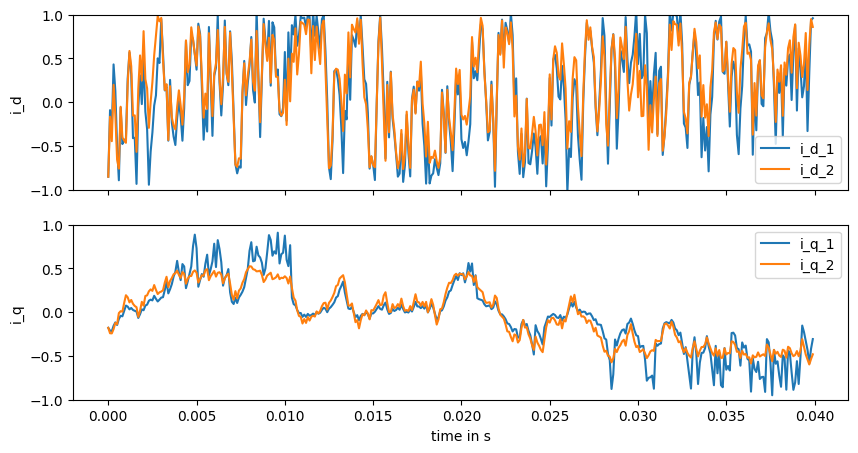

 24%|██████████████████████████████████████▋                                                                                                                          | 23996/100000 [05:10<15:25, 82.11it/s]

Current val_loss: 0.022745486


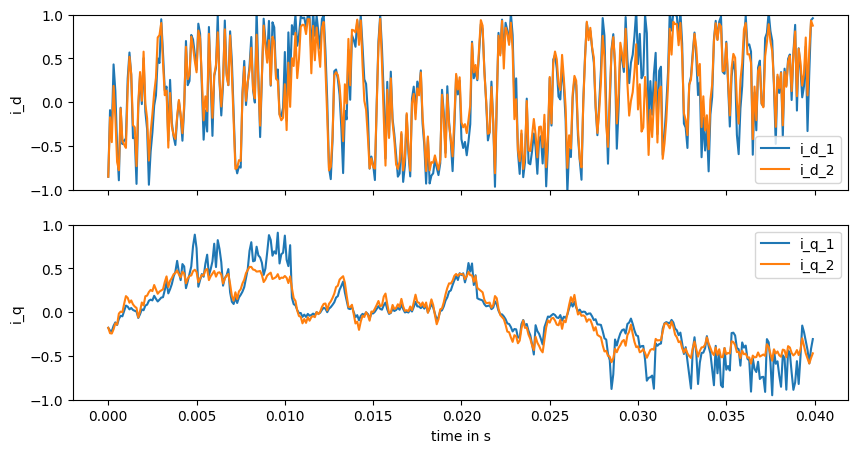

 26%|█████████████████████████████████████████▊                                                                                                                       | 25994/100000 [05:34<14:44, 83.63it/s]

Current val_loss: 0.02293037


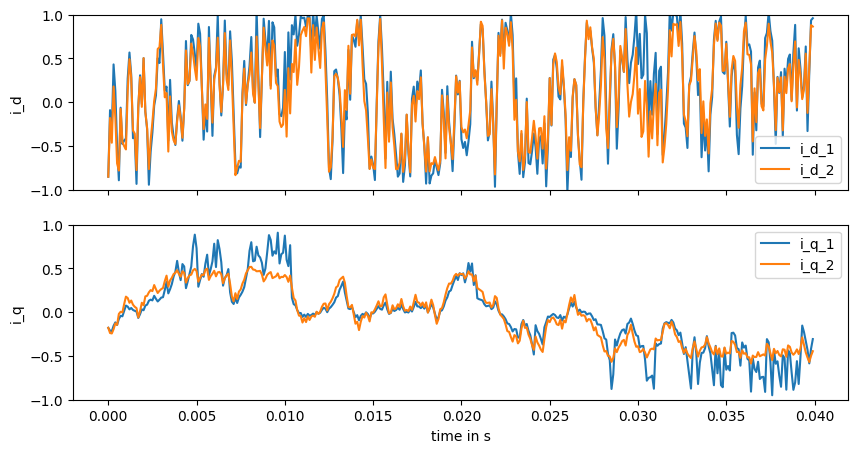

 28%|█████████████████████████████████████████████                                                                                                                    | 27992/100000 [05:58<14:24, 83.32it/s]

Current val_loss: 0.022022234


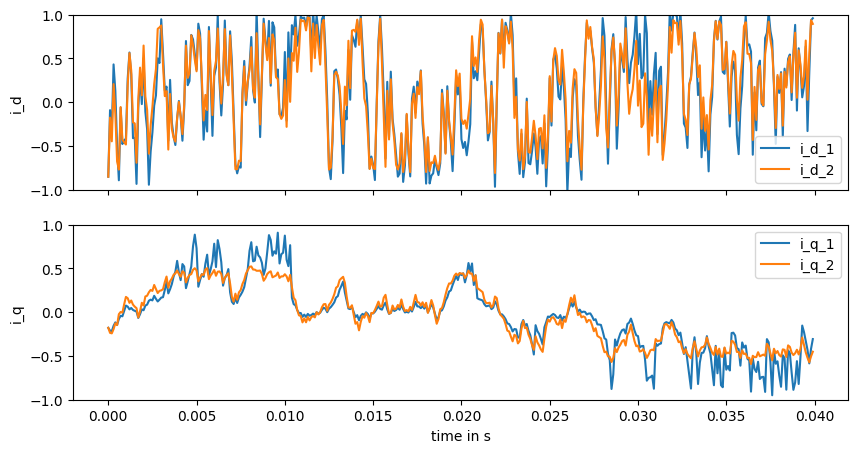

 30%|████████████████████████████████████████████████▎                                                                                                                | 29999/100000 [06:23<13:58, 83.52it/s]

Current val_loss: 0.020726427


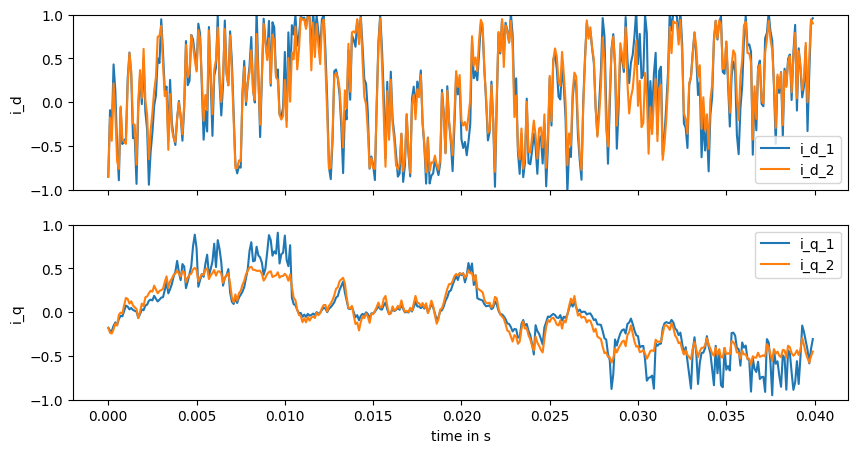

 32%|███████████████████████████████████████████████████▌                                                                                                             | 31997/100000 [06:47<13:35, 83.35it/s]

Current val_loss: 0.021274466


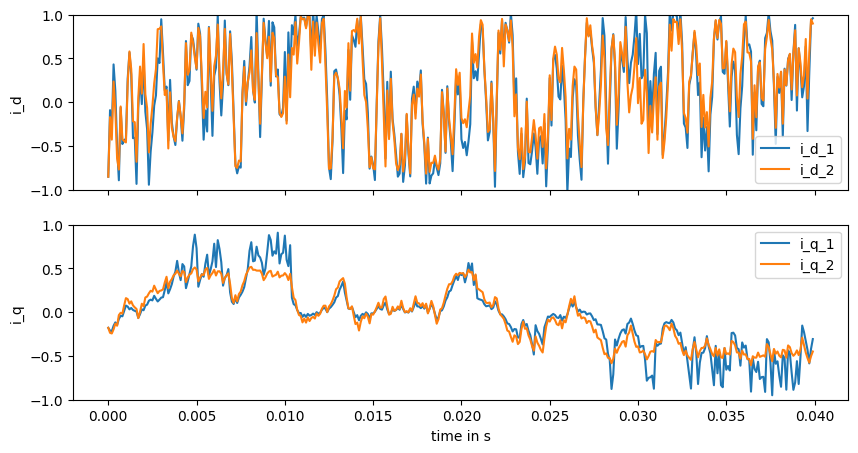

 34%|██████████████████████████████████████████████████████▋                                                                                                          | 33995/100000 [07:12<13:09, 83.59it/s]

Current val_loss: 0.02365563


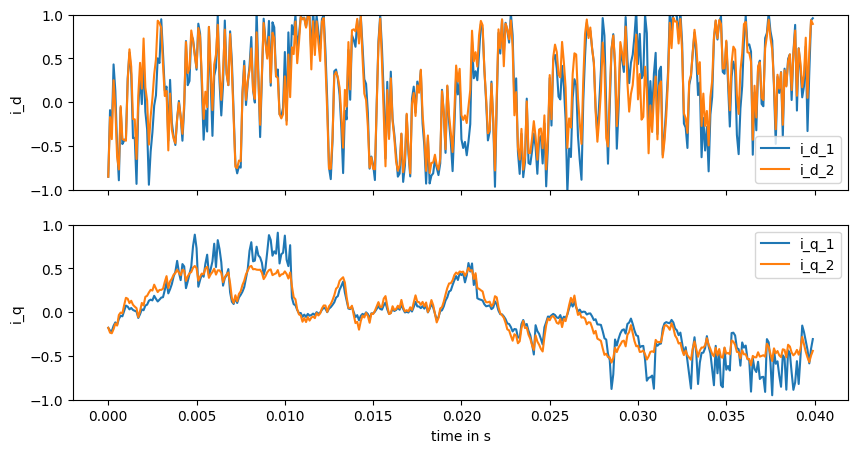

 36%|█████████████████████████████████████████████████████████▉                                                                                                       | 35993/100000 [07:36<12:47, 83.40it/s]

Current val_loss: 0.02486905


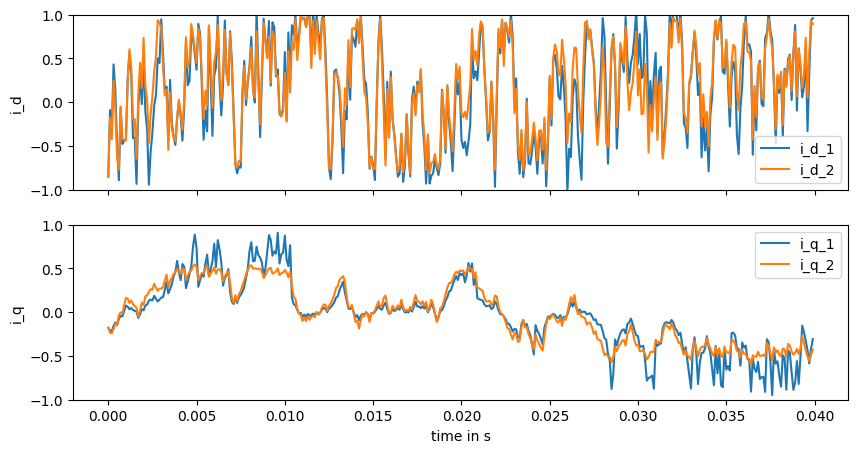

 38%|█████████████████████████████████████████████████████████████▏                                                                                                   | 38000/100000 [08:01<12:23, 83.35it/s]

Current val_loss: 0.02754269


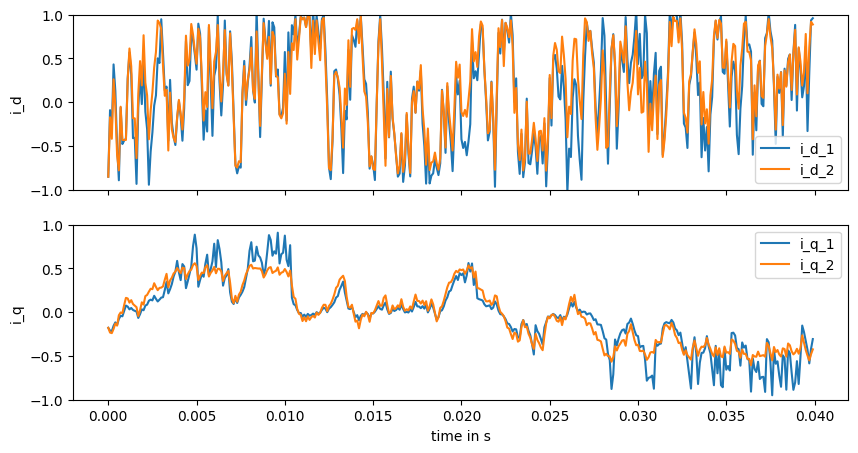

 40%|████████████████████████████████████████████████████████████████▍                                                                                                | 39998/100000 [08:25<11:56, 83.69it/s]

Current val_loss: 0.019127456


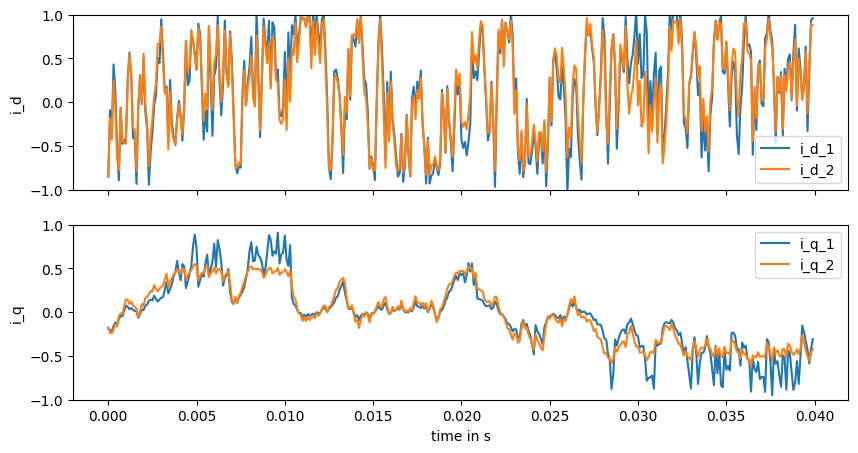

 42%|███████████████████████████████████████████████████████████████████▌                                                                                             | 41996/100000 [08:50<11:33, 83.62it/s]

Current val_loss: 0.023781145


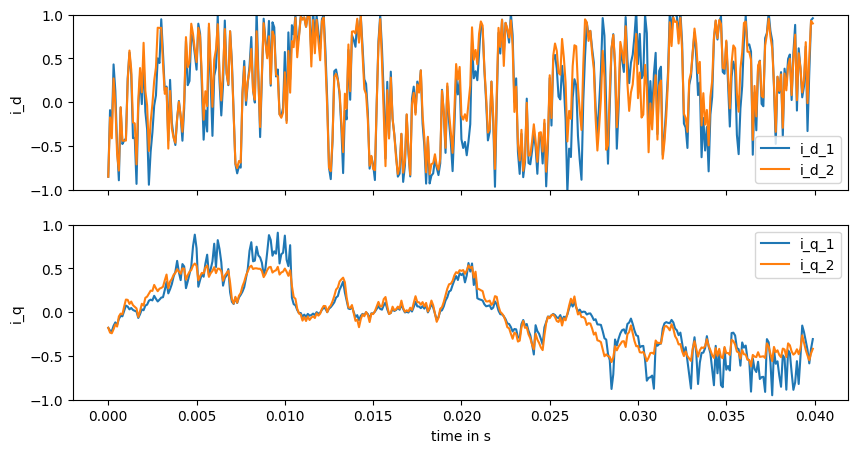

 44%|██████████████████████████████████████████████████████████████████████▊                                                                                          | 43994/100000 [09:14<11:13, 83.21it/s]

Current val_loss: 0.027416509


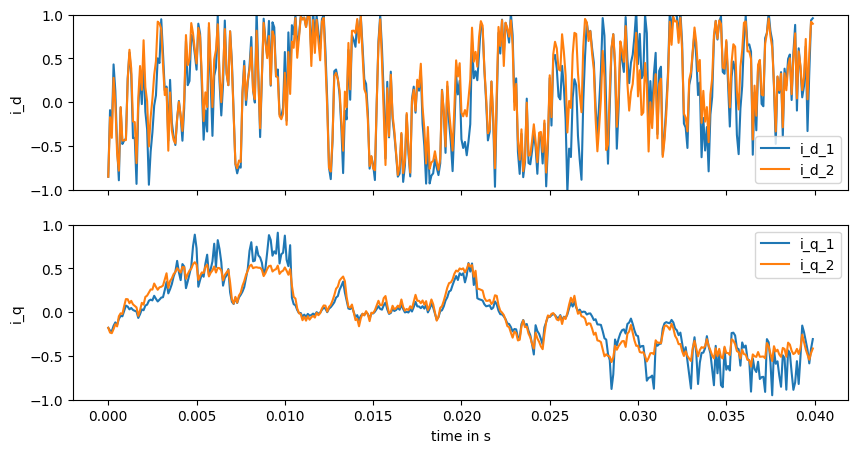

 46%|██████████████████████████████████████████████████████████████████████████                                                                                       | 46000/100000 [09:39<10:58, 82.02it/s]

Current val_loss: 0.019132178


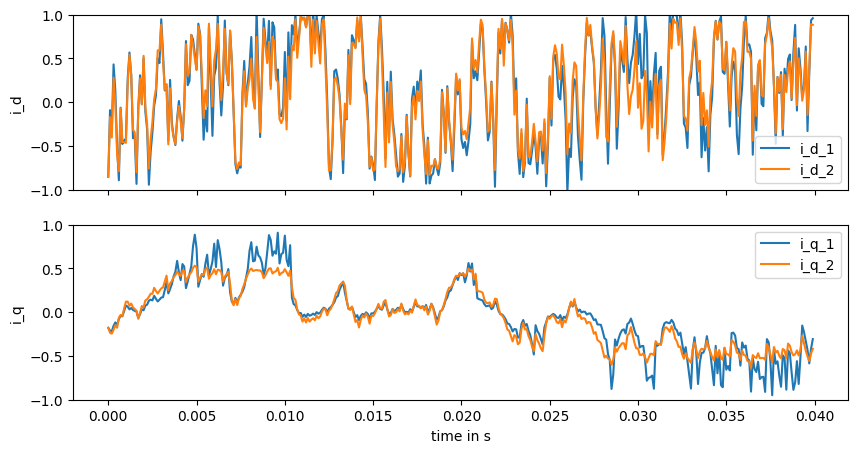

 48%|█████████████████████████████████████████████████████████████████████████████▎                                                                                   | 47998/100000 [10:03<10:27, 82.92it/s]

Current val_loss: 0.020264821


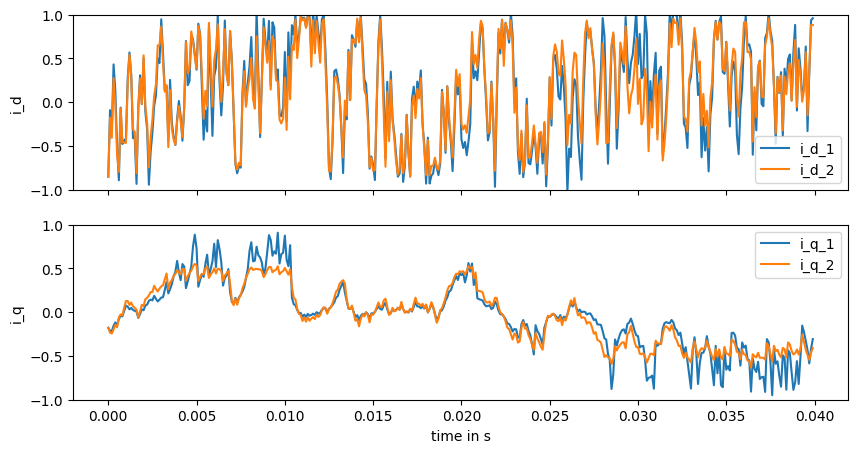

 50%|████████████████████████████████████████████████████████████████████████████████▍                                                                                | 49996/100000 [10:28<10:02, 82.97it/s]

Current val_loss: 0.023208963


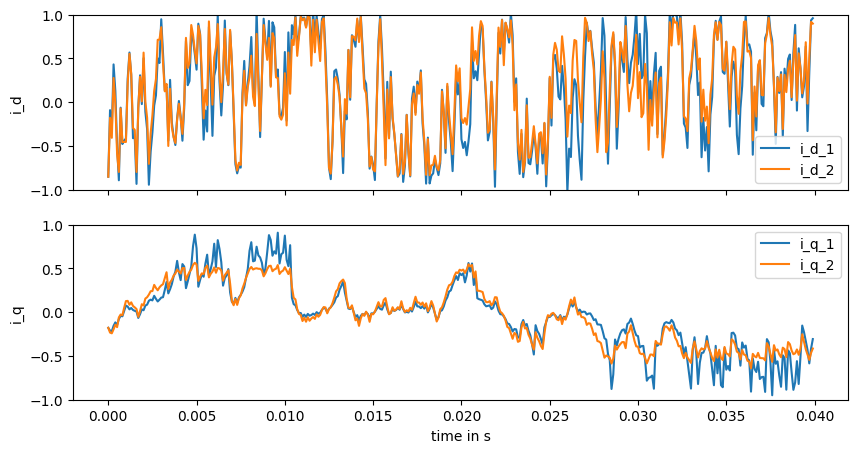

 52%|███████████████████████████████████████████████████████████████████████████████████▋                                                                             | 51994/100000 [10:52<09:37, 83.11it/s]

Current val_loss: 0.024303582


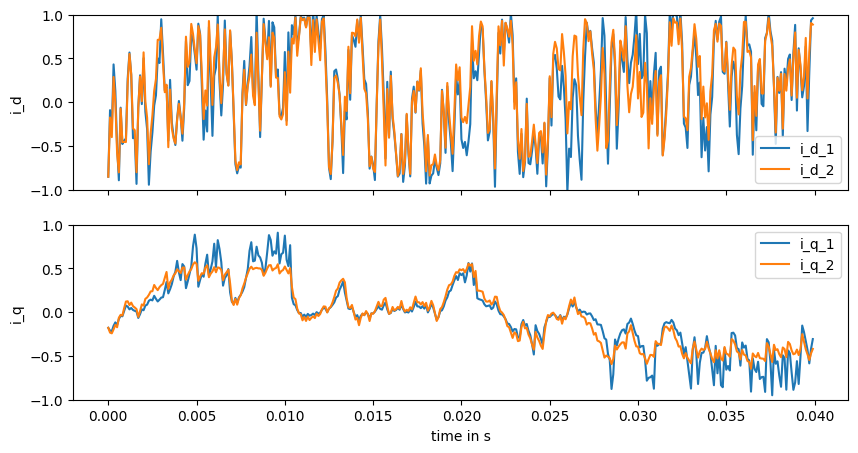

 54%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 53992/100000 [11:17<09:15, 82.90it/s]

Current val_loss: 0.01912589


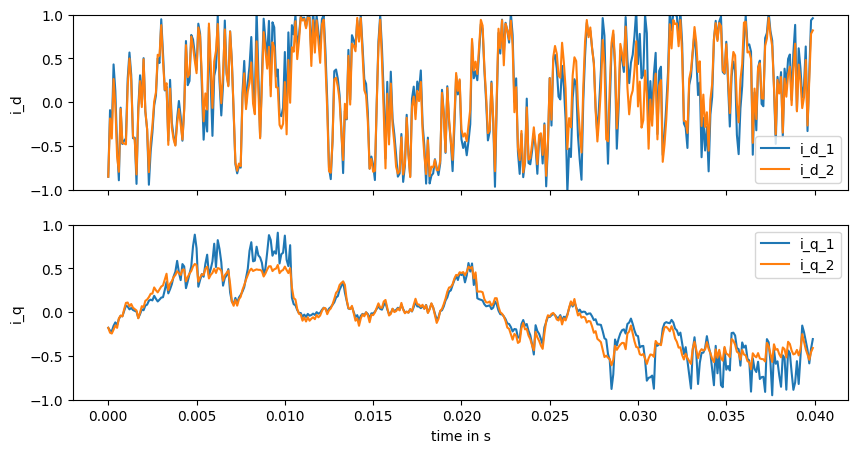

 56%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 55997/100000 [11:41<08:50, 82.98it/s]

Current val_loss: 0.01978747


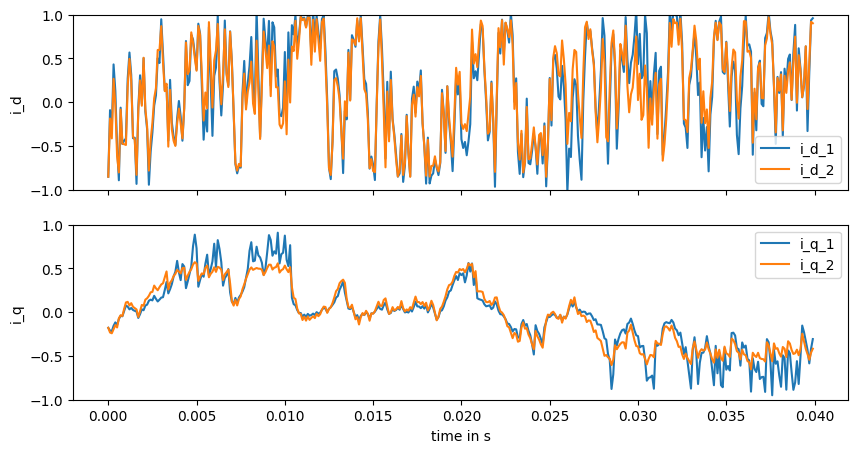

 58%|█████████████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 57995/100000 [12:06<08:25, 83.03it/s]

Current val_loss: 0.021765517


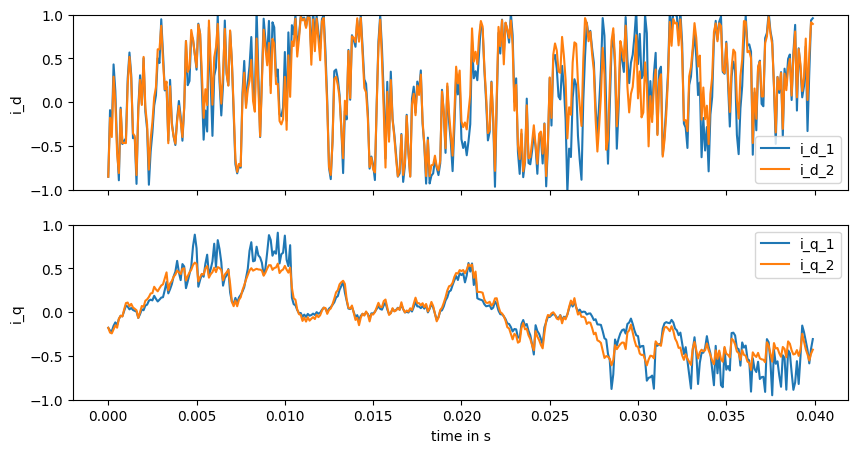

 60%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 59993/100000 [12:31<07:58, 83.66it/s]

Current val_loss: 0.021424908


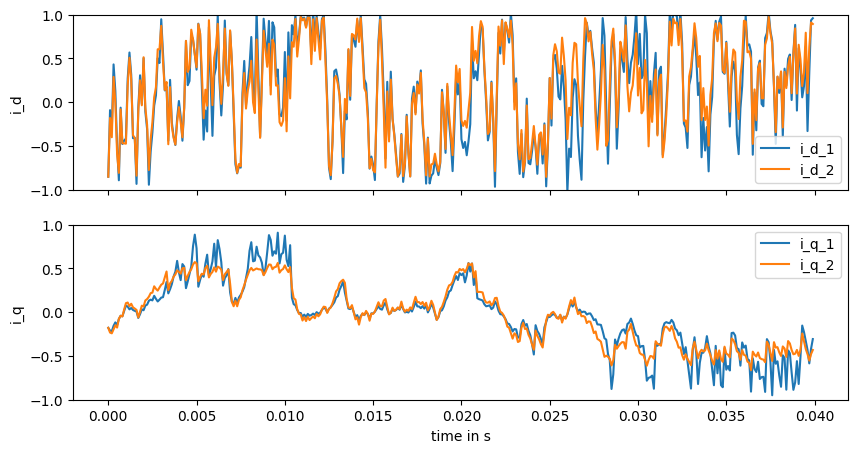

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 62000/100000 [12:55<07:35, 83.36it/s]

Current val_loss: 0.021342294


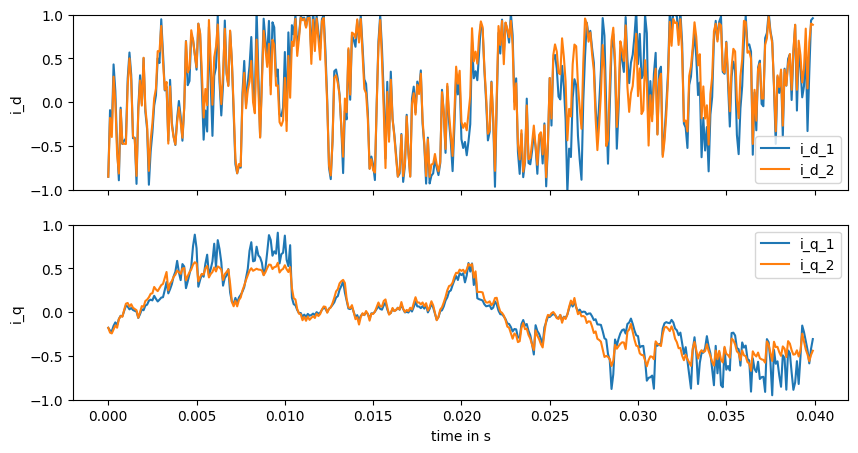

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 63998/100000 [13:20<07:10, 83.63it/s]

Current val_loss: 0.01818126


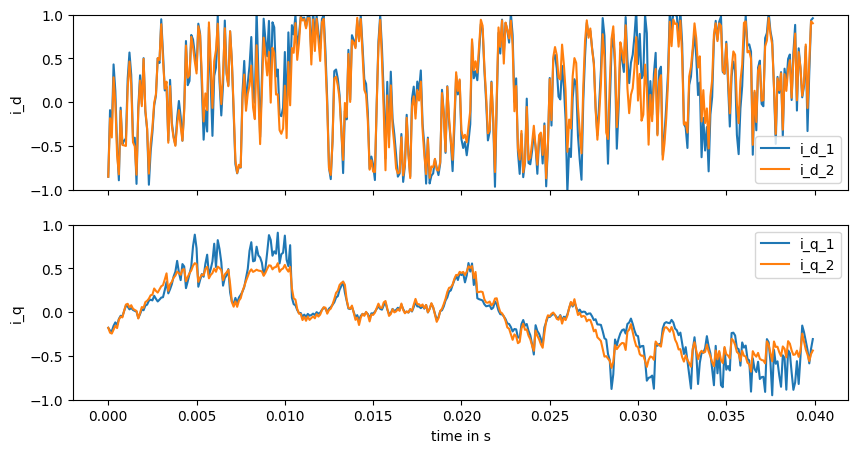

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 65995/100000 [13:44<06:46, 83.55it/s]

Current val_loss: 0.021375112


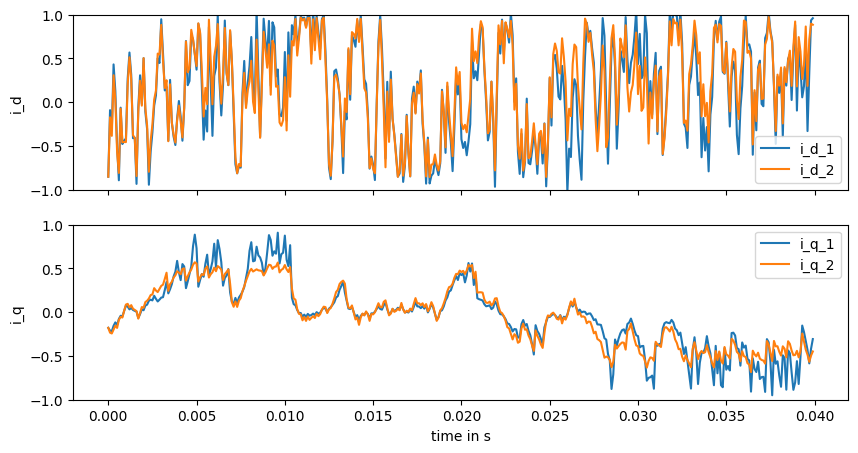

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 67993/100000 [14:09<06:25, 82.93it/s]

Current val_loss: 0.017364722


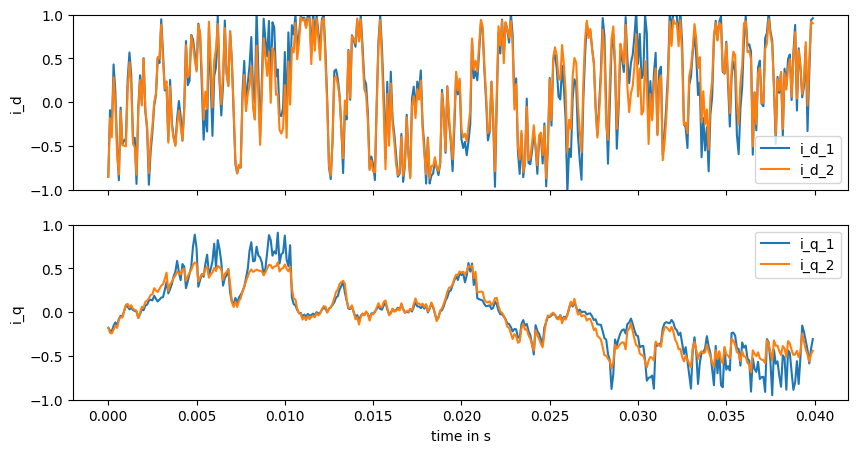

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 70000/100000 [14:33<06:01, 82.95it/s]

Current val_loss: 0.018194988


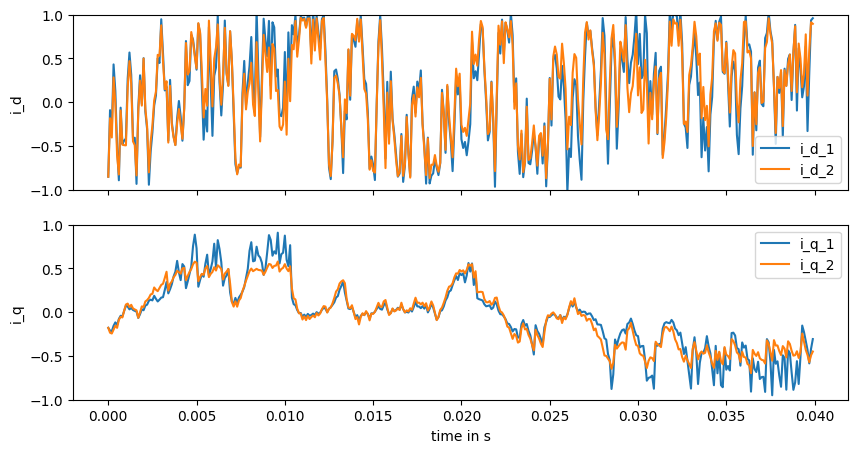

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 71998/100000 [14:58<05:35, 83.39it/s]

Current val_loss: 0.018440908


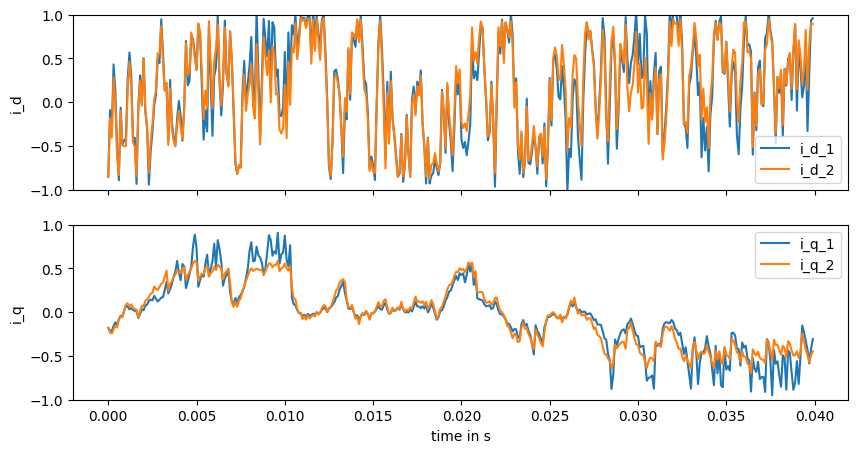

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 73996/100000 [15:22<05:10, 83.66it/s]

Current val_loss: 0.020017667


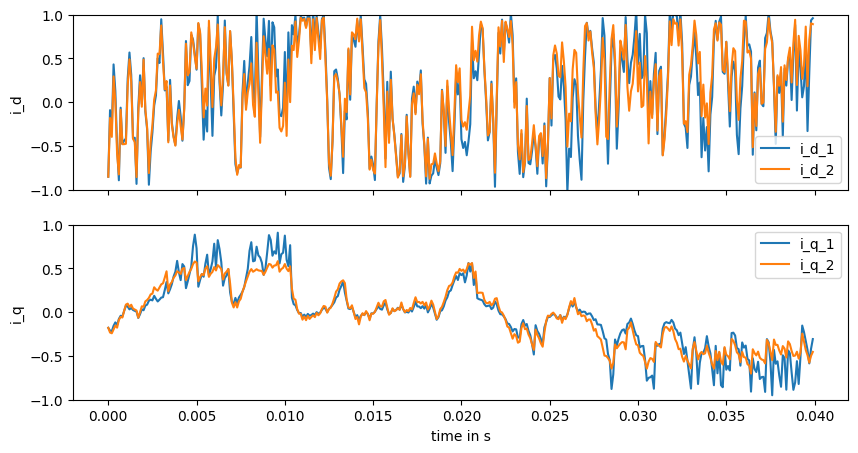

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 75994/100000 [15:46<04:47, 83.62it/s]

Current val_loss: 0.02009442


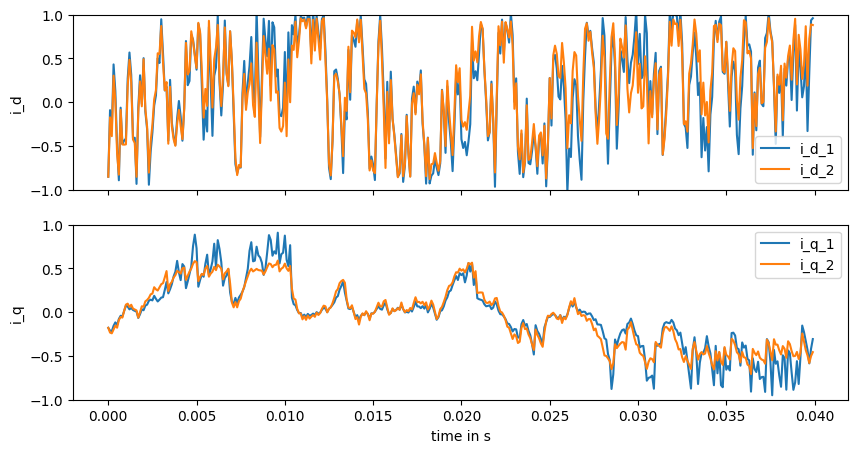

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 77992/100000 [16:11<04:23, 83.46it/s]

Current val_loss: 0.018264484


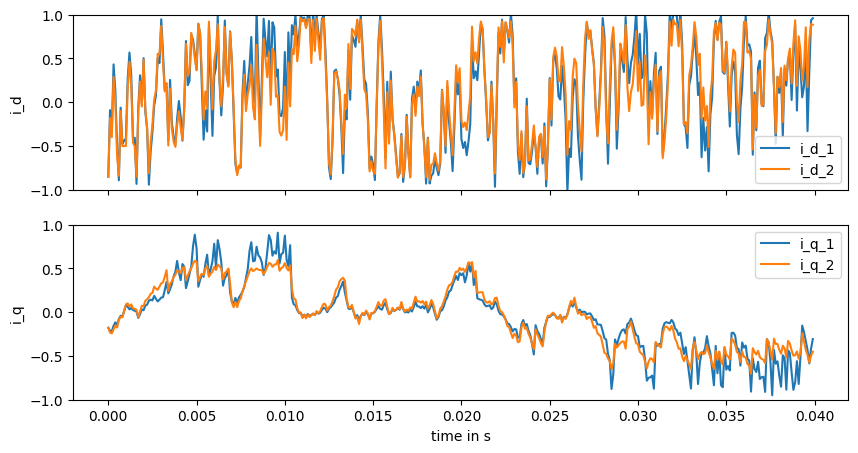

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 79999/100000 [16:36<04:02, 82.36it/s]

Current val_loss: 0.017739108


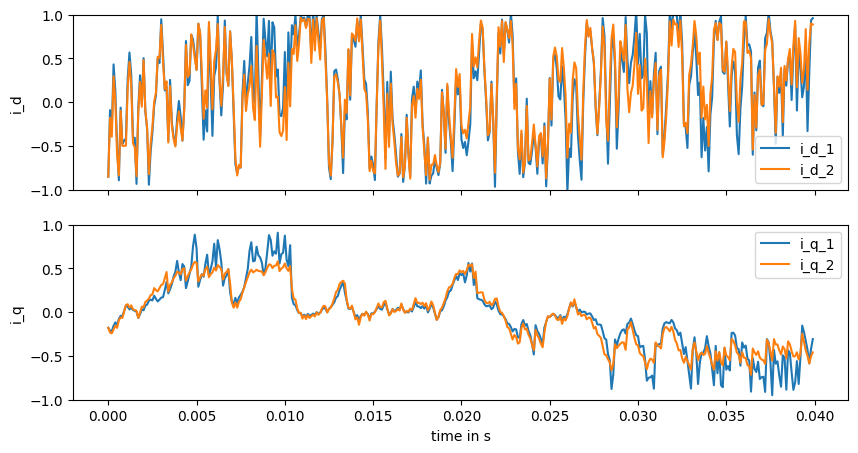

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 81997/100000 [17:00<03:36, 83.28it/s]

Current val_loss: 0.017717041


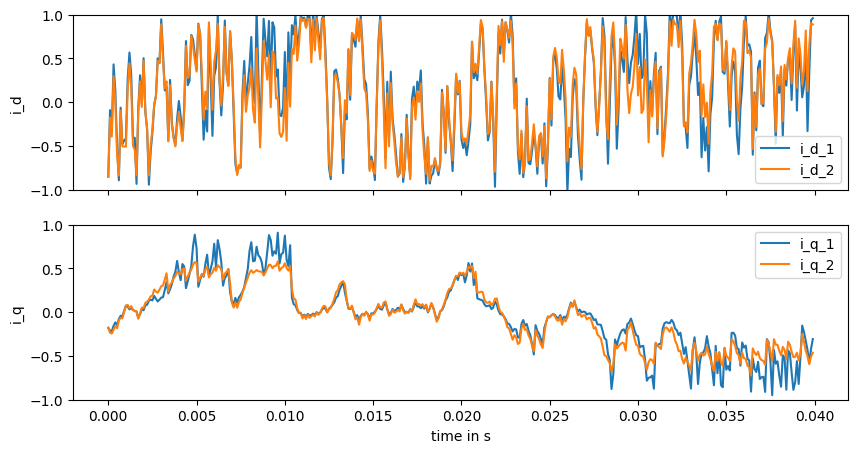

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 83995/100000 [17:24<03:10, 83.82it/s]

Current val_loss: 0.022005398


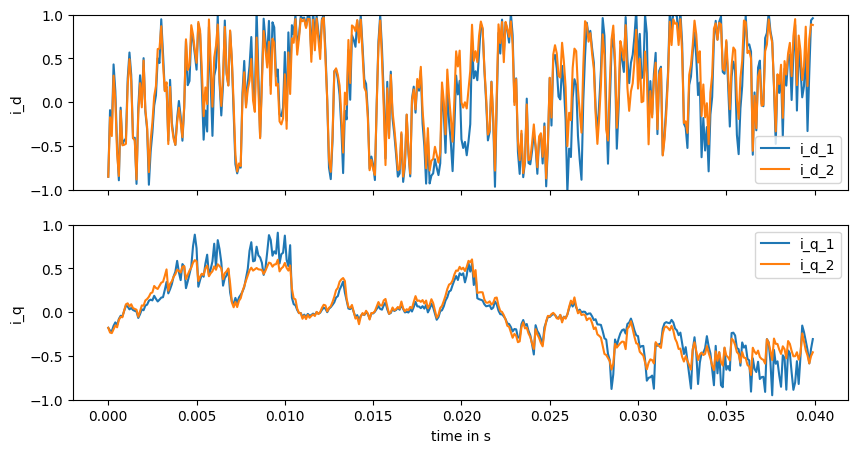

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 85993/100000 [17:49<02:48, 83.30it/s]

Current val_loss: 0.018102622


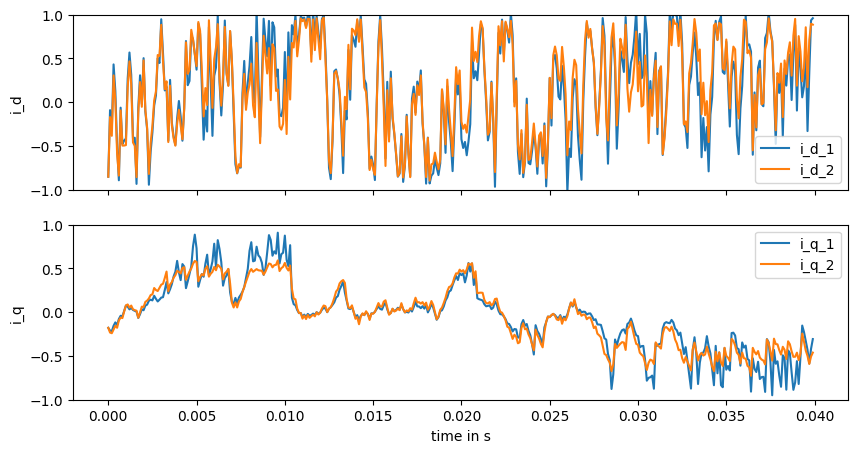

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 88000/100000 [18:14<02:24, 83.14it/s]

Current val_loss: 0.01691794


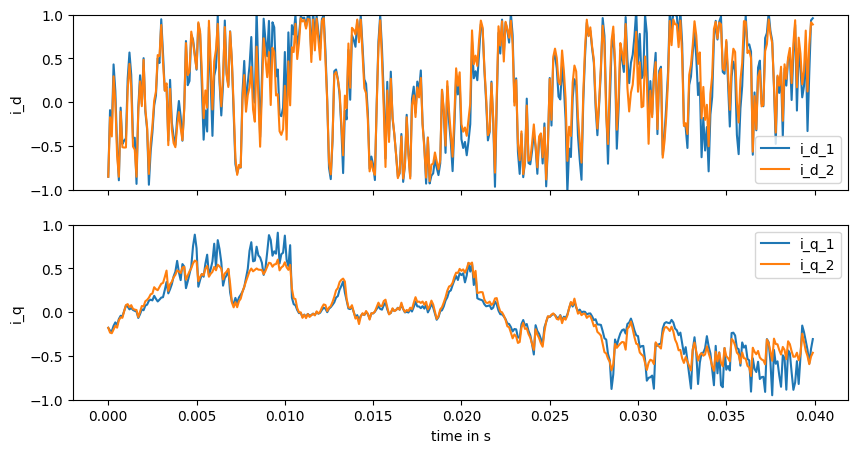

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 89995/100000 [18:41<01:59, 83.42it/s]

Current val_loss: 0.016739486


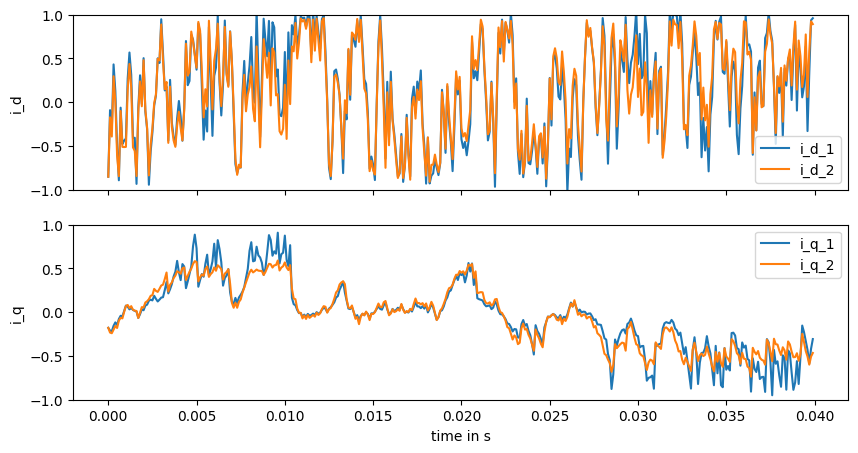

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 91993/100000 [19:05<01:36, 83.13it/s]

Current val_loss: 0.017296651


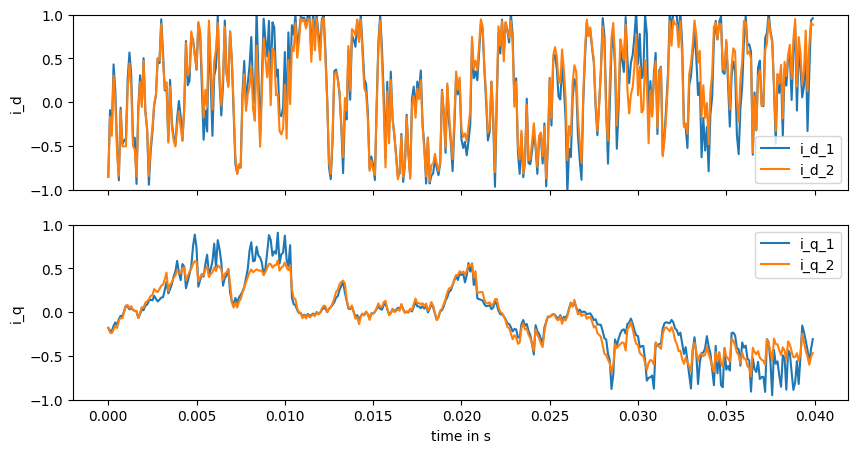

 94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 94000/100000 [19:29<01:12, 83.01it/s]

Current val_loss: 0.017793298


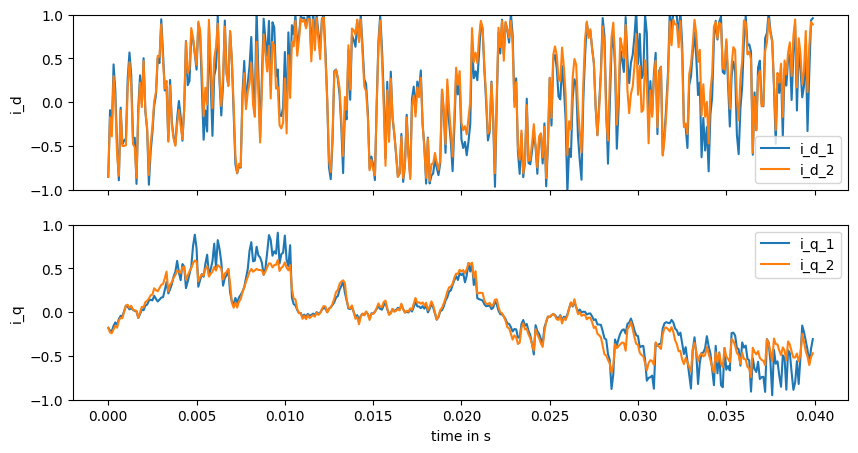

 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 95998/100000 [19:54<00:48, 82.41it/s]

Current val_loss: 0.021426616


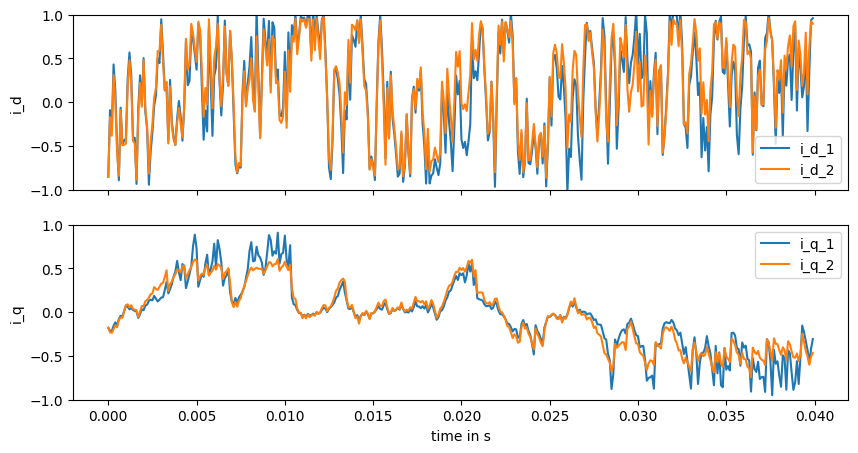

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 97996/100000 [20:18<00:24, 83.18it/s]

Current val_loss: 0.019139105


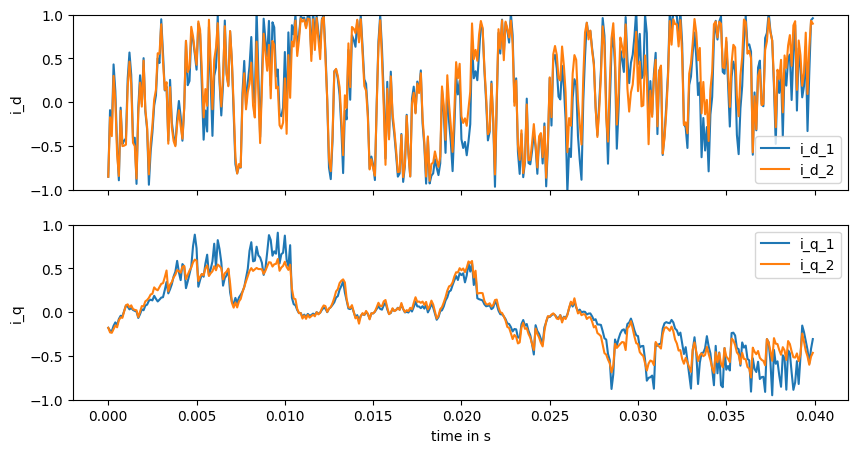

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 100000/100000 [20:43<00:00, 80.43it/s]


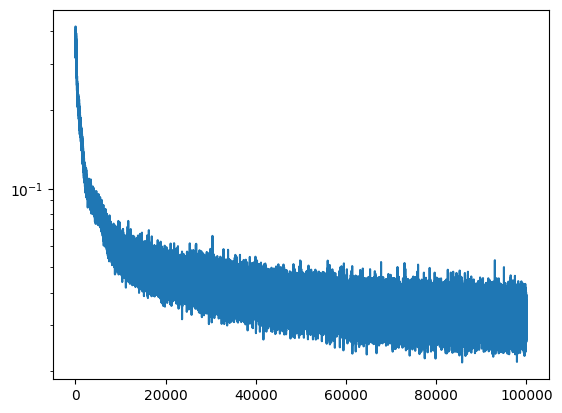

In [ ]:
fin_node50,fin_opt_state,fin_keys,losses, val_losses=mtrainer.fit_non_jit(node,opt_state,keys,plot_every=2000)
plt.plot(losses)
plt.yscale('log')


In [12]:
eqx.tree_serialise_leaves("trained_models/DMPE_Model_100k_50len_100b_step0_0001.eqx", fin_node50)

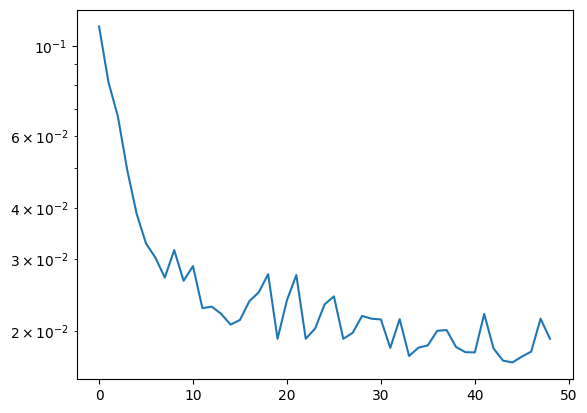

In [13]:
plt.plot(val_losses)
plt.yscale('log')

In [17]:
batch_size=100
mtrainer=ModelTrainer(
    train_steps=200_000,
    batch_size=batch_size,
    sequence_len=1,
    featurize=featurize_node,
    train_data_gen_sin=data_gen_single,
    val_data_gen_sin= val_data_gen_single,
    model_optimizer=optimizer_node,
    tau= 1e-4
    )
keys=jax.vmap(jax.random.PRNGKey)(np.random.randint(0, 2**31, size=(batch_size,)))

  1%|█▌                                                                                                                                                               | 1973/200000 [00:03<05:12, 632.75it/s]

Current val_loss: 4667246000.0


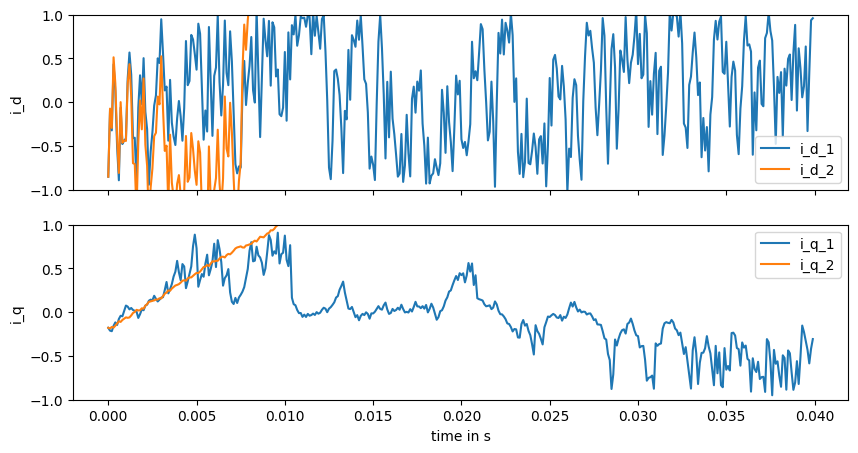

  2%|███▏                                                                                                                                                             | 3959/200000 [00:07<05:25, 602.16it/s]

Current val_loss: 1864.4148


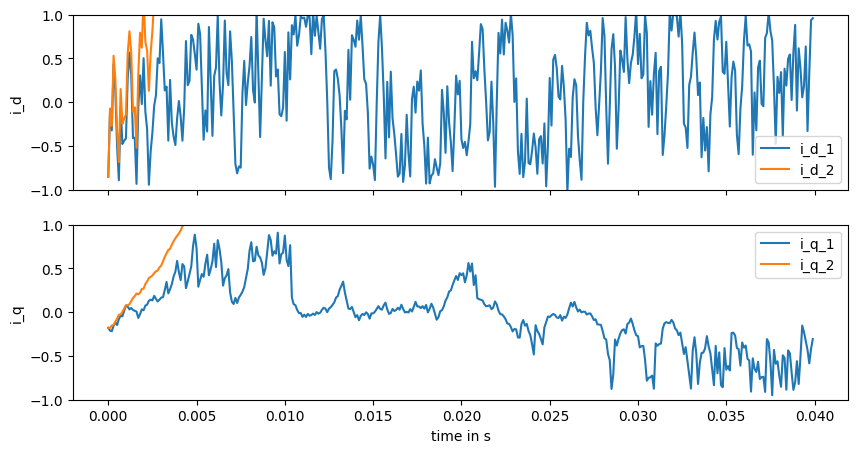

  3%|████▊                                                                                                                                                            | 5982/200000 [00:10<05:16, 612.29it/s]

Current val_loss: 7836.947


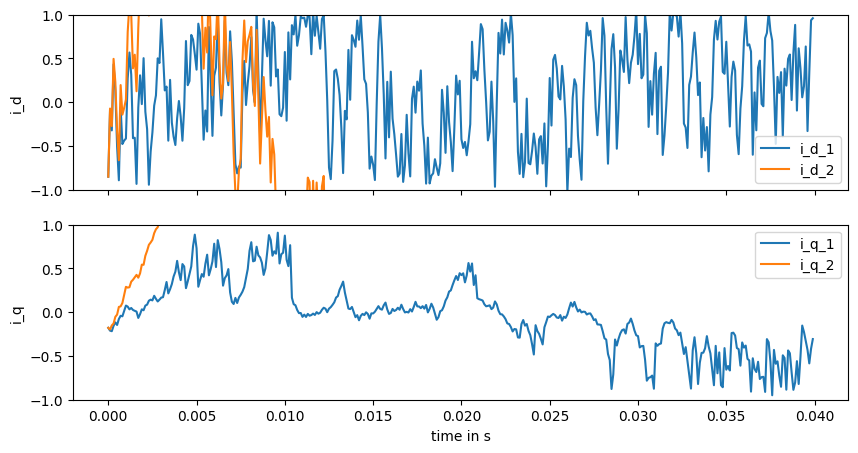

  4%|██████▍                                                                                                                                                          | 7950/200000 [00:14<05:30, 581.25it/s]

Current val_loss: 50311010.0


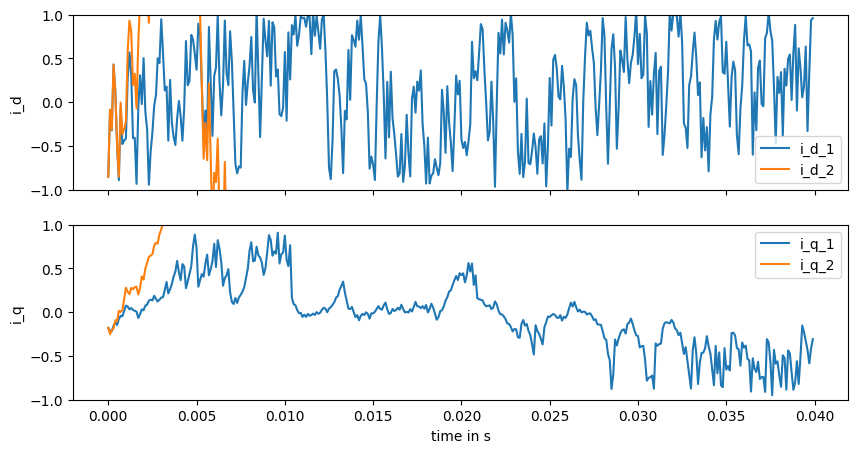

  5%|████████                                                                                                                                                         | 9948/200000 [00:18<04:43, 670.44it/s]

Current val_loss: 70185400000.0


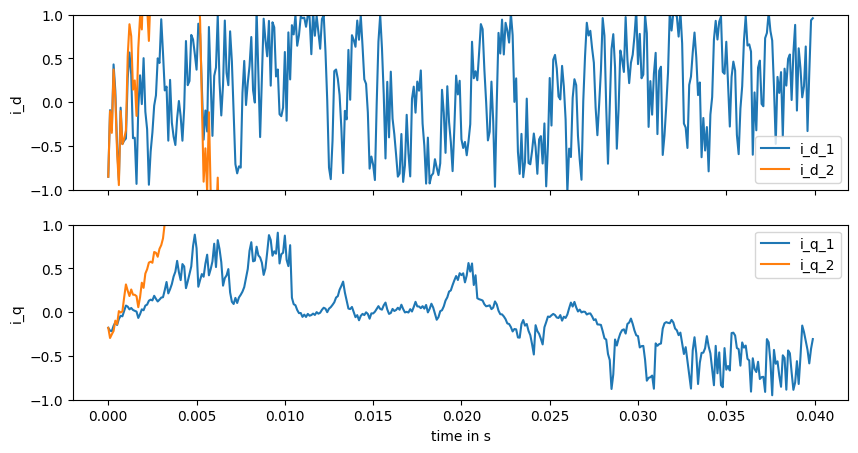

  6%|█████████▌                                                                                                                                                      | 11982/200000 [00:21<04:39, 672.05it/s]

Current val_loss: inf


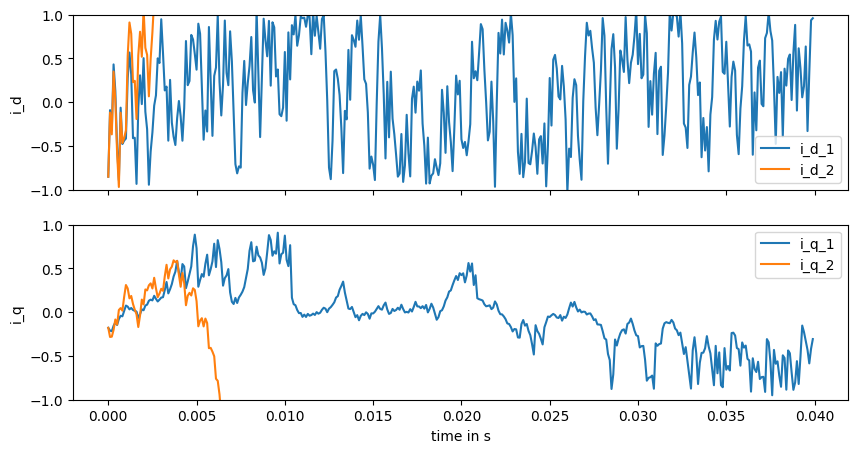

  7%|███████████▏                                                                                                                                                    | 13965/200000 [00:25<04:46, 650.08it/s]

Current val_loss: inf


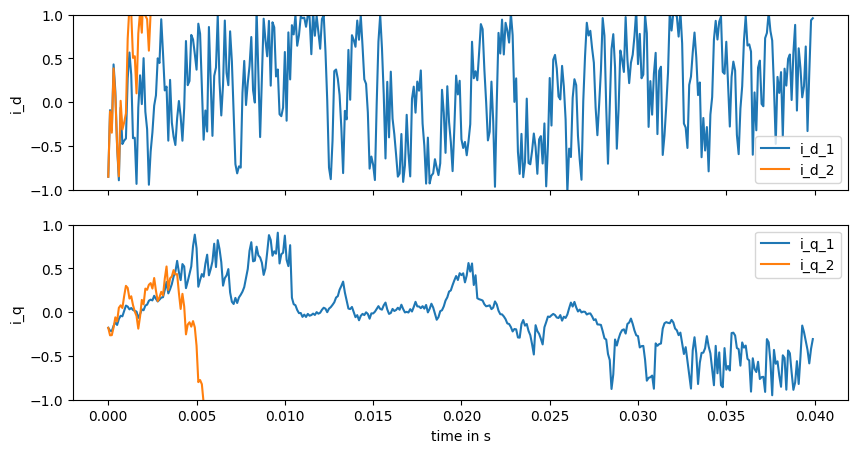

  8%|████████████▊                                                                                                                                                   | 15959/200000 [00:29<05:21, 572.76it/s]

Current val_loss: inf


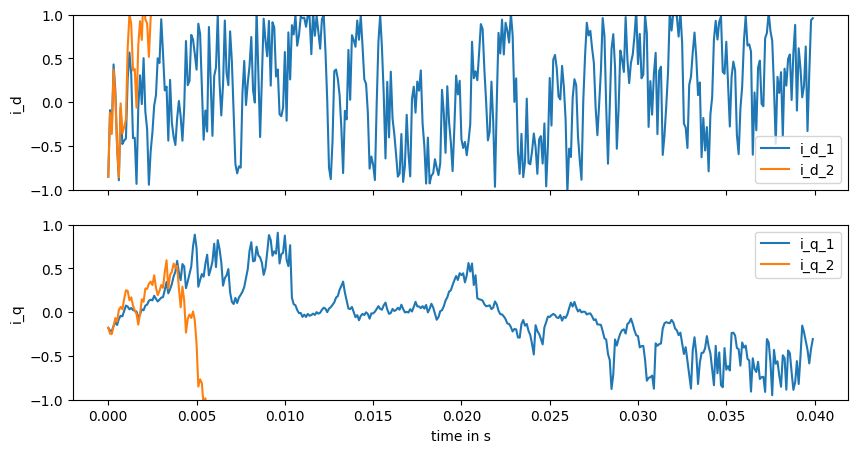

  9%|██████████████▎                                                                                                                                                 | 17932/200000 [00:33<05:13, 580.60it/s]

Current val_loss: inf


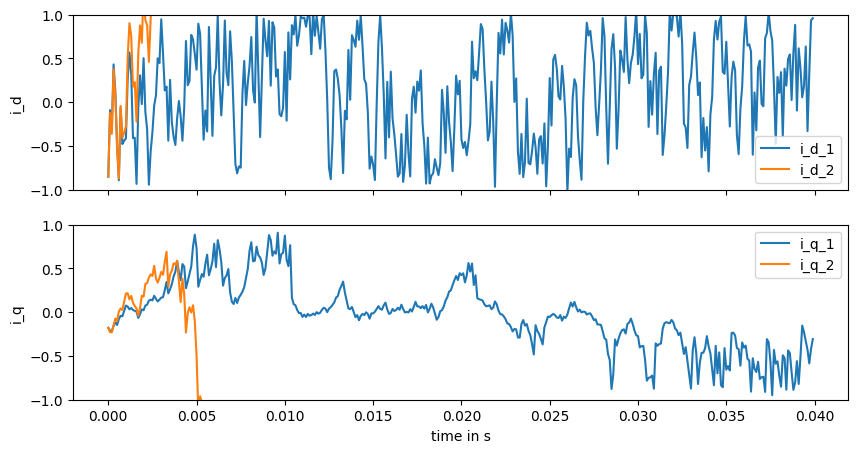

 10%|███████████████▉                                                                                                                                                | 19942/200000 [00:36<04:31, 662.68it/s]

Current val_loss: 3.6778923e+19


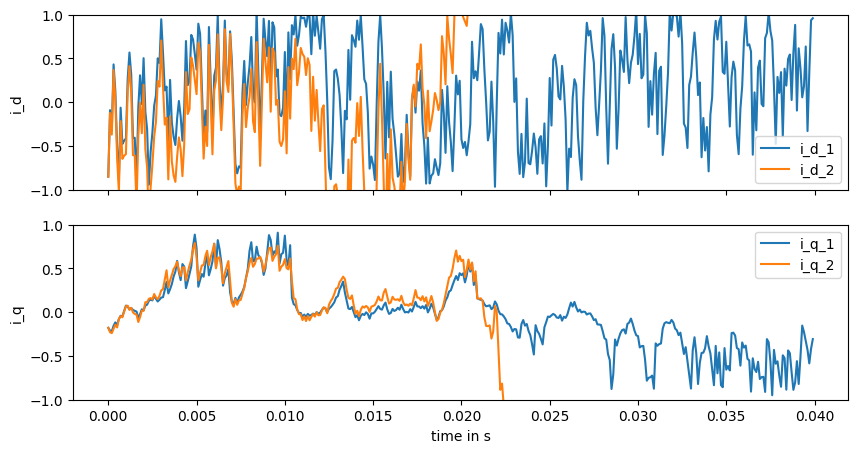

 11%|█████████████████▌                                                                                                                                              | 21968/200000 [00:40<04:25, 670.37it/s]

Current val_loss: 1.6722676e+18


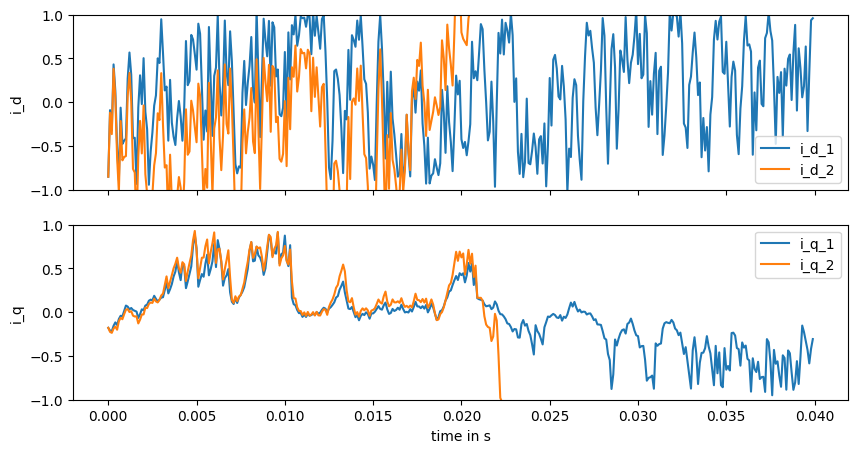

 12%|███████████████████▏                                                                                                                                            | 23967/200000 [00:44<04:16, 686.72it/s]

Current val_loss: 0.413415


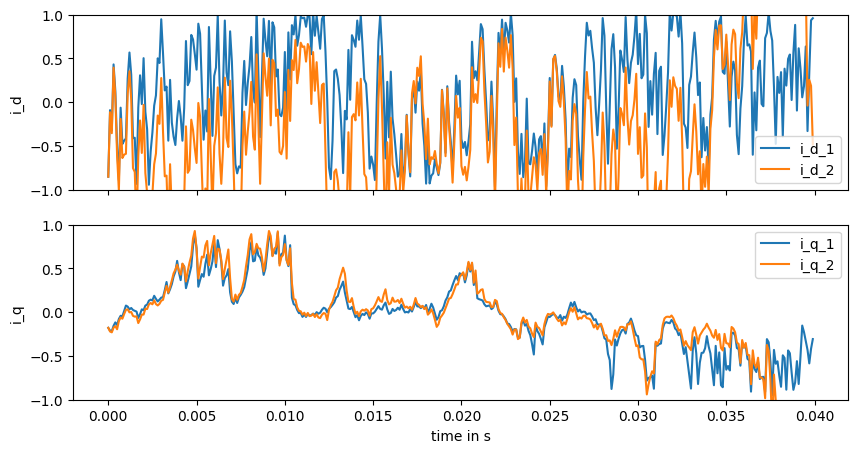

 13%|████████████████████▊                                                                                                                                           | 25961/200000 [00:48<04:16, 678.87it/s]

Current val_loss: 0.42554754


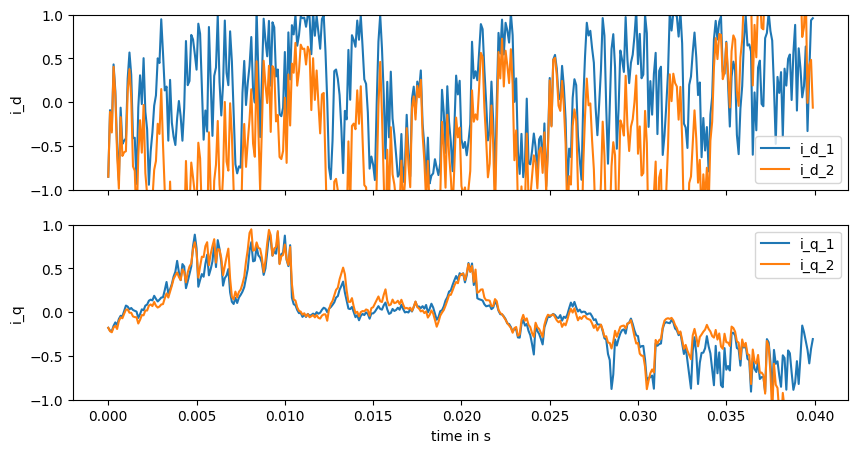

 14%|██████████████████████▎                                                                                                                                         | 27941/200000 [00:51<04:15, 673.52it/s]

Current val_loss: 0.3914275


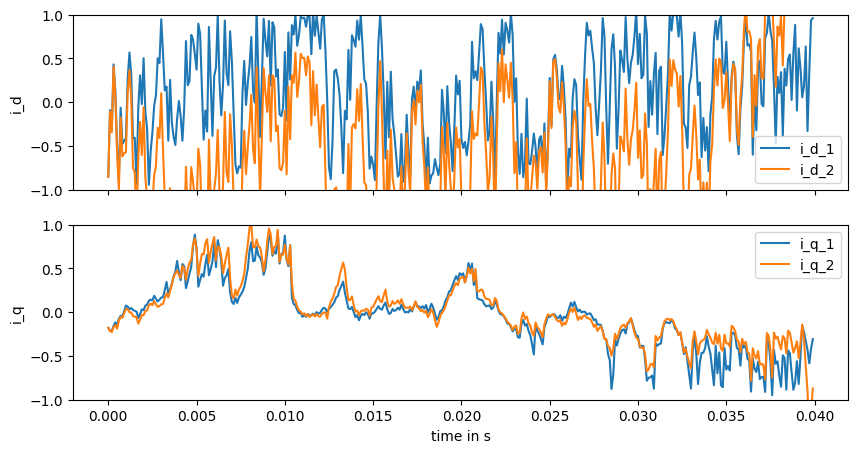

 15%|███████████████████████▉                                                                                                                                        | 29966/200000 [00:54<04:33, 621.87it/s]

Current val_loss: 0.36532593


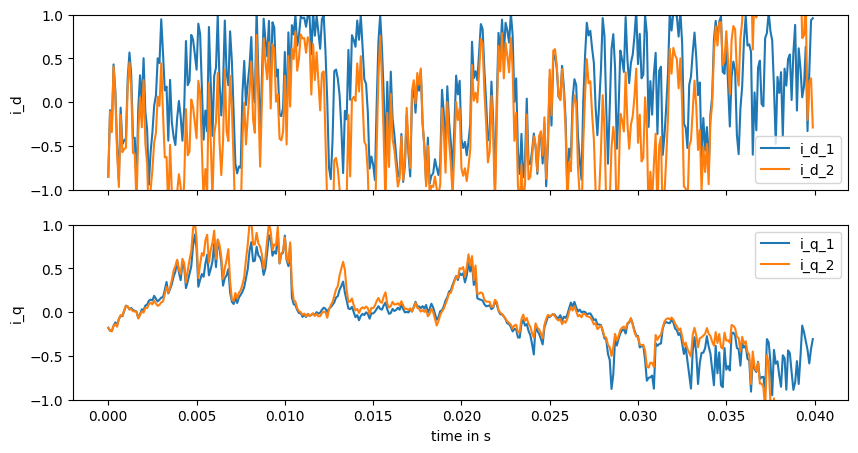

 16%|█████████████████████████▌                                                                                                                                      | 31937/200000 [00:58<04:05, 685.01it/s]

Current val_loss: 0.49564627


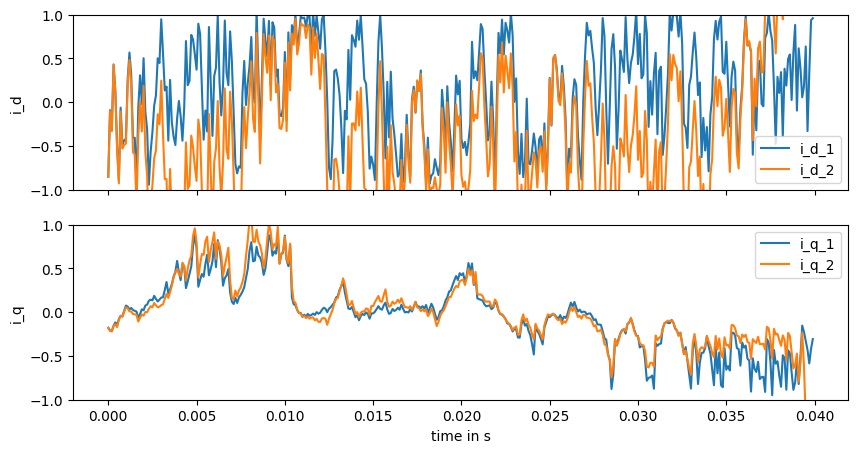

 17%|███████████████████████████▏                                                                                                                                    | 33956/200000 [01:01<04:05, 676.19it/s]

Current val_loss: 0.4301663


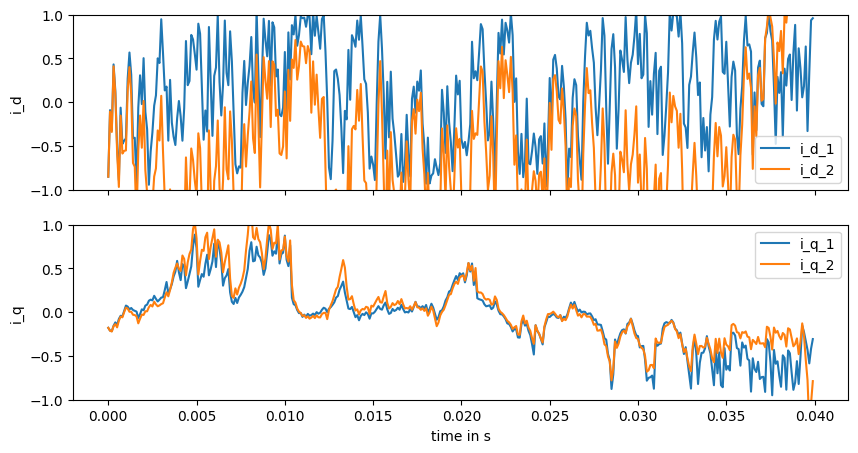

 18%|████████████████████████████▊                                                                                                                                   | 35962/200000 [01:05<04:08, 659.24it/s]

Current val_loss: 0.21644497


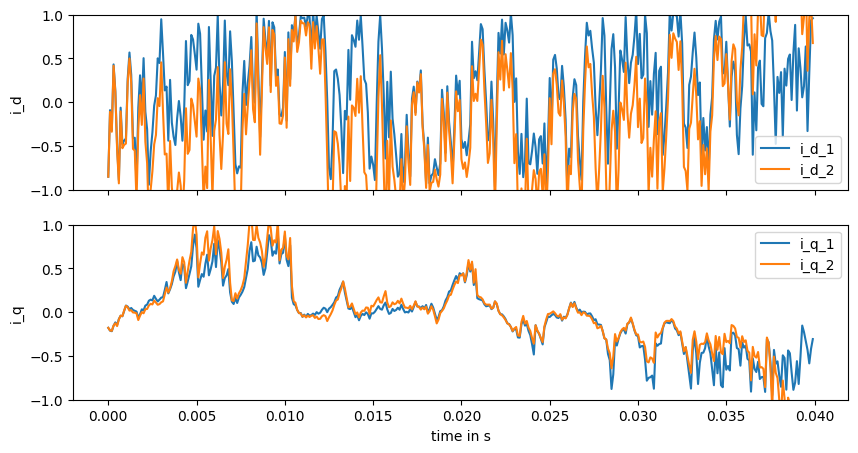

 19%|██████████████████████████████▍                                                                                                                                 | 37987/200000 [01:09<04:42, 573.15it/s]

Current val_loss: 0.1946785


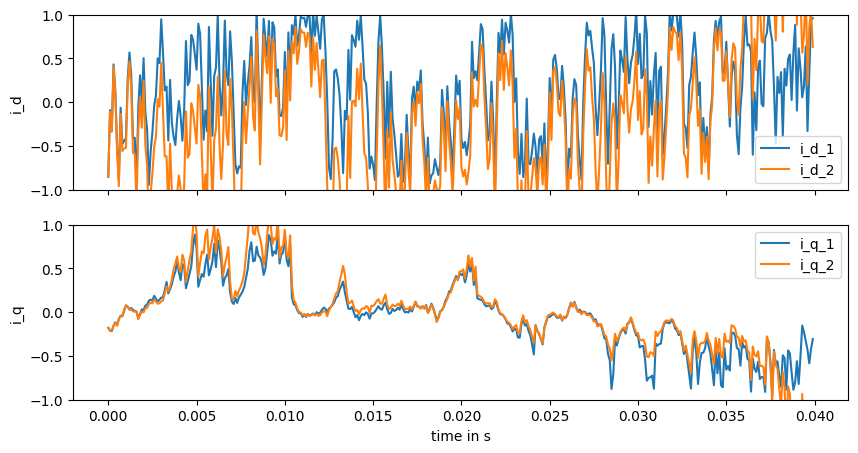

 20%|███████████████████████████████▉                                                                                                                                | 39980/200000 [01:13<04:33, 584.68it/s]

Current val_loss: 1516952700000000.0


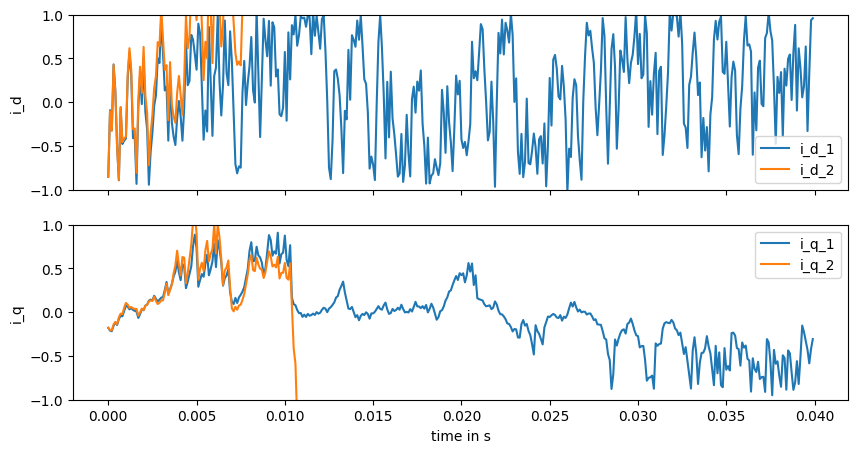

 21%|█████████████████████████████████▌                                                                                                                              | 41932/200000 [01:16<03:51, 681.55it/s]

Current val_loss: 0.16106135


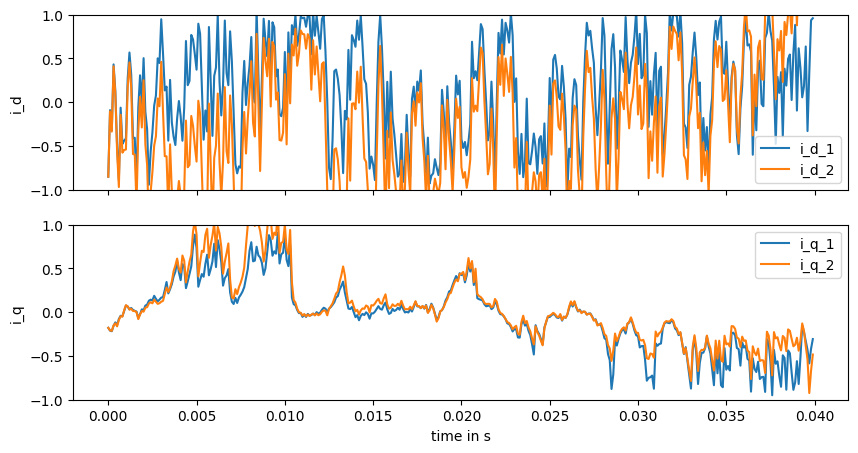

 22%|███████████████████████████████████▏                                                                                                                            | 43935/200000 [01:20<03:47, 685.36it/s]

Current val_loss: 10300354000.0


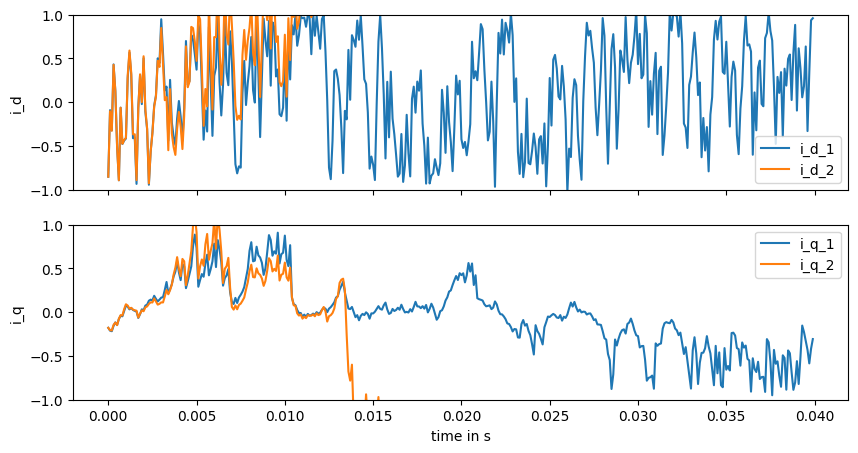

 23%|████████████████████████████████████▊                                                                                                                           | 45970/200000 [01:23<03:48, 674.25it/s]

Current val_loss: 0.31756377


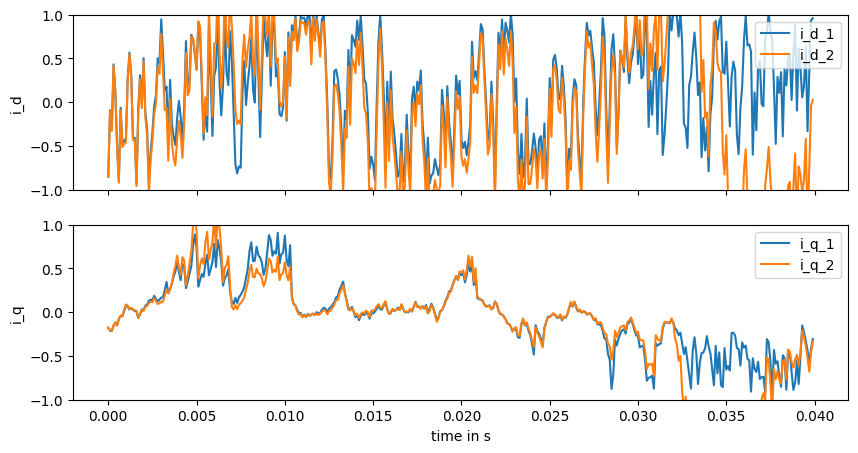

 24%|██████████████████████████████████████▎                                                                                                                         | 47966/200000 [01:27<03:40, 688.78it/s]

Current val_loss: 0.3103121


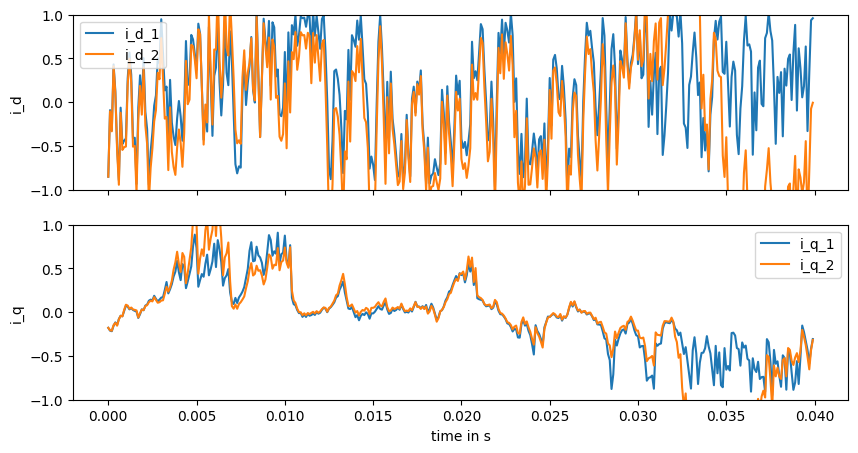

 25%|███████████████████████████████████████▉                                                                                                                        | 49986/200000 [01:30<03:52, 646.44it/s]

Current val_loss: 9043493.0


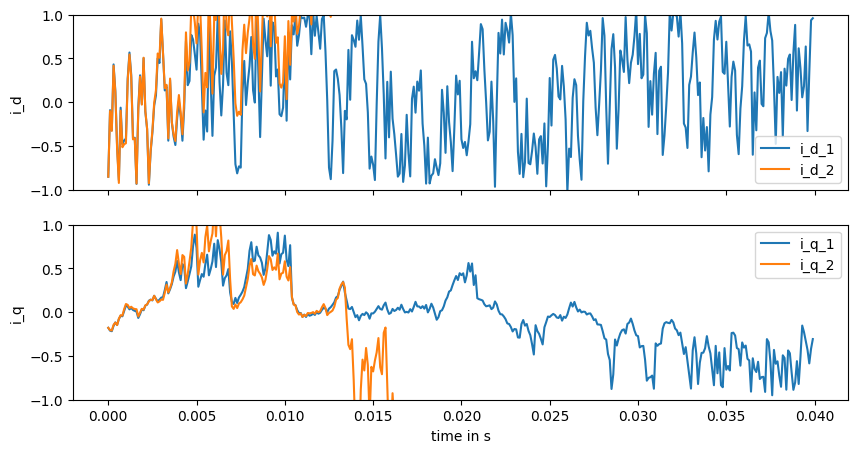

 26%|█████████████████████████████████████████▌                                                                                                                      | 51988/200000 [01:34<03:50, 642.02it/s]

Current val_loss: 0.29603684


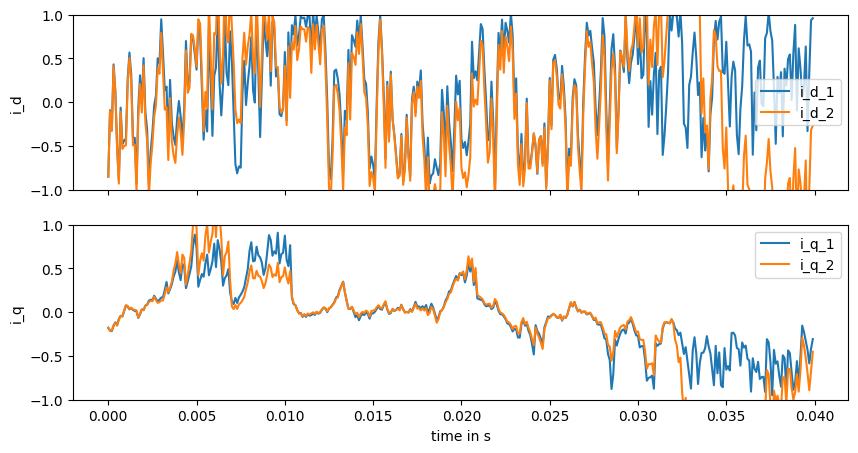

 27%|███████████████████████████████████████████▏                                                                                                                    | 53950/200000 [01:37<03:30, 693.76it/s]

Current val_loss: 0.26560712


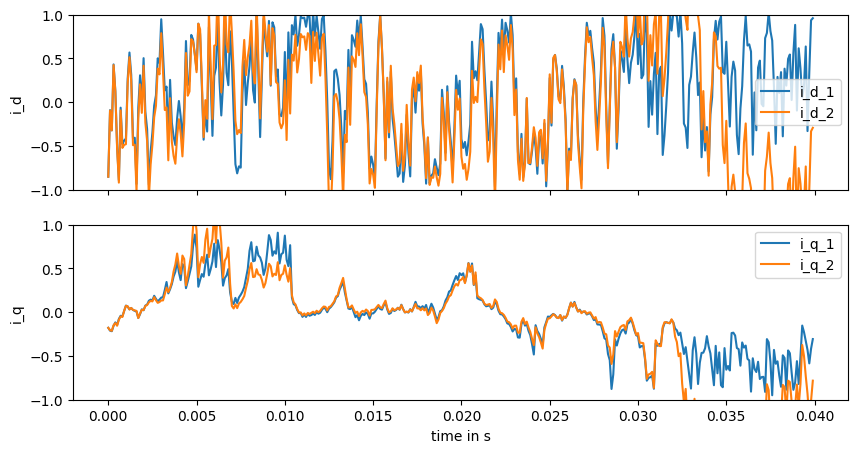

 28%|████████████████████████████████████████████▊                                                                                                                   | 55950/200000 [01:41<04:11, 573.56it/s]

Current val_loss: 0.21469022


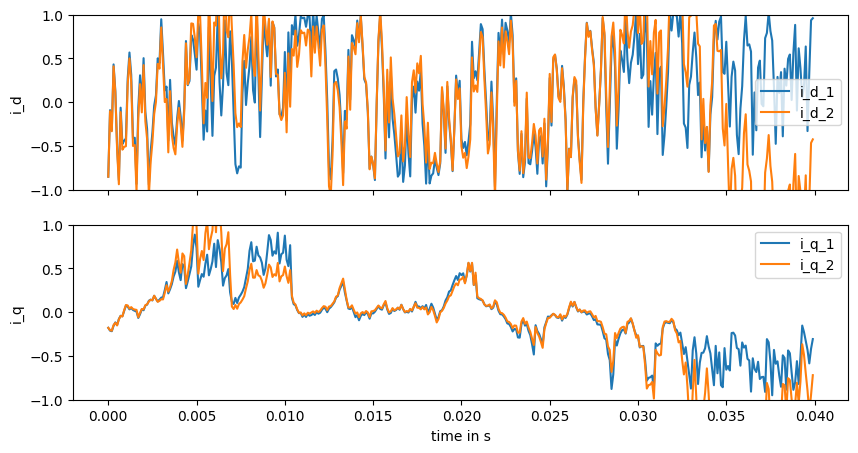

 29%|██████████████████████████████████████████████▎                                                                                                                 | 57948/200000 [01:44<03:27, 686.06it/s]

Current val_loss: 0.31625828


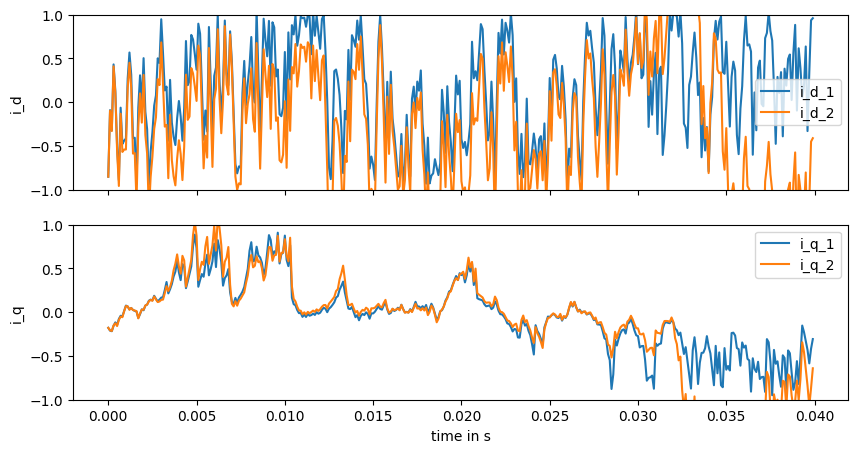

 30%|███████████████████████████████████████████████▉                                                                                                                | 59998/200000 [01:48<03:51, 604.48it/s]

Current val_loss: 1646.7897


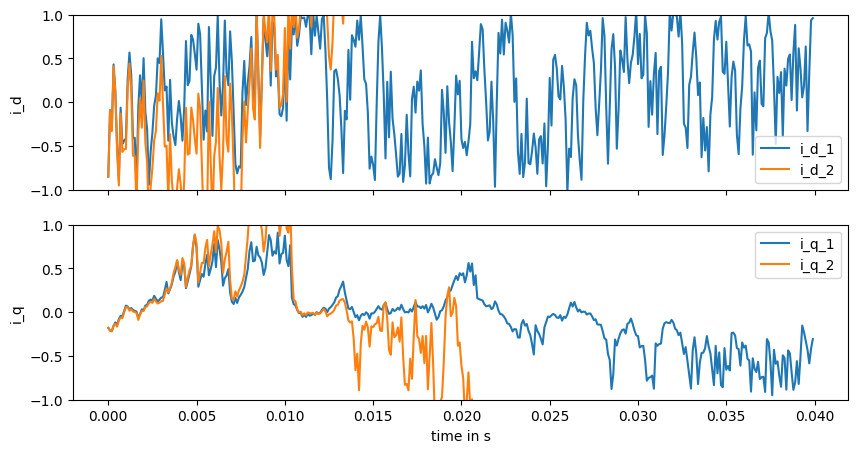

 31%|█████████████████████████████████████████████████▌                                                                                                              | 61989/200000 [01:53<03:51, 597.18it/s]

Current val_loss: 0.20443933


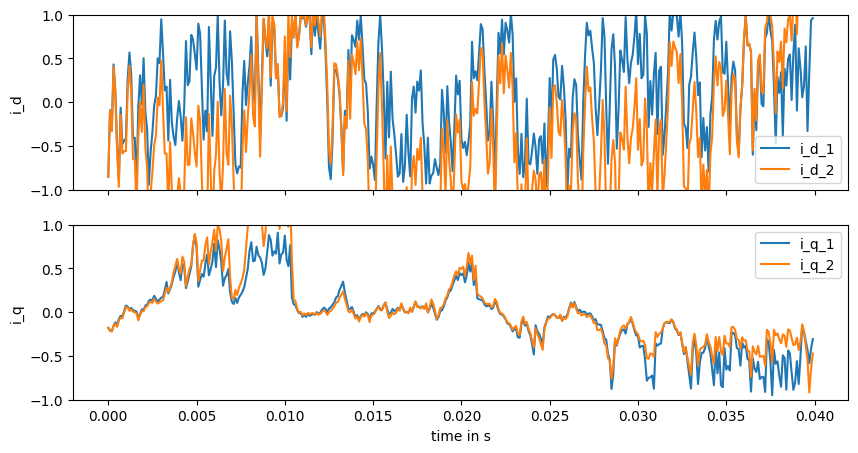

 32%|███████████████████████████████████████████████████▏                                                                                                            | 63934/200000 [01:56<03:28, 654.01it/s]

Current val_loss: 0.24788213


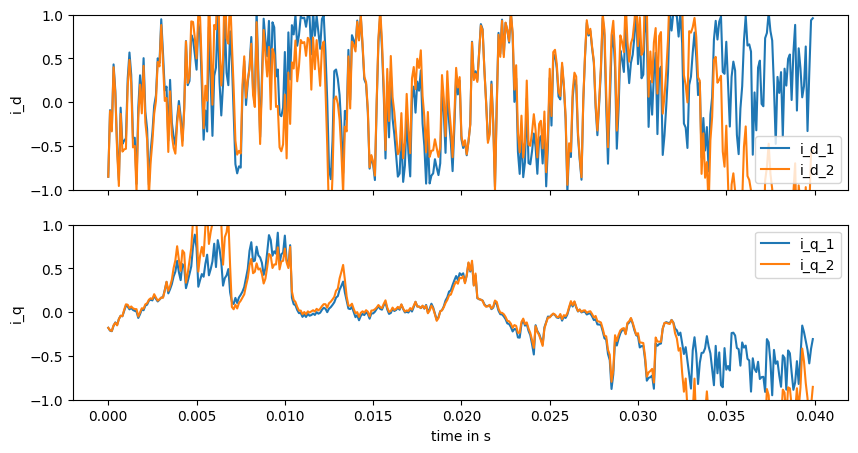

 33%|████████████████████████████████████████████████████▊                                                                                                           | 65956/200000 [02:00<03:15, 684.85it/s]

Current val_loss: 0.33423433


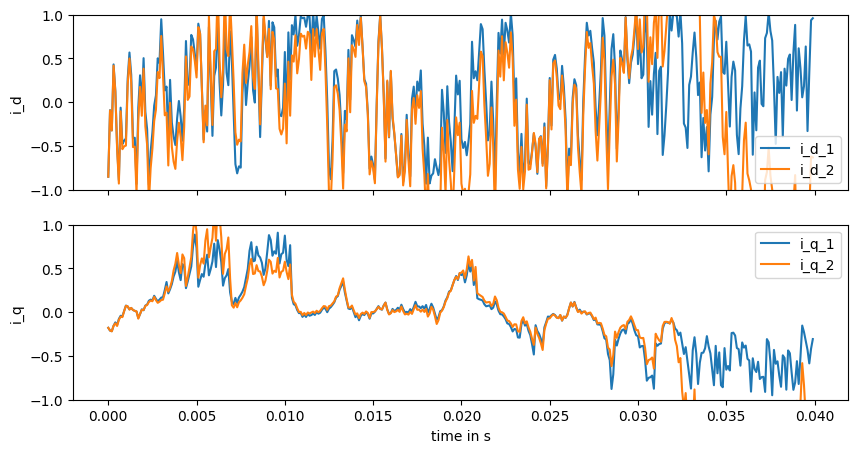

 34%|██████████████████████████████████████████████████████▍                                                                                                         | 67982/200000 [02:03<03:10, 694.18it/s]

Current val_loss: 0.37496594


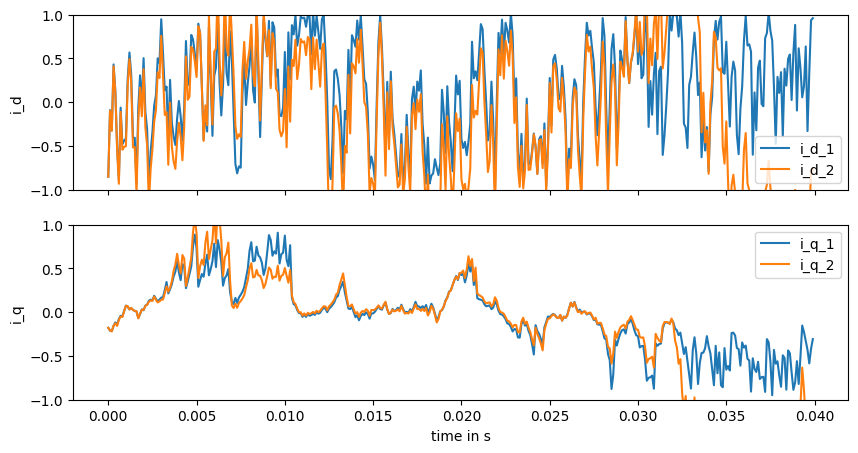

 35%|███████████████████████████████████████████████████████▉                                                                                                        | 69942/200000 [02:06<03:12, 676.86it/s]

Current val_loss: 240.3591


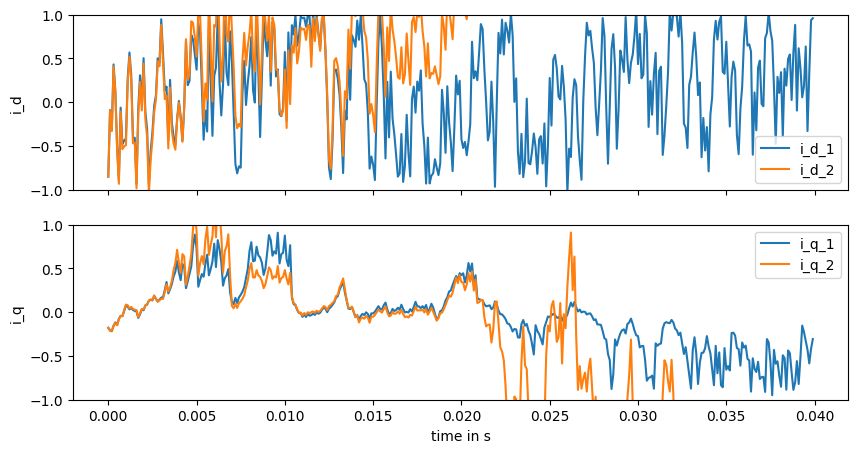

 36%|█████████████████████████████████████████████████████████▌                                                                                                      | 71974/200000 [02:10<03:06, 687.89it/s]

Current val_loss: 0.32714966


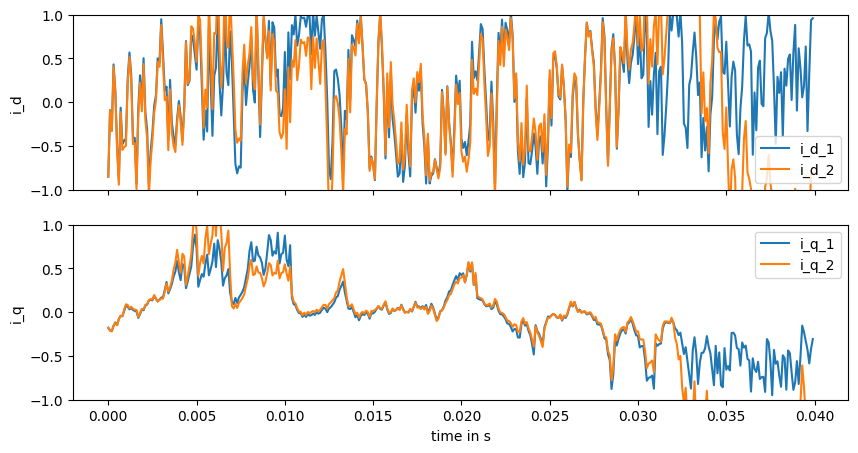

 37%|███████████████████████████████████████████████████████████▏                                                                                                    | 73950/200000 [02:13<03:00, 698.56it/s]

Current val_loss: 195.45831


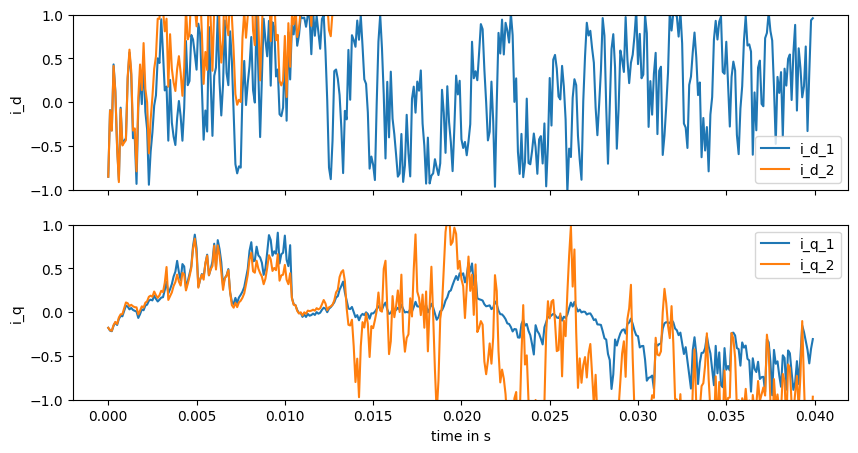

 38%|████████████████████████████████████████████████████████████▊                                                                                                   | 76000/200000 [02:16<02:59, 690.99it/s]

Current val_loss: 0.38264197


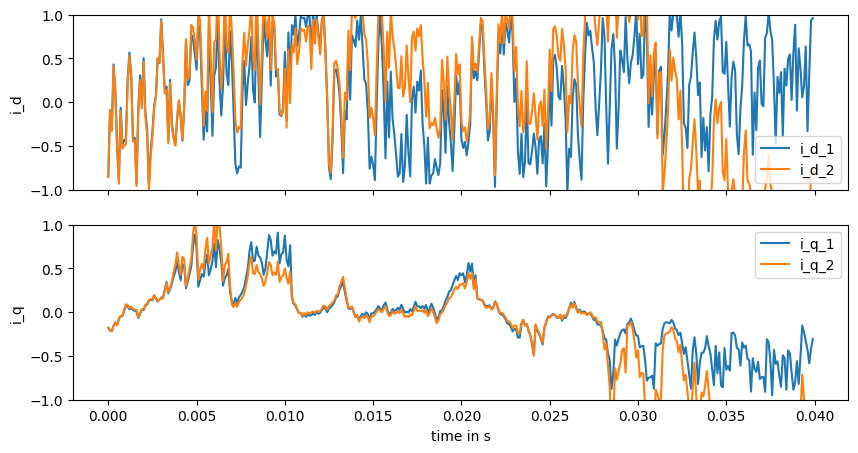

 39%|██████████████████████████████████████████████████████████████▍                                                                                                 | 77977/200000 [02:20<03:02, 668.20it/s]

Current val_loss: 0.12044355


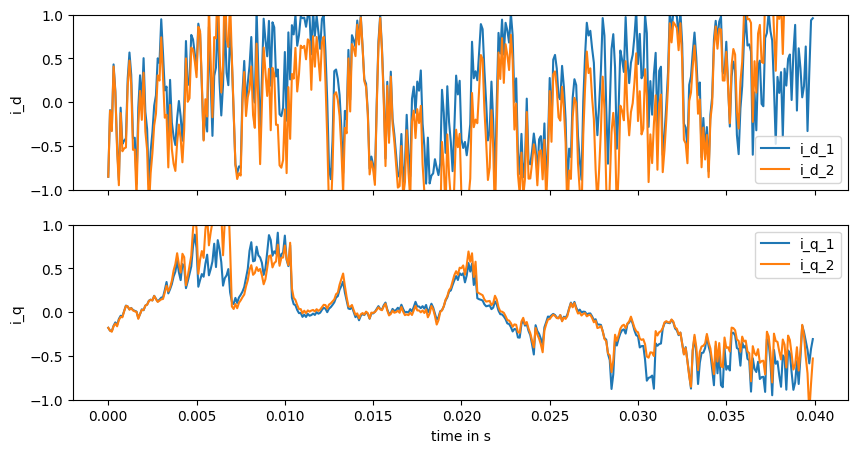

 40%|███████████████████████████████████████████████████████████████▉                                                                                                | 79965/200000 [02:23<03:01, 661.31it/s]

Current val_loss: 0.302564


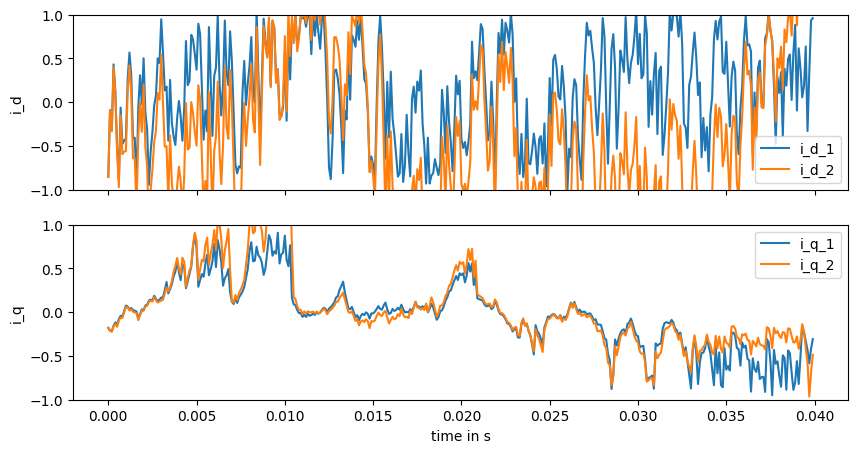

 41%|█████████████████████████████████████████████████████████████████▌                                                                                              | 81973/200000 [02:27<02:58, 661.51it/s]

Current val_loss: 87.741844


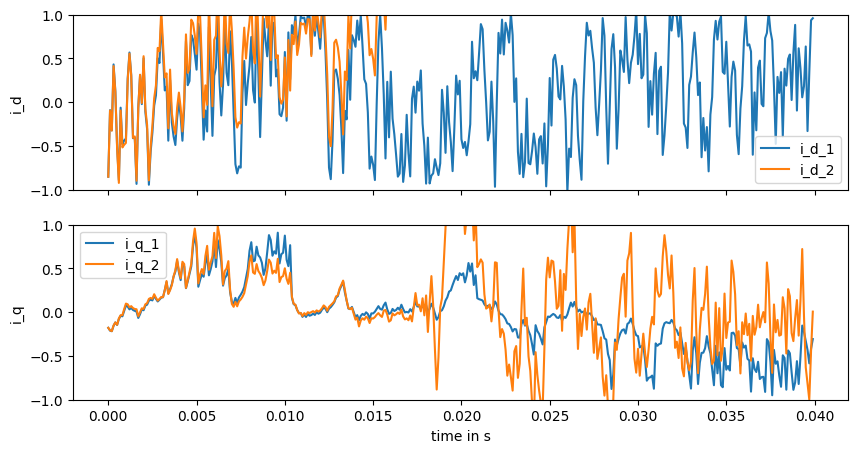

 42%|███████████████████████████████████████████████████████████████████▏                                                                                            | 83983/200000 [02:30<02:54, 663.81it/s]

Current val_loss: 0.8362248


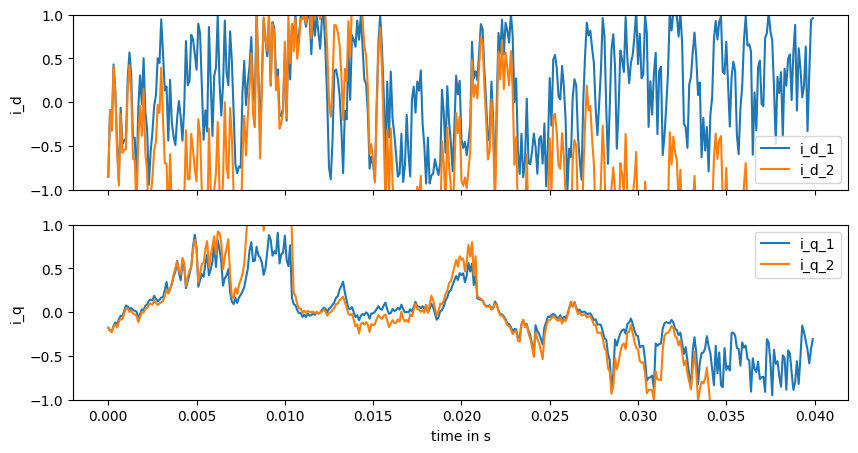

 43%|████████████████████████████████████████████████████████████████████▊                                                                                           | 85943/200000 [02:34<03:09, 600.63it/s]

Current val_loss: 66.84388


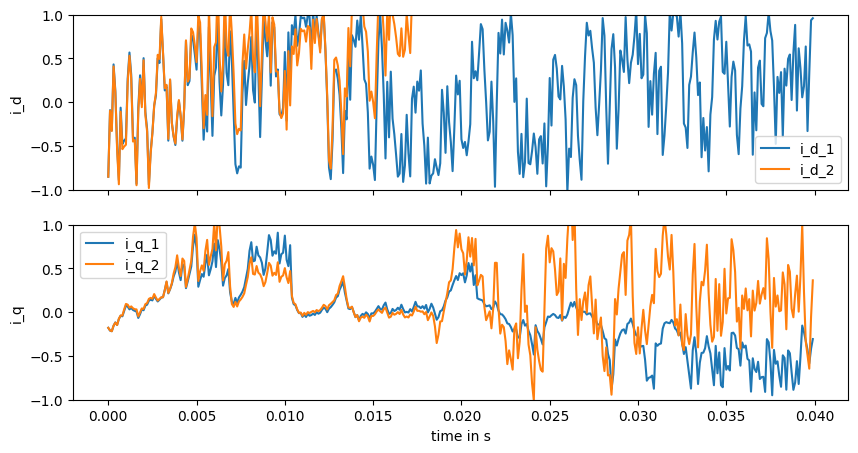

 44%|██████████████████████████████████████████████████████████████████████▎                                                                                         | 87942/200000 [02:37<02:39, 702.19it/s]

Current val_loss: 66.61735


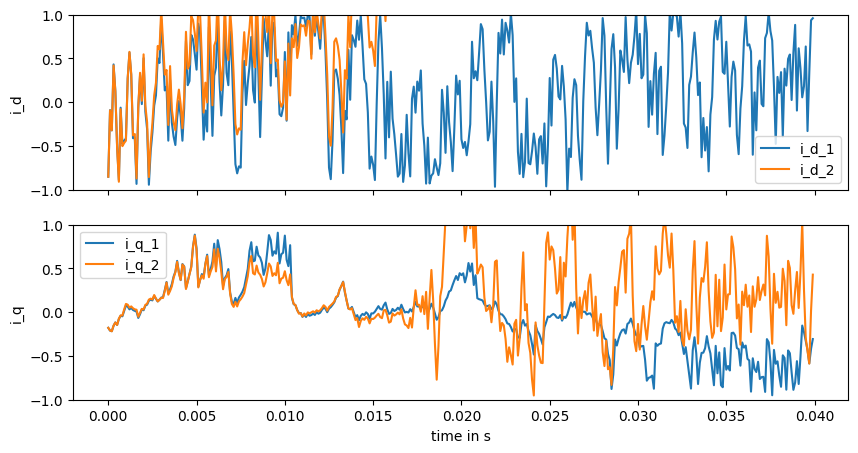

 45%|███████████████████████████████████████████████████████████████████████▉                                                                                        | 89953/200000 [02:40<02:34, 713.65it/s]

Current val_loss: 0.8128763


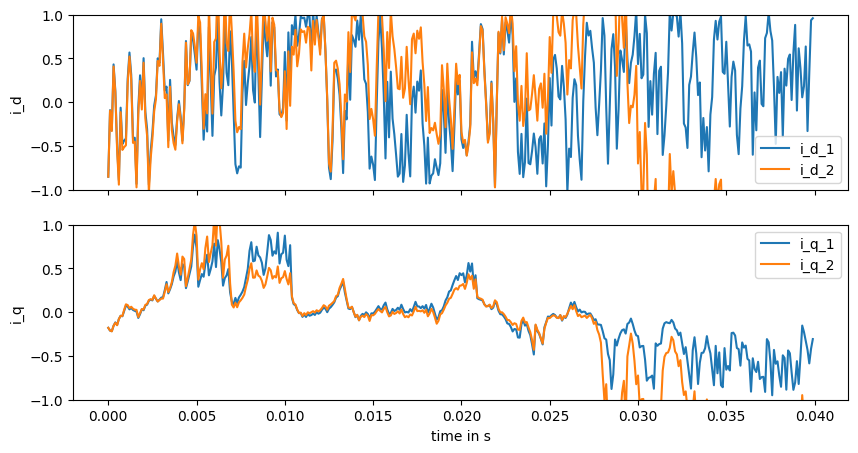

 46%|█████████████████████████████████████████████████████████████████████████▌                                                                                      | 91965/200000 [02:44<02:30, 716.79it/s]

Current val_loss: 0.2777477


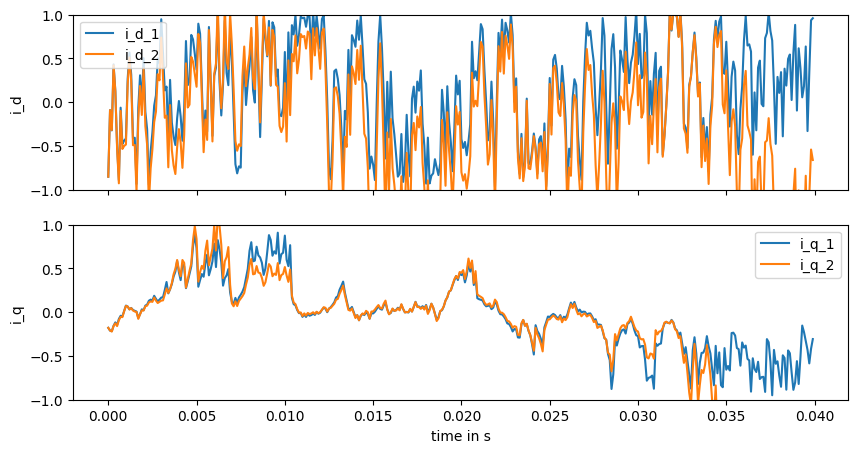

 47%|███████████████████████████████████████████████████████████████████████████▏                                                                                    | 93980/200000 [02:47<02:28, 714.13it/s]

Current val_loss: 49.835648


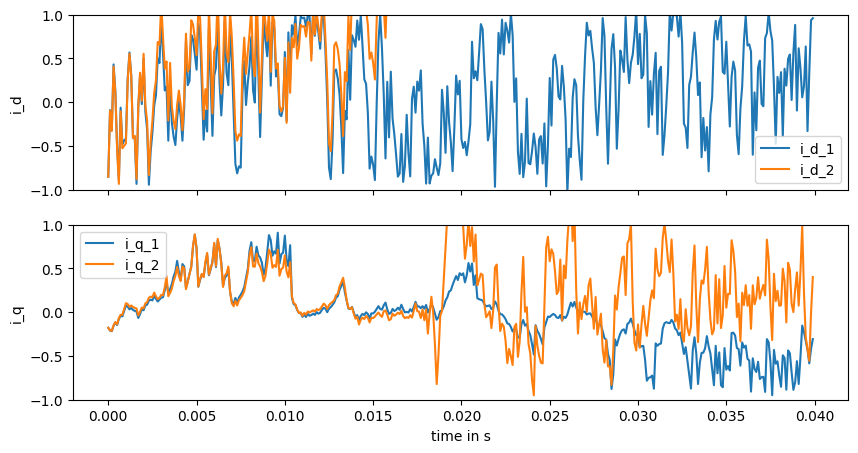

 48%|████████████████████████████████████████████████████████████████████████████▊                                                                                   | 95991/200000 [02:50<02:33, 676.86it/s]

Current val_loss: 0.3507226


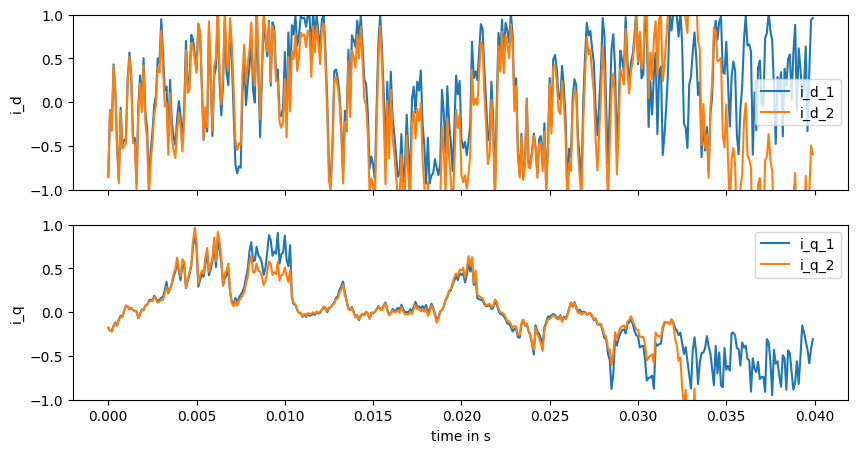

 49%|██████████████████████████████████████████████████████████████████████████████▍                                                                                 | 98000/200000 [02:54<02:25, 700.84it/s]

Current val_loss: 55.330887


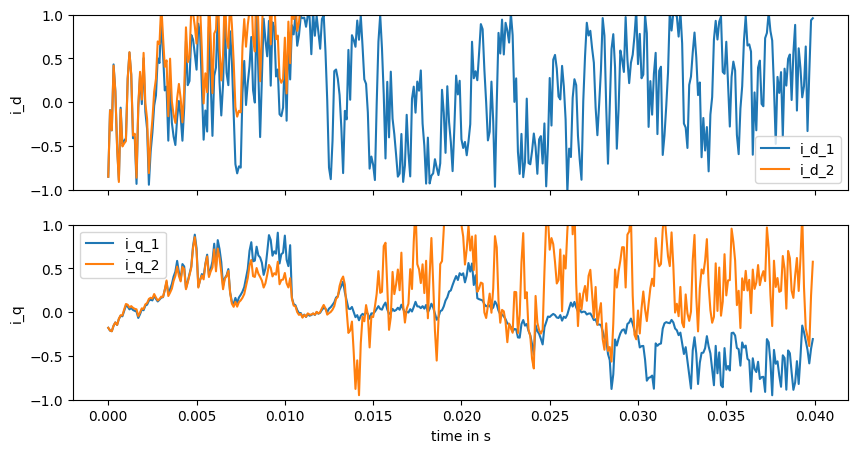

 50%|███████████████████████████████████████████████████████████████████████████████▉                                                                                | 99940/200000 [02:57<02:21, 705.22it/s]

Current val_loss: 42.147232


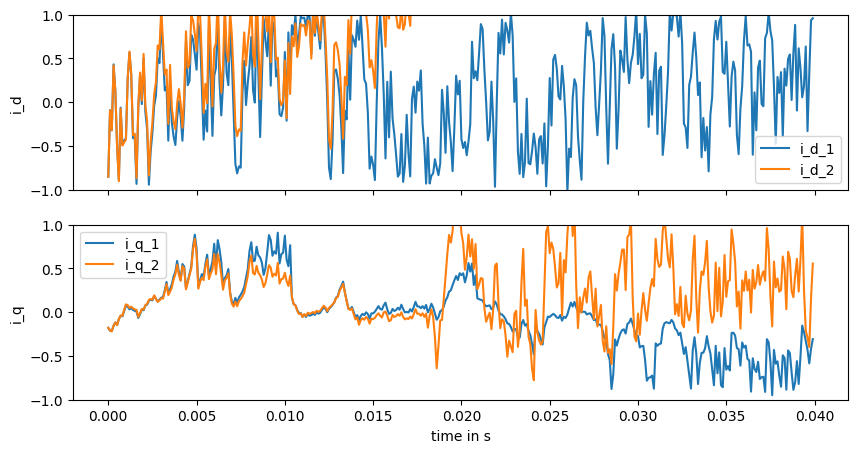

 51%|█████████████████████████████████████████████████████████████████████████████████                                                                              | 101986/200000 [03:01<02:18, 705.45it/s]

Current val_loss: 0.36929795


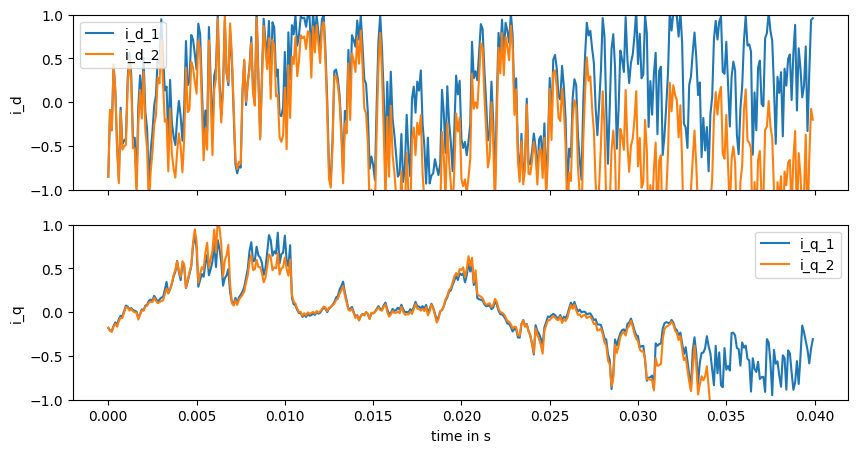

 52%|██████████████████████████████████████████████████████████████████████████████████▋                                                                            | 103991/200000 [03:04<02:16, 701.39it/s]

Current val_loss: 0.29074064


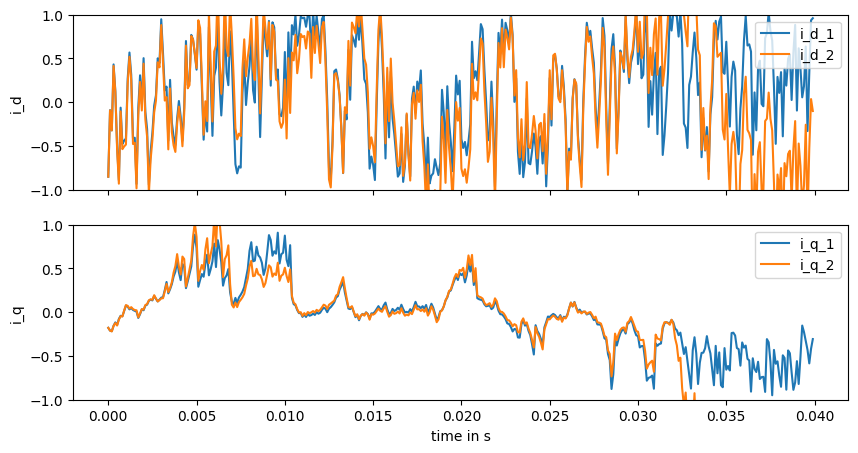

 53%|████████████████████████████████████████████████████████████████████████████████████▏                                                                          | 105932/200000 [03:07<02:11, 714.08it/s]

Current val_loss: 33.672867


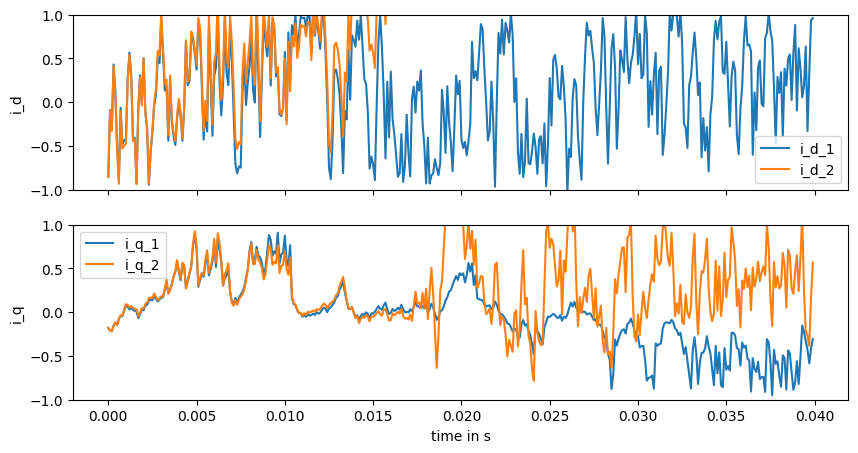

 54%|█████████████████████████████████████████████████████████████████████████████████████▊                                                                         | 107940/200000 [03:11<02:09, 708.64it/s]

Current val_loss: 0.33154282


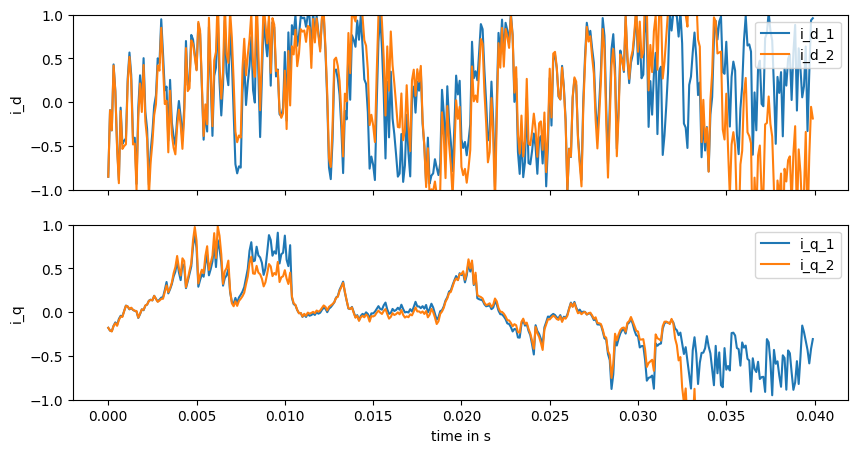

 55%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                       | 109947/200000 [03:14<02:06, 711.77it/s]

Current val_loss: 0.3866686


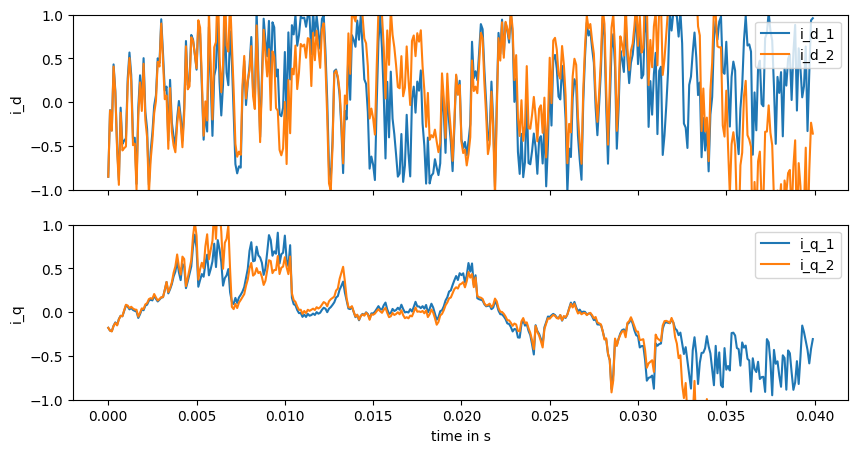

 56%|█████████████████████████████████████████████████████████████████████████████████████████                                                                      | 111958/200000 [03:17<02:03, 711.64it/s]

Current val_loss: 0.43633676


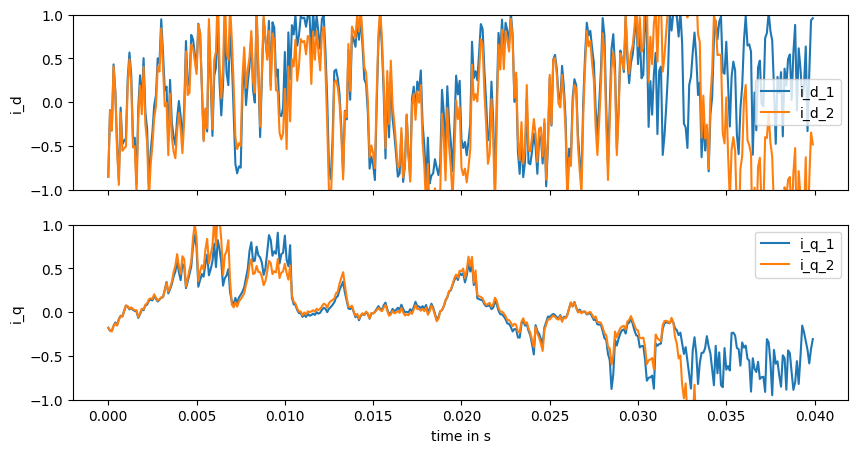

 57%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                    | 113954/200000 [03:21<02:01, 707.41it/s]

Current val_loss: 0.5850007


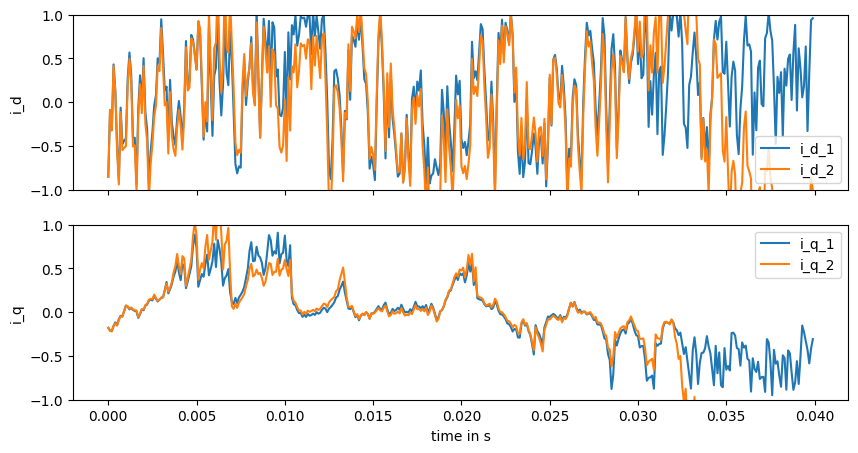

 58%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 115967/200000 [03:24<01:57, 714.82it/s]

Current val_loss: 0.6227


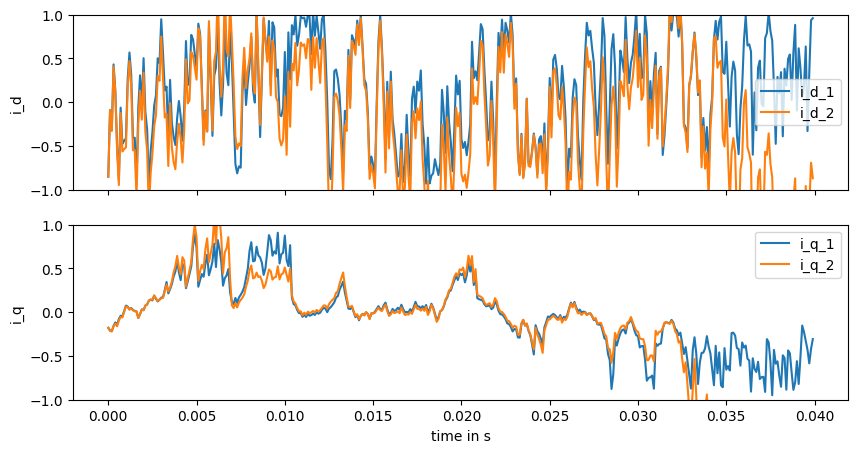

 59%|█████████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 117982/200000 [03:27<01:55, 710.22it/s]

Current val_loss: 28.545677


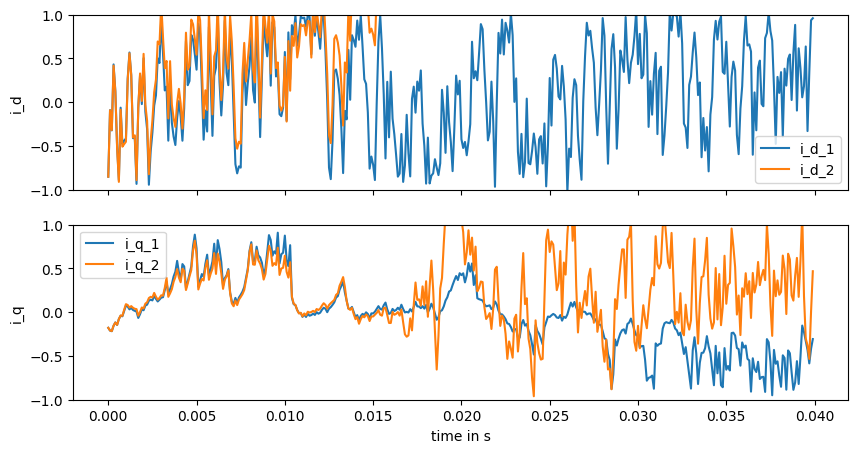

 60%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 119985/200000 [03:30<01:52, 710.46it/s]

Current val_loss: 1.6637154


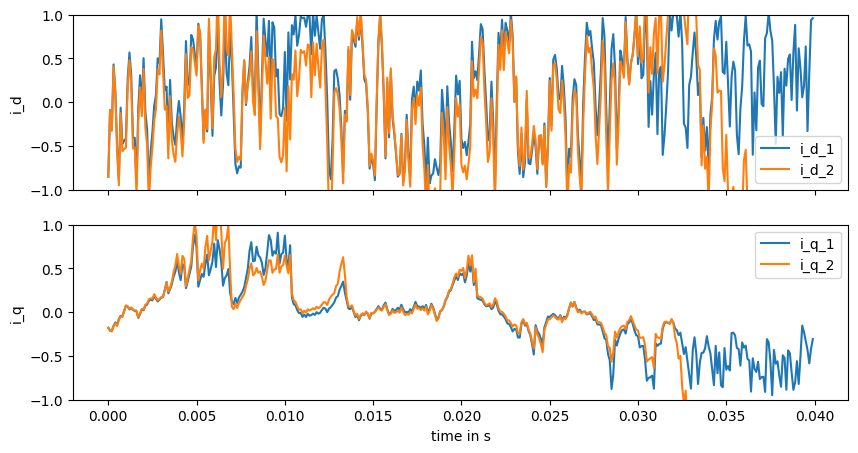

 61%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 121999/200000 [03:34<01:49, 714.87it/s]

Current val_loss: 27.1936


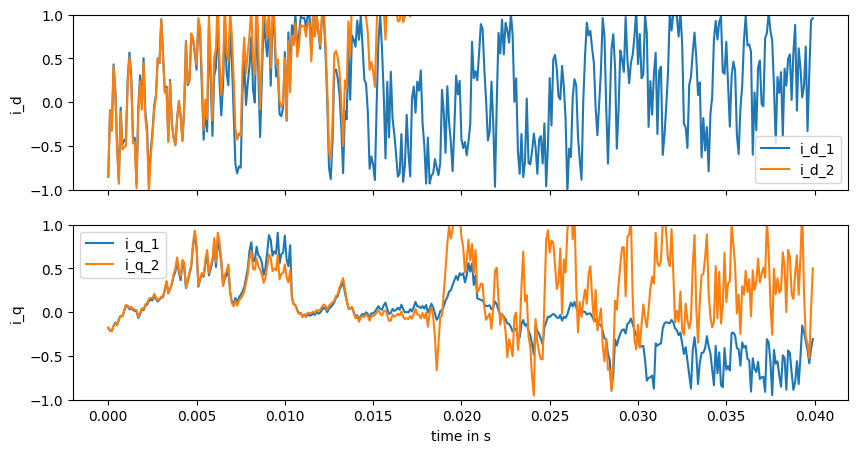

 62%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                            | 123943/200000 [03:37<01:46, 714.97it/s]

Current val_loss: 0.12345594


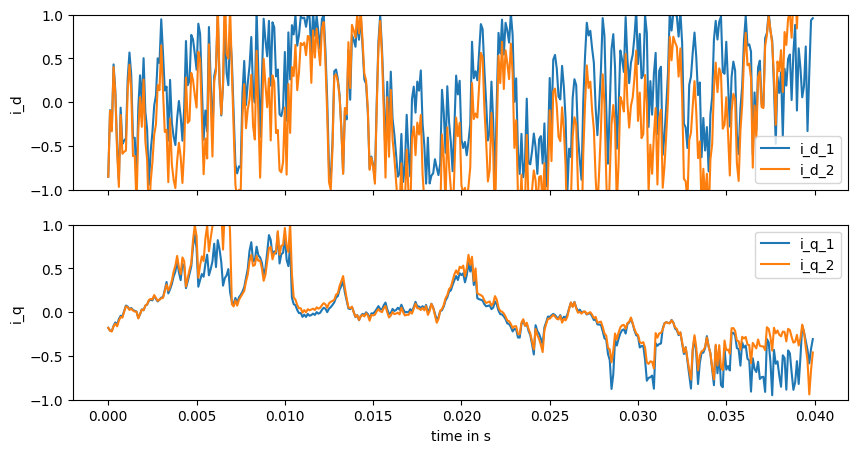

 63%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 125961/200000 [03:40<01:43, 718.19it/s]

Current val_loss: 6.672432


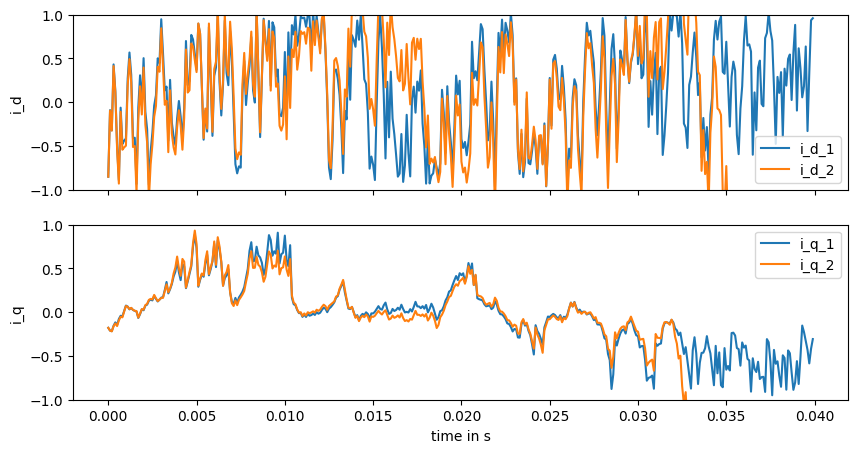

 64%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 127975/200000 [03:43<01:41, 712.91it/s]

Current val_loss: 33.471226


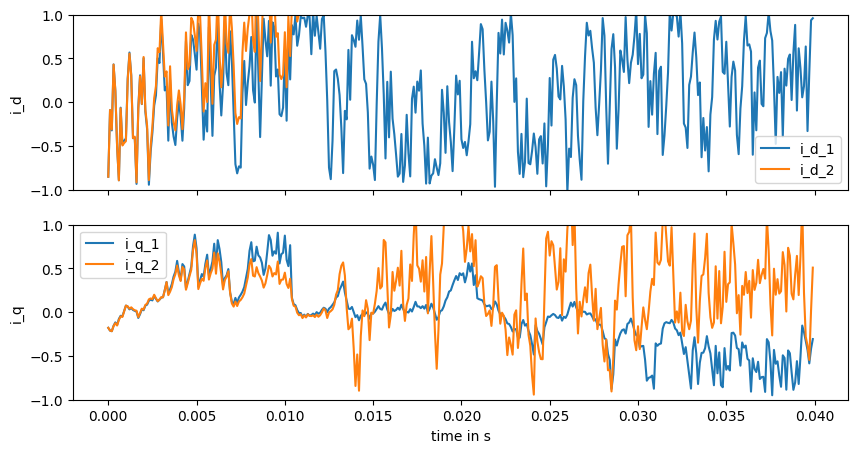

 65%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 129986/200000 [03:47<01:37, 715.14it/s]

Current val_loss: 18.822649


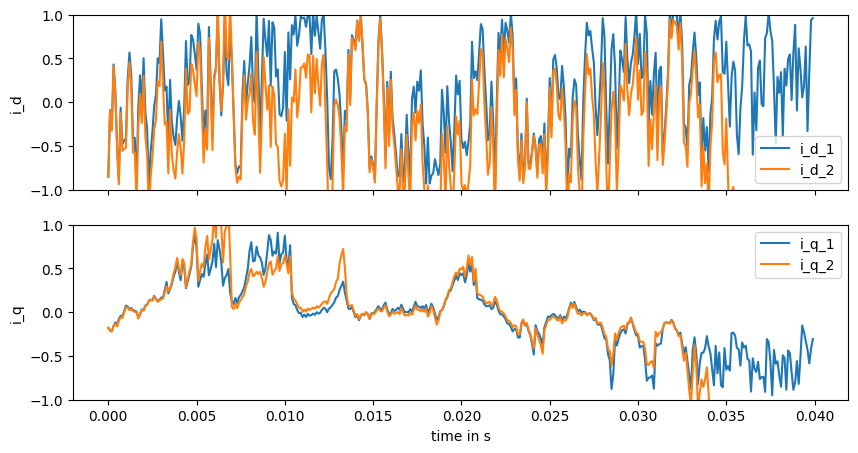

 66%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 131996/200000 [03:50<01:34, 716.78it/s]

Current val_loss: 27.044819


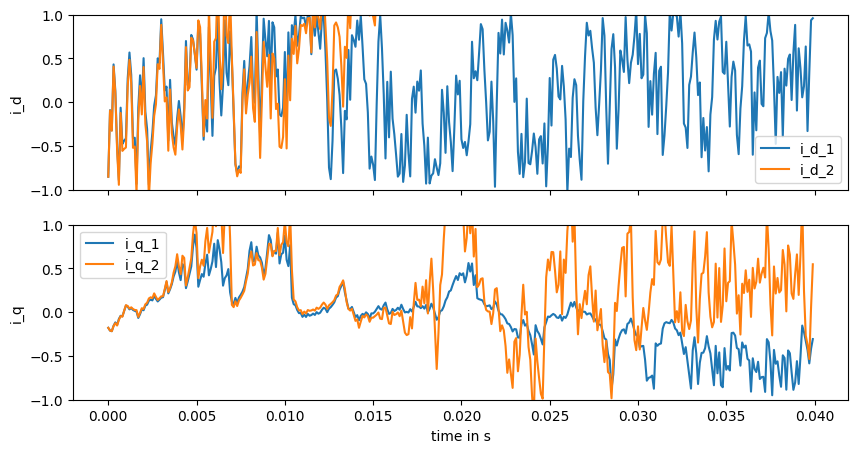

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                    | 133943/200000 [03:53<01:32, 713.39it/s]

Current val_loss: 66.53609


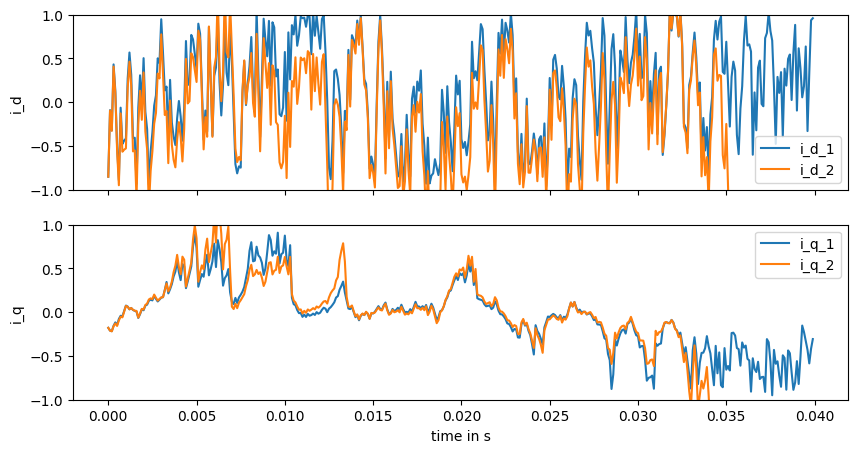

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 135961/200000 [03:56<01:31, 698.17it/s]

Current val_loss: 25.05948


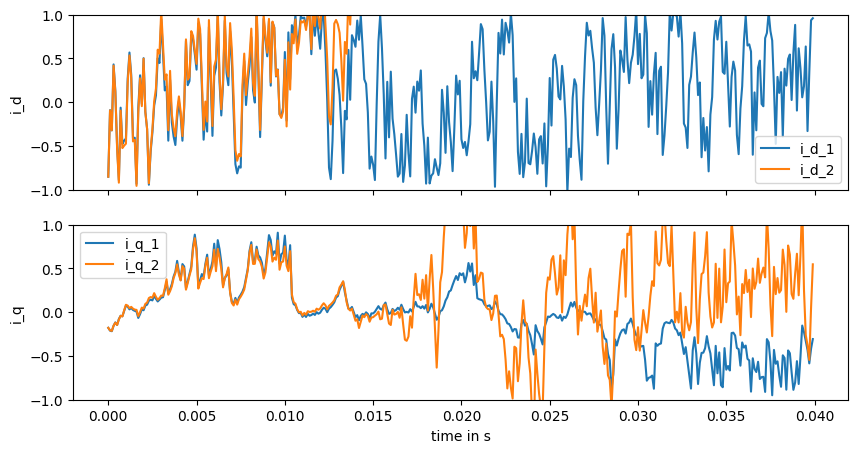

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 137982/200000 [04:00<01:27, 712.50it/s]

Current val_loss: 1032.9312


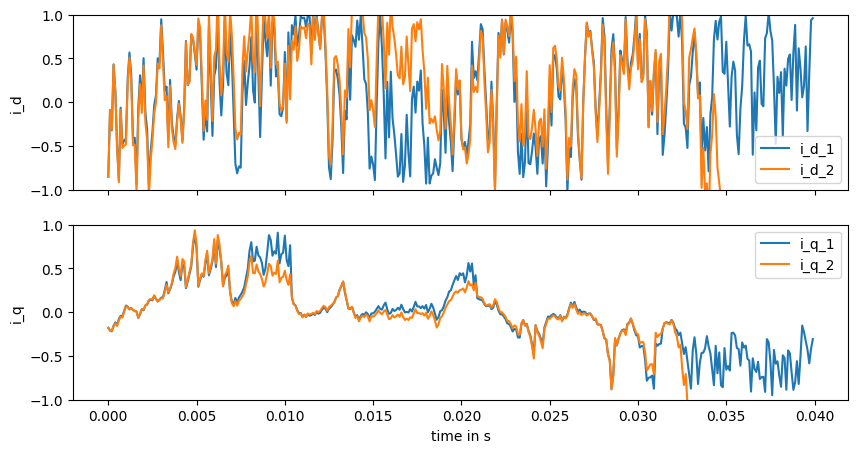

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                               | 139938/200000 [04:03<01:23, 718.83it/s]

Current val_loss: 3457.26


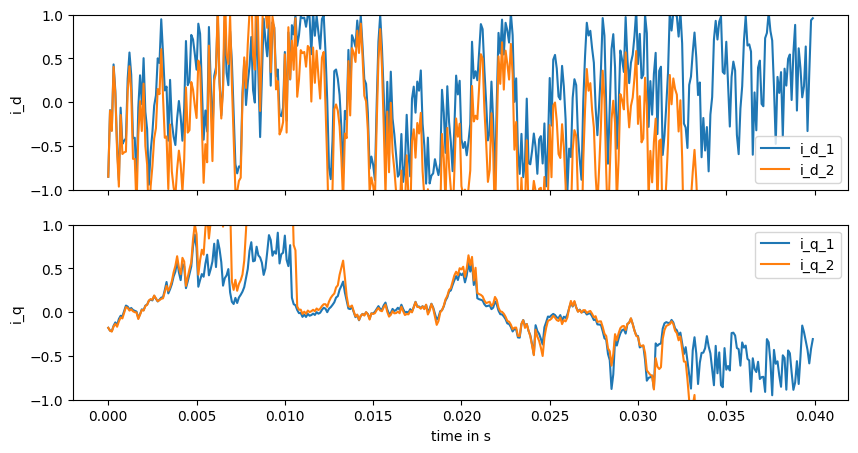

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                              | 141960/200000 [04:06<01:21, 715.31it/s]

Current val_loss: 1769.5311


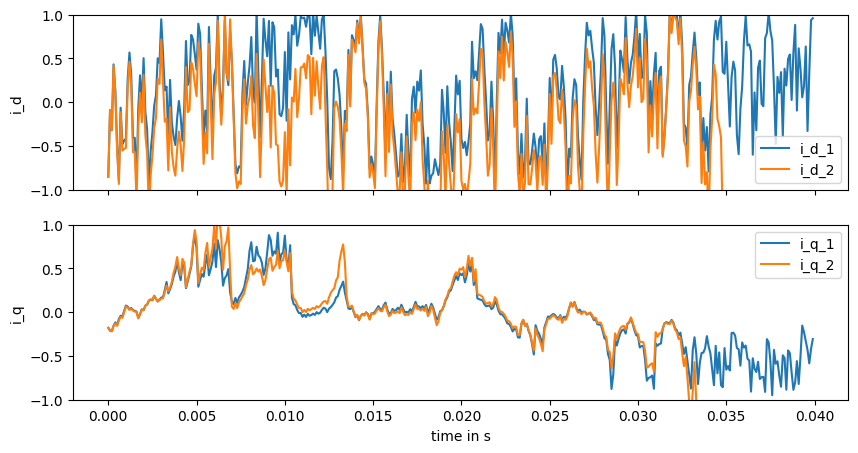

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                            | 143982/200000 [04:09<01:18, 713.09it/s]

Current val_loss: 43322030000.0


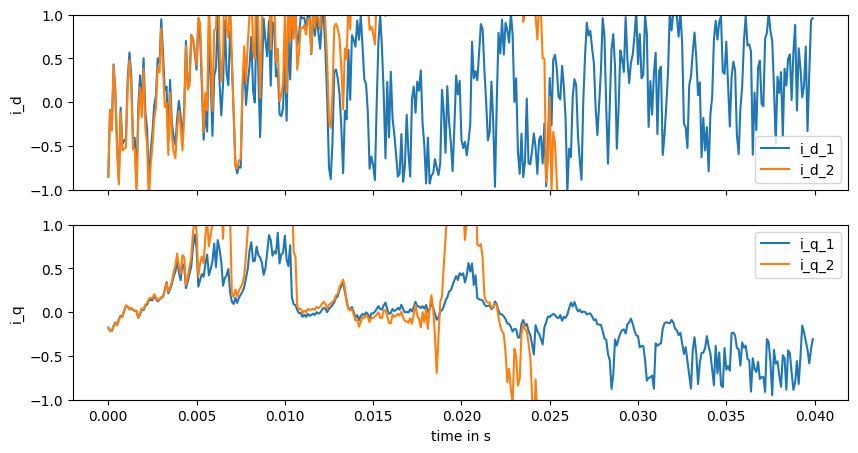

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 145990/200000 [04:14<01:15, 714.11it/s]

Current val_loss: 25158.635


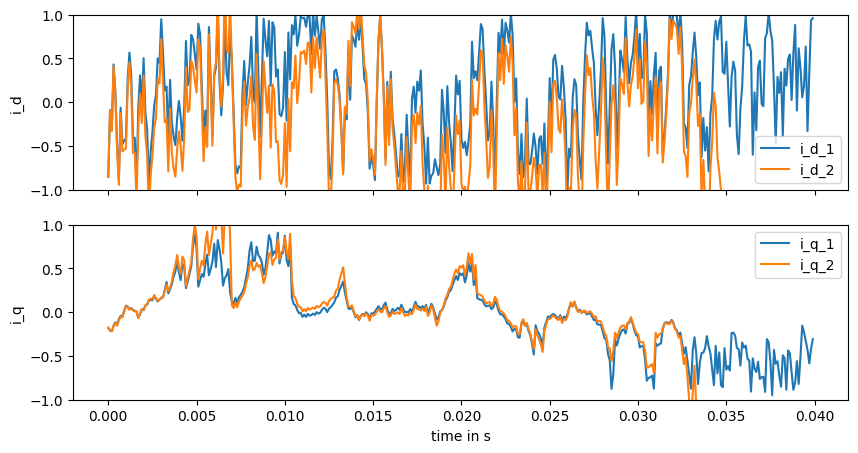

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 147929/200000 [04:17<01:13, 709.60it/s]

Current val_loss: 25453276000000.0


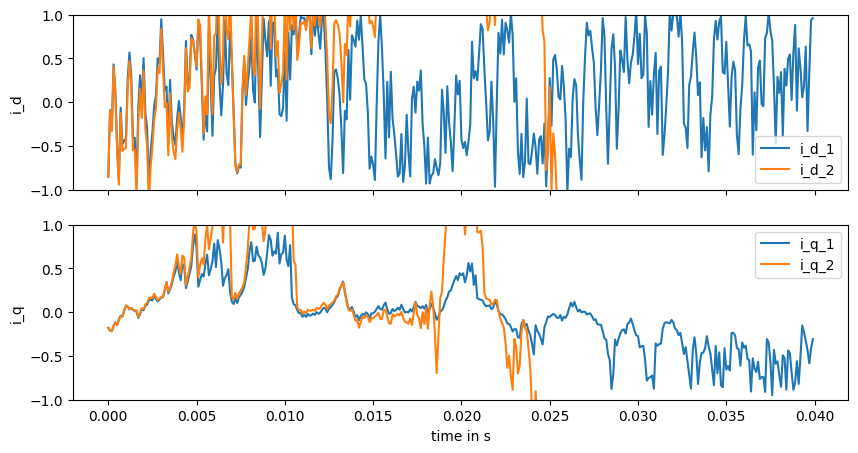

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 149934/200000 [04:20<01:10, 708.93it/s]

Current val_loss: 1994549200000.0


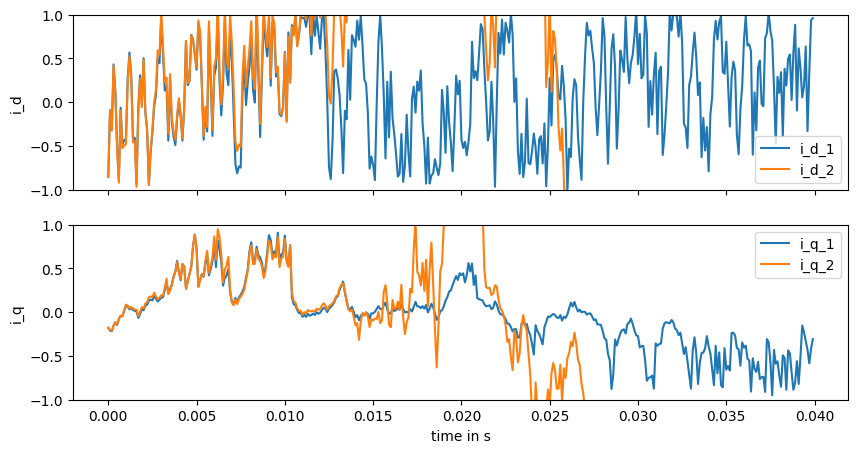

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                      | 151944/200000 [04:23<01:07, 716.08it/s]

Current val_loss: 2158629600000000.0


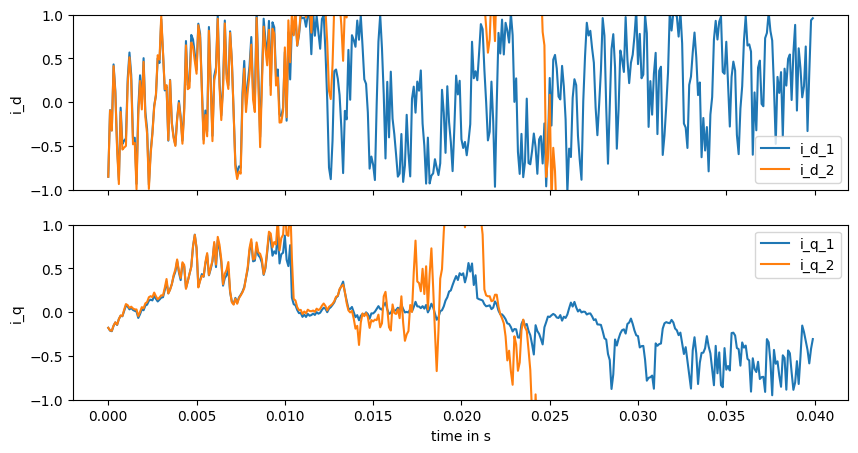

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                    | 153964/200000 [04:27<01:04, 718.34it/s]

Current val_loss: 24.554213


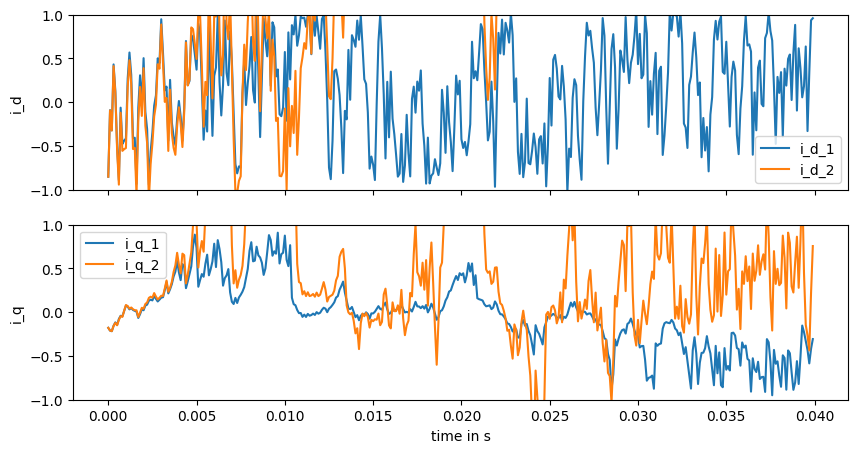

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 155980/200000 [04:30<01:02, 705.69it/s]

Current val_loss: 1.7846776e+17


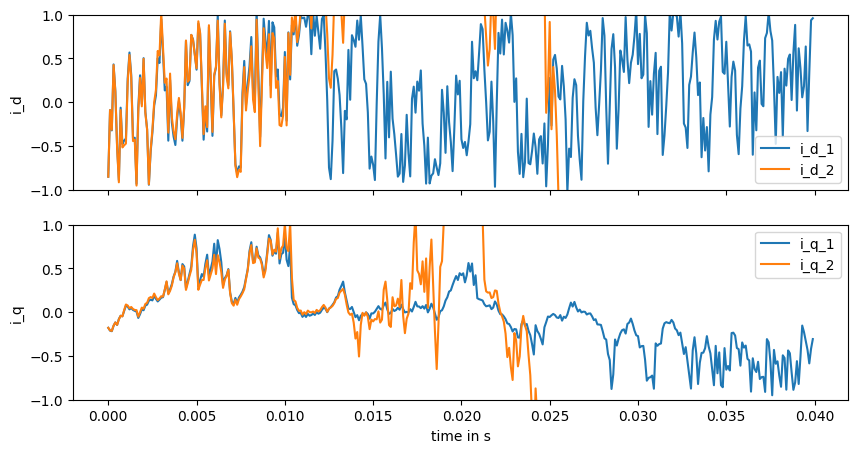

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 157997/200000 [04:33<00:58, 712.49it/s]

Current val_loss: 739882.5


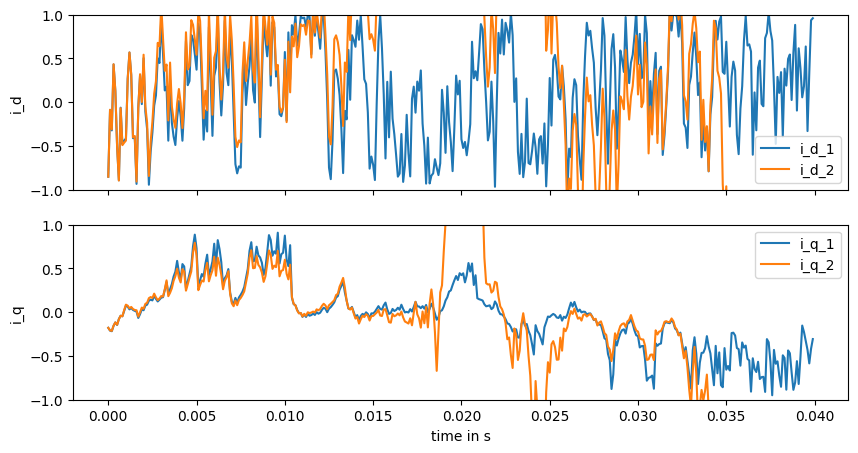

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 159941/200000 [04:36<00:56, 712.97it/s]

Current val_loss: 25.53539


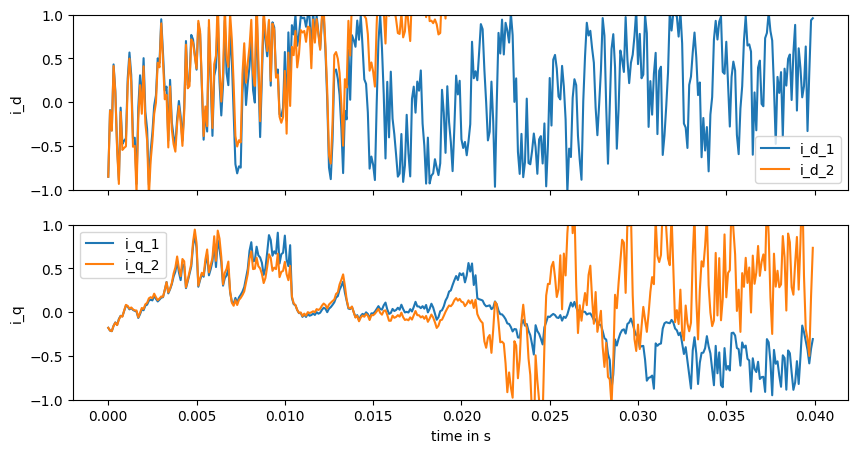

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                              | 161954/200000 [04:39<00:55, 685.56it/s]

Current val_loss: 9.134326e+19


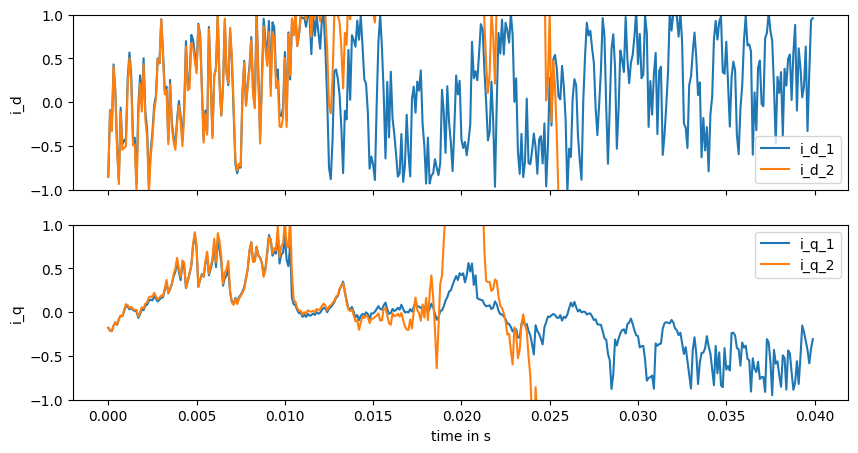

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 163964/200000 [04:43<00:50, 709.02it/s]

Current val_loss: 9.3094696e+20


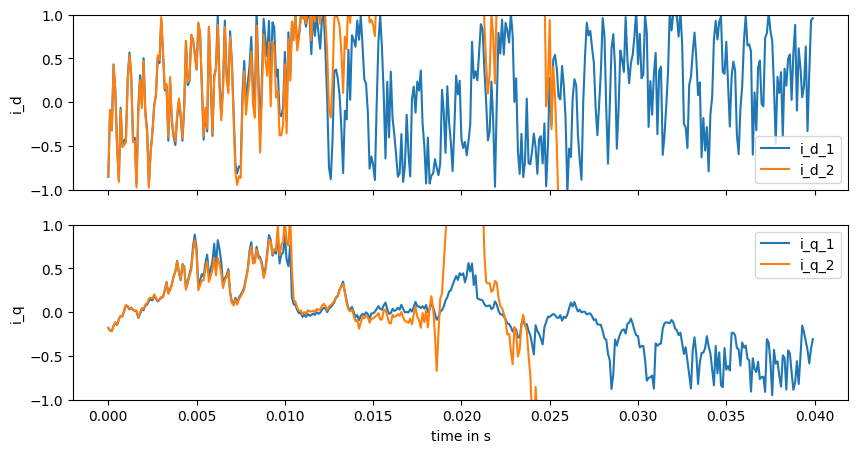

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 165976/200000 [04:46<00:47, 713.00it/s]

Current val_loss: 30.415352


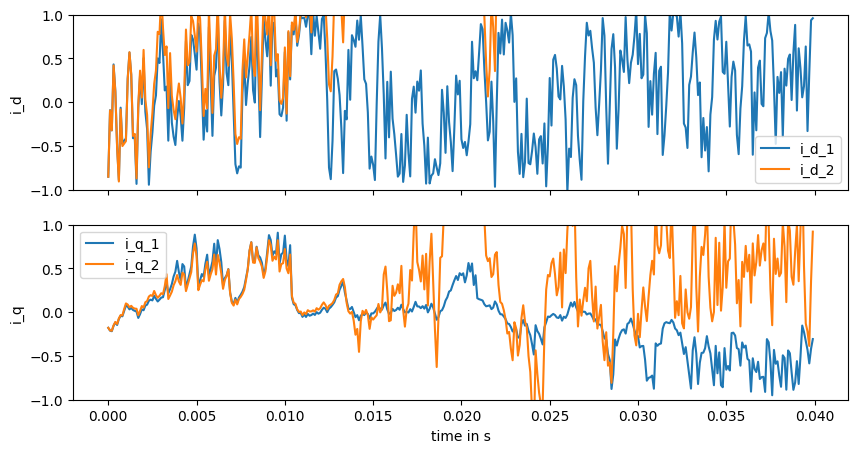

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 167989/200000 [04:49<00:44, 712.29it/s]

Current val_loss: 30.03011


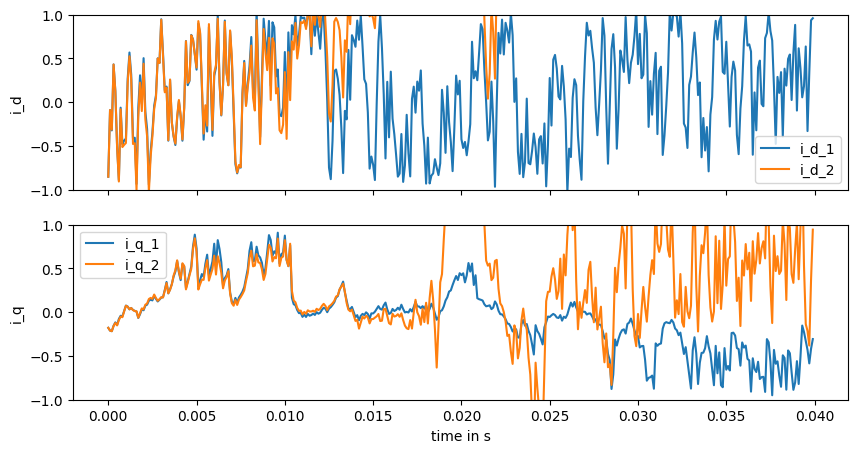

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 169997/200000 [04:53<00:42, 707.76it/s]

Current val_loss: 29.318298


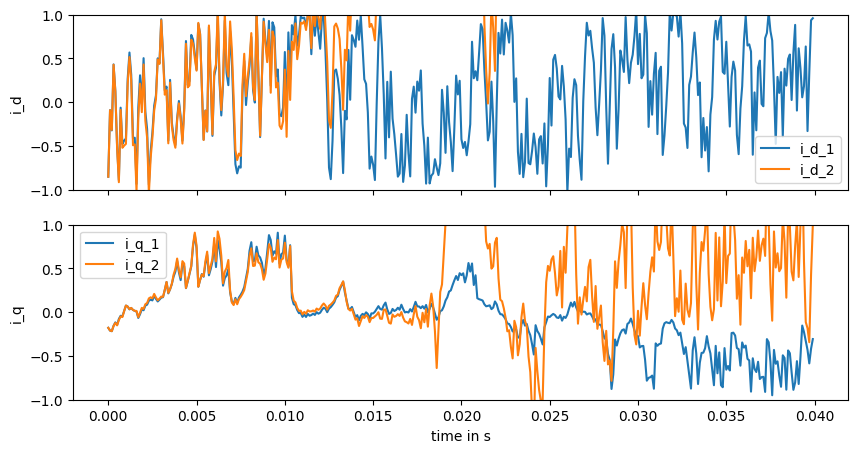

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 171939/200000 [04:56<00:39, 715.93it/s]

Current val_loss: 35.41792


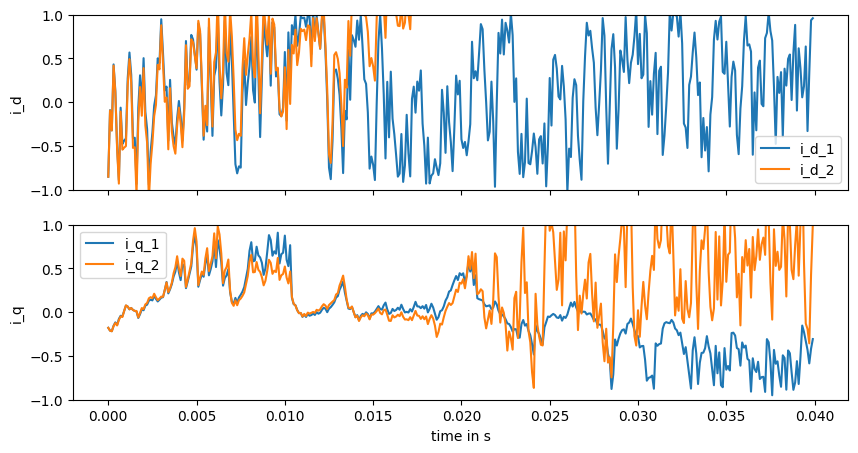

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 173953/200000 [04:59<00:36, 714.67it/s]

Current val_loss: 32.398254


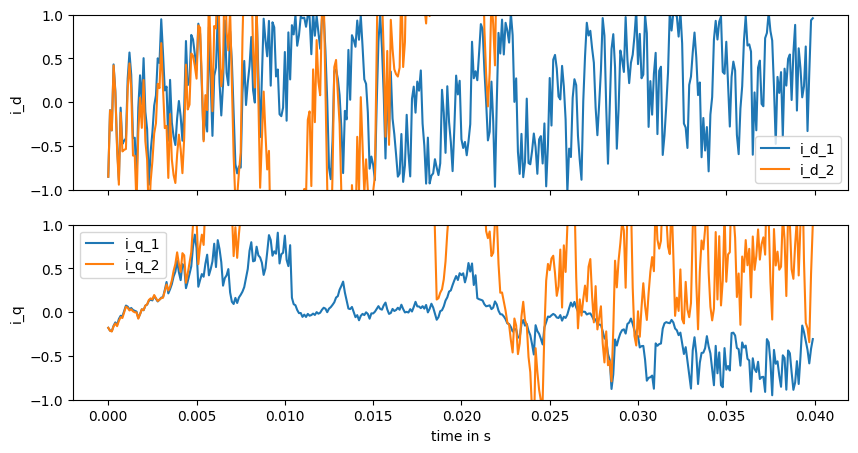

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 175968/200000 [05:02<00:33, 713.58it/s]

Current val_loss: 35.06924


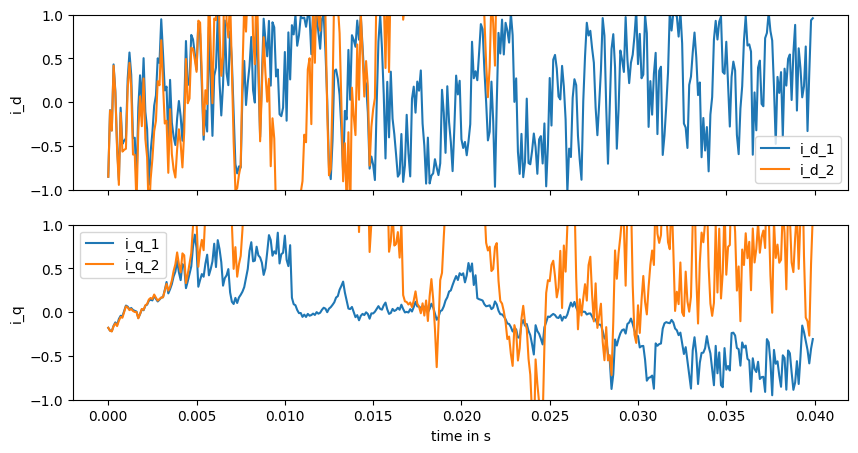

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 177997/200000 [05:06<00:30, 717.73it/s]

Current val_loss: 31.835037


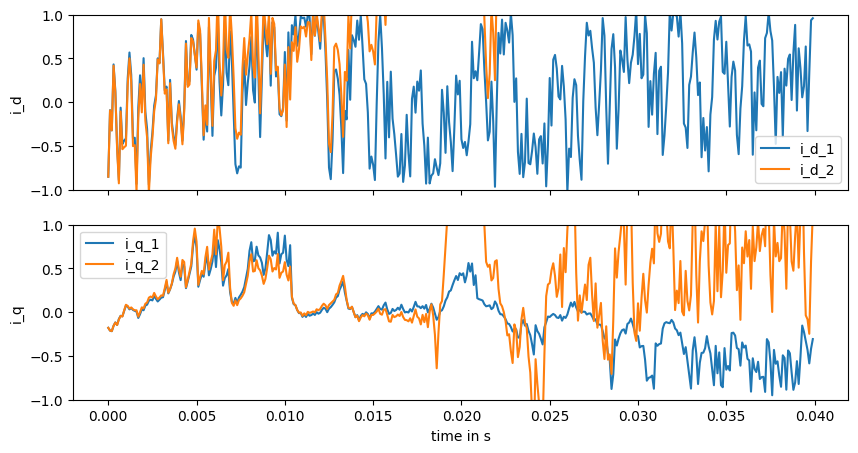

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 179945/200000 [05:09<00:28, 714.77it/s]

Current val_loss: 36.609135


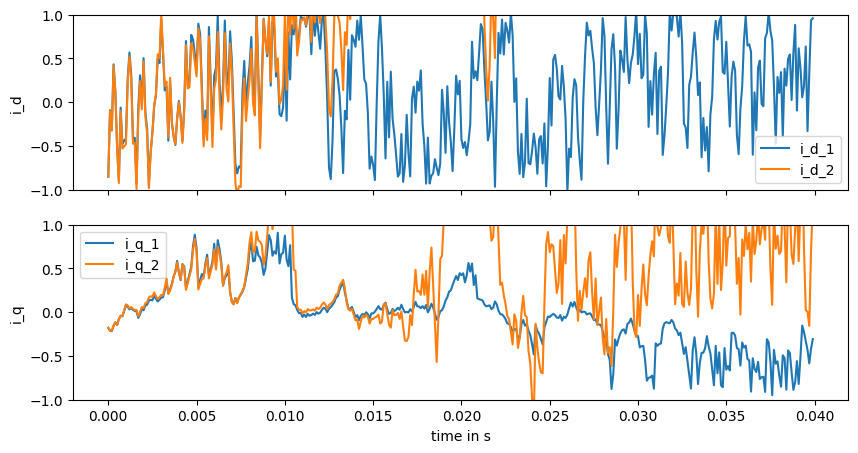

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋              | 181996/200000 [05:12<00:25, 702.42it/s]

Current val_loss: 2.8824328e+30


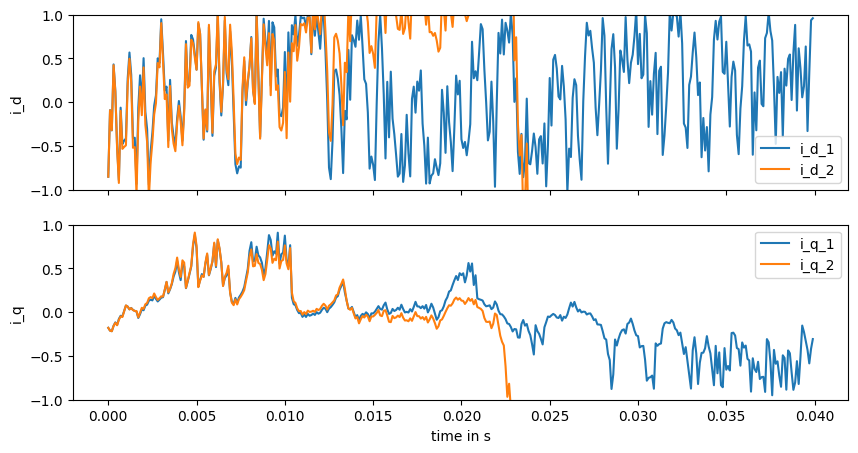

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 183976/200000 [05:15<00:22, 701.60it/s]

Current val_loss: 28.648909


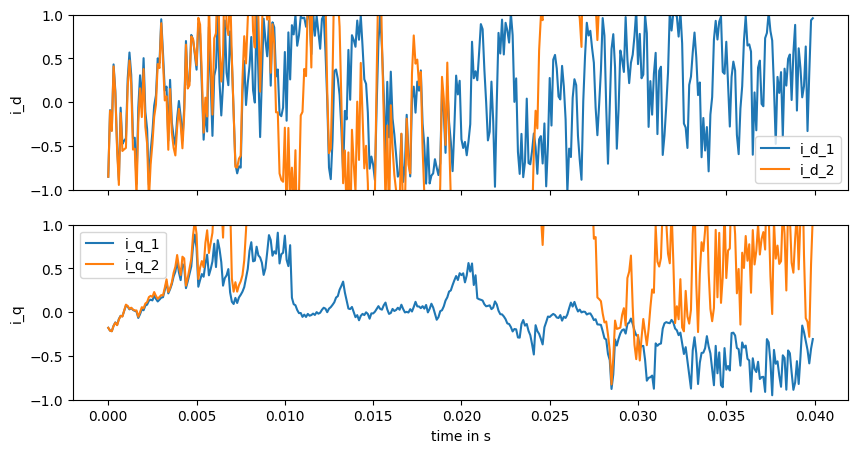

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 185963/200000 [05:19<00:19, 702.93it/s]

Current val_loss: 56030700000.0


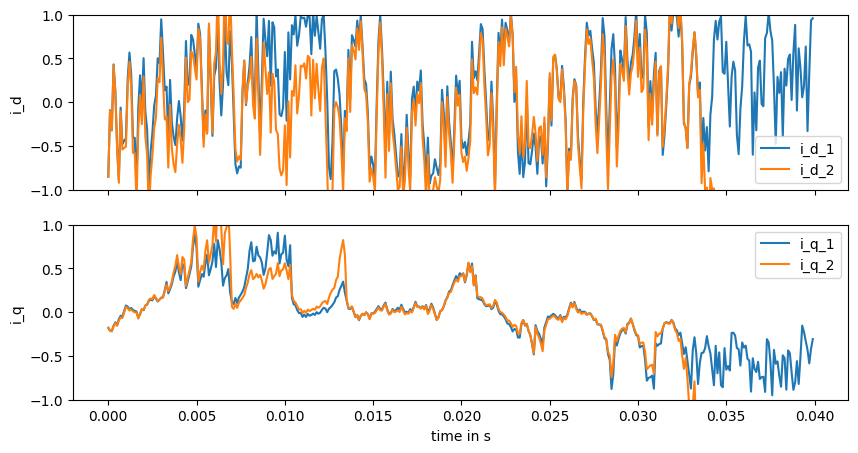

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 187951/200000 [05:22<00:17, 704.05it/s]

Current val_loss: 37.179707


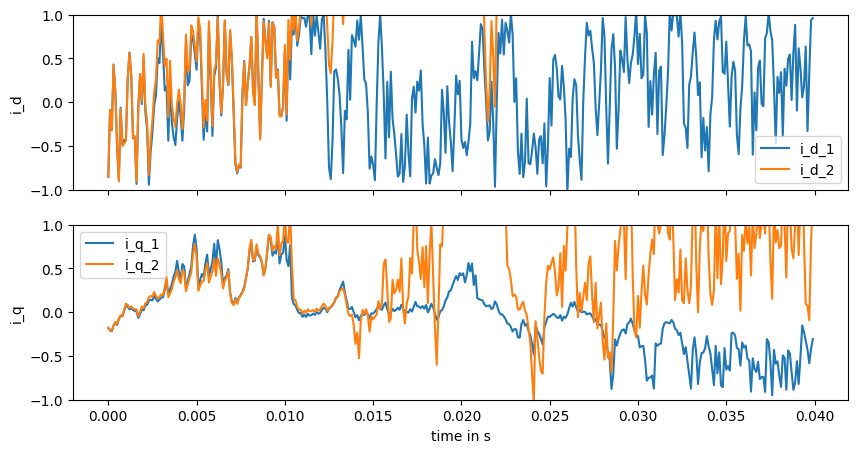

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 189937/200000 [05:25<00:14, 701.26it/s]

Current val_loss: 32.553864


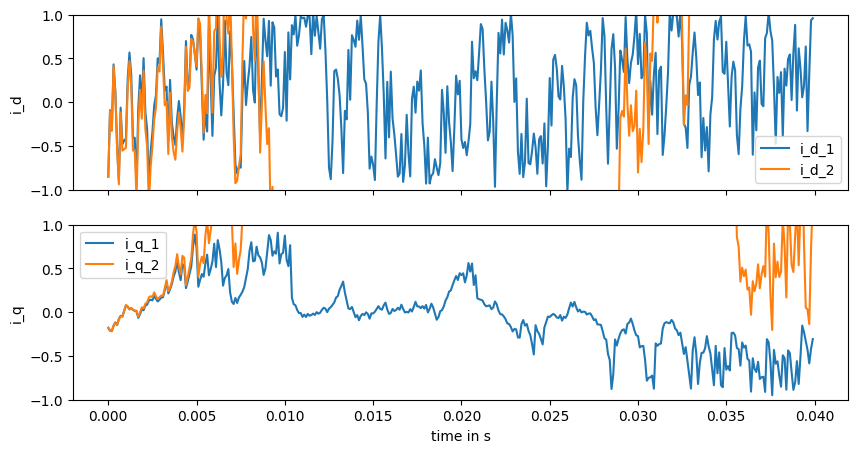

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 191961/200000 [05:30<00:11, 693.09it/s]

Current val_loss: 2.0130575e+28


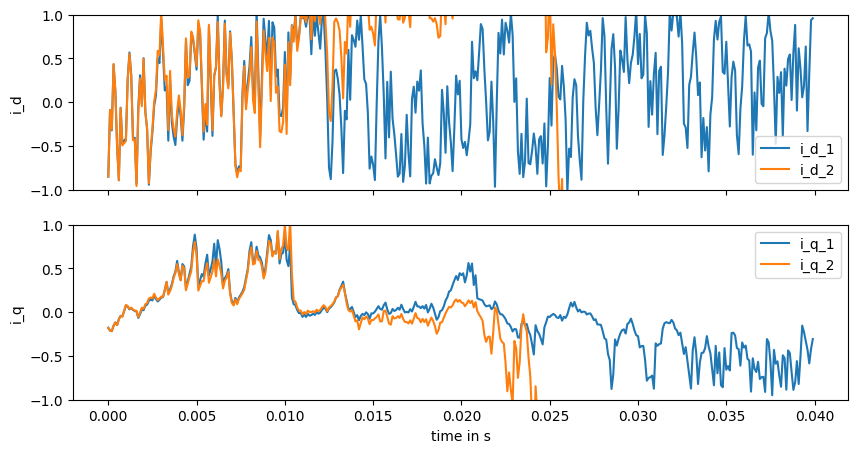

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 193992/200000 [05:33<00:08, 684.68it/s]

Current val_loss: 34.7667


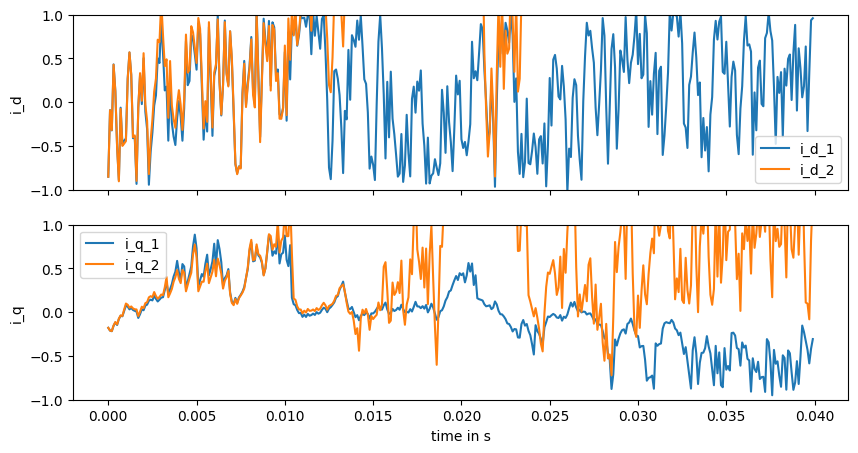

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 195963/200000 [05:36<00:05, 698.48it/s]

Current val_loss: 2122809900000.0


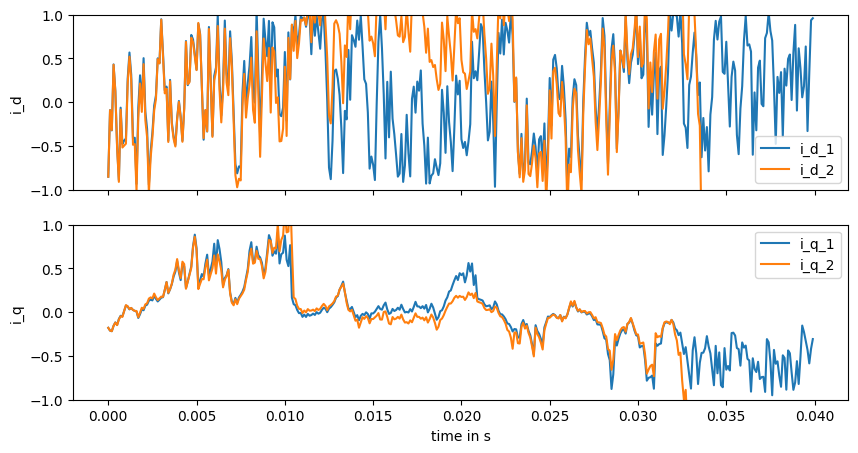

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 197946/200000 [05:40<00:02, 703.36it/s]

Current val_loss: 661.74347


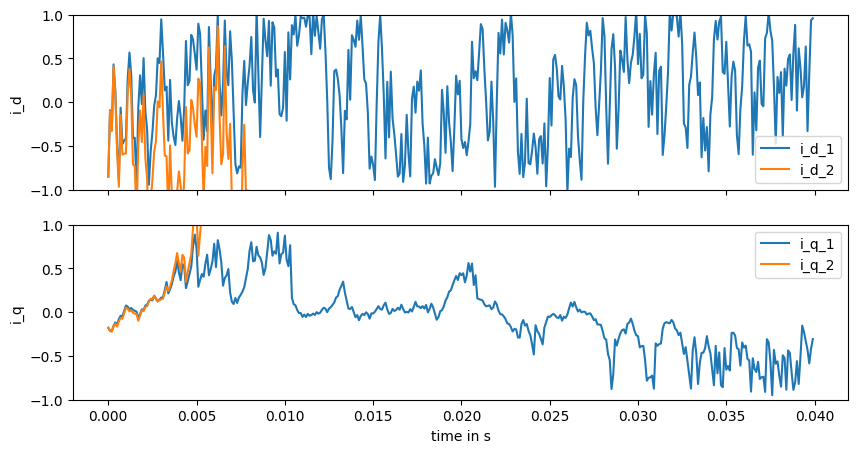

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 200000/200000 [05:43<00:00, 582.40it/s]


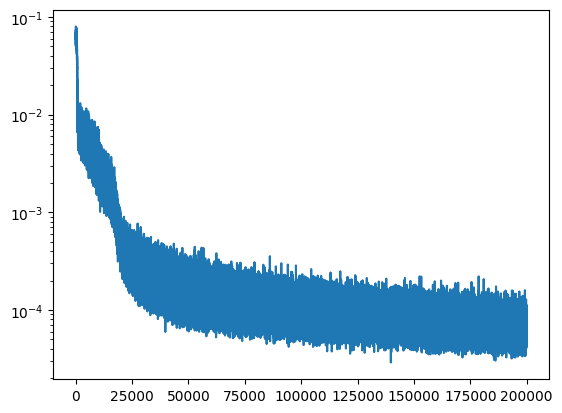

In [18]:
fin_node_1,fin_opt_state,fin_keys,losses, val_losses=mtrainer.fit_non_jit(node,opt_state,keys,plot_every=2000)
plt.plot(losses)
plt.yscale('log')

In [19]:
eqx.tree_serialise_leaves("trained_models/DMPE_Model_200k_1len_100b_step0_0001.eqx", fin_node_1)

In [20]:
batch_size=100
mtrainer=ModelTrainer(
    train_steps=100_000,
    batch_size=batch_size,
    sequence_len=100,
    featurize=featurize_node,
    train_data_gen_sin=data_gen_single,
    val_data_gen_sin= val_data_gen_single,
    model_optimizer=optimizer_node,
    tau= 1e-4
    )
keys=jax.vmap(jax.random.PRNGKey)(np.random.randint(0, 2**31, size=(batch_size,)))

  0%|                                                                                                                                                                             | 0/100000 [00:00<?, ?it/s]/home/olivers/.conda/envs/venv_proj/lib/python3.11/site-packages/jax/_src/numpy/lax_numpy.py:3042: UserWarning: Explicitly requested dtype float64 requested in asarray is not available, and will be truncated to dtype float32. To enable more dtypes, set the jax_enable_x64 configuration option or the JAX_ENABLE_X64 shell environment variable. See https://github.com/google/jax#current-gotchas for more.
  start = asarray(start, dtype=computation_dtype)
/home/olivers/.conda/envs/venv_proj/lib/python3.11/site-packages/jax/_src/numpy/lax_numpy.py:3043: UserWarning: Explicitly requested dtype float64 requested in asarray is not available, and will be truncated to dtype float32. To enable more dtypes, set the jax_enable_x64 configuration option or the JAX_ENABLE_X64 shell environment variable.

Current val_loss: 0.10470737


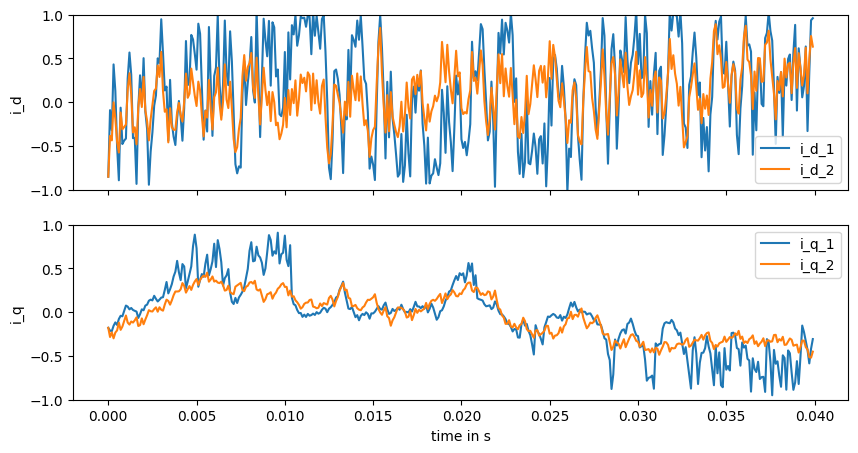

  4%|██████▍                                                                                                                                                           | 3998/100000 [01:34<36:19, 44.05it/s]

Current val_loss: 0.07013265


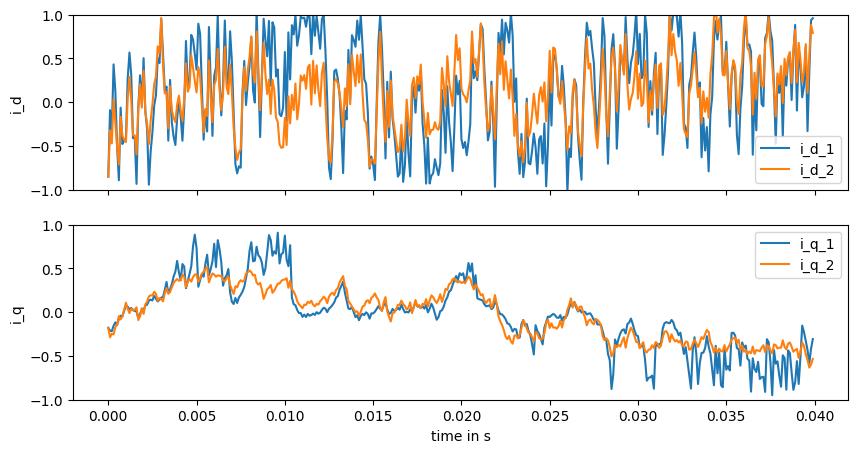

  6%|█████████▋                                                                                                                                                        | 5998/100000 [02:20<35:40, 43.91it/s]

Current val_loss: 0.046341375


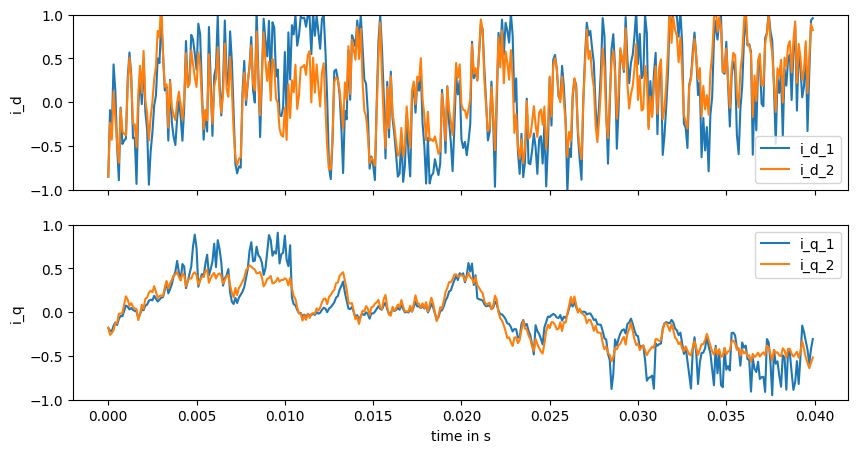

  8%|████████████▉                                                                                                                                                     | 7998/100000 [03:06<35:00, 43.80it/s]

Current val_loss: 0.037218485


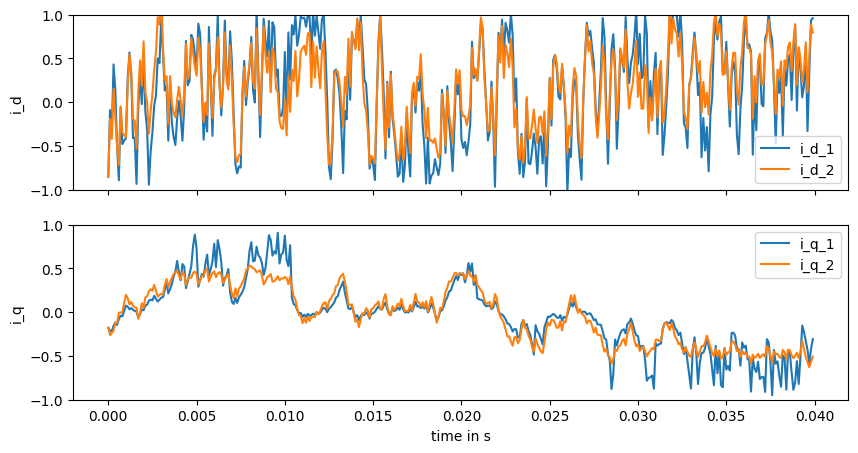

 10%|████████████████▏                                                                                                                                                 | 9998/100000 [03:53<34:11, 43.86it/s]

Current val_loss: 0.034301847


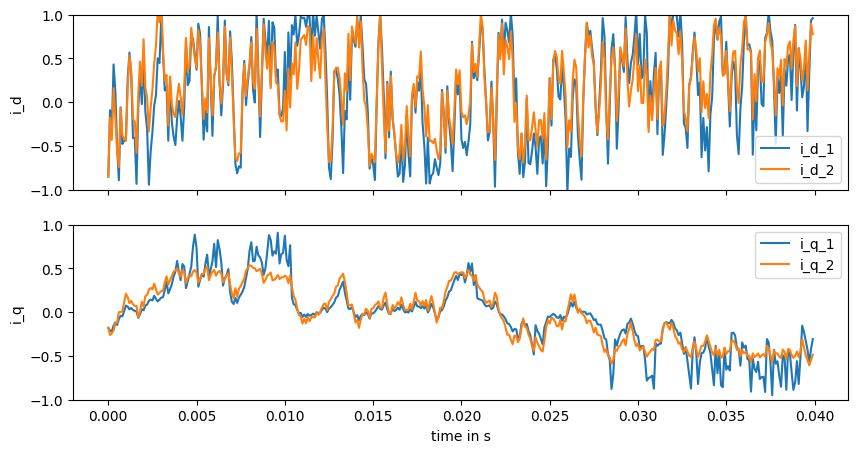

 12%|███████████████████▎                                                                                                                                             | 11998/100000 [04:40<33:40, 43.55it/s]

Current val_loss: 0.028613284


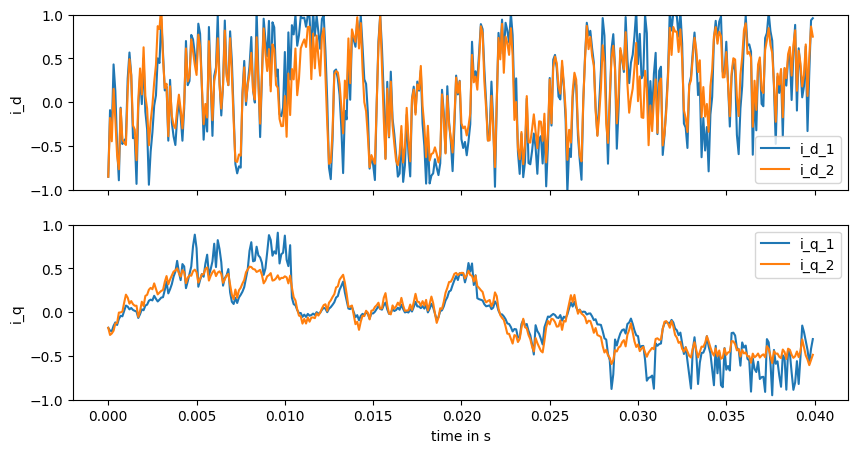

 14%|██████████████████████▌                                                                                                                                          | 13998/100000 [05:26<32:31, 44.07it/s]

Current val_loss: 0.026793767


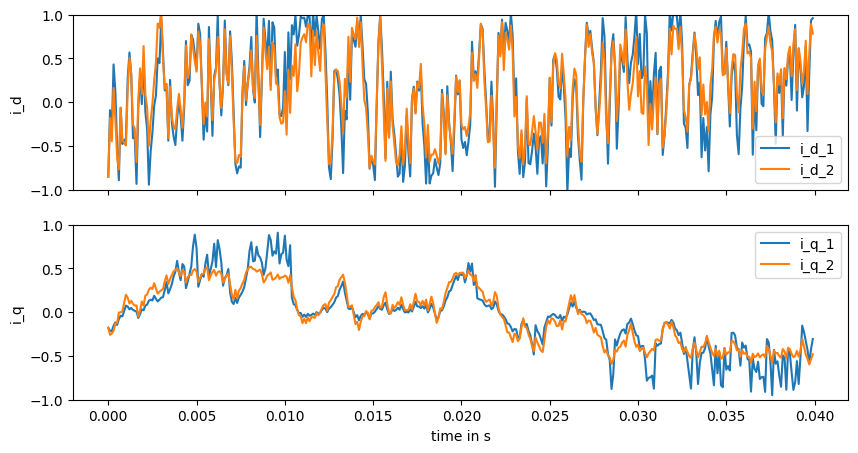

 16%|█████████████████████████▊                                                                                                                                       | 15998/100000 [06:12<32:02, 43.69it/s]

Current val_loss: 0.026434442


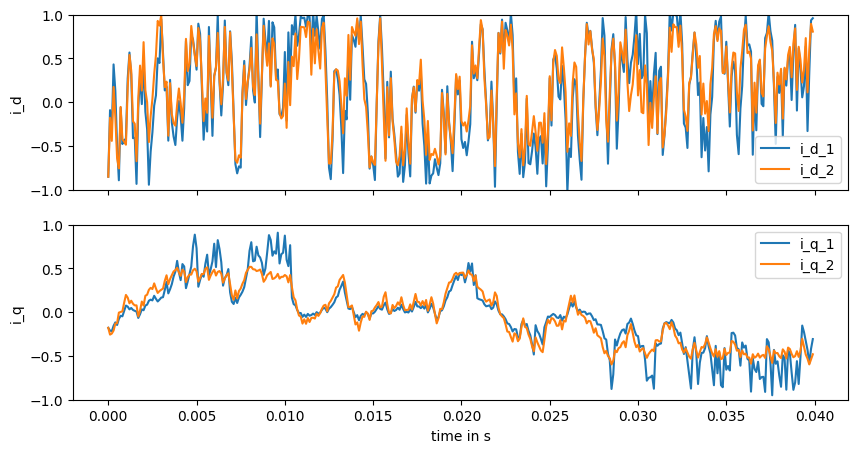

 18%|████████████████████████████▉                                                                                                                                    | 17998/100000 [06:58<30:57, 44.14it/s]

Current val_loss: 0.024304515


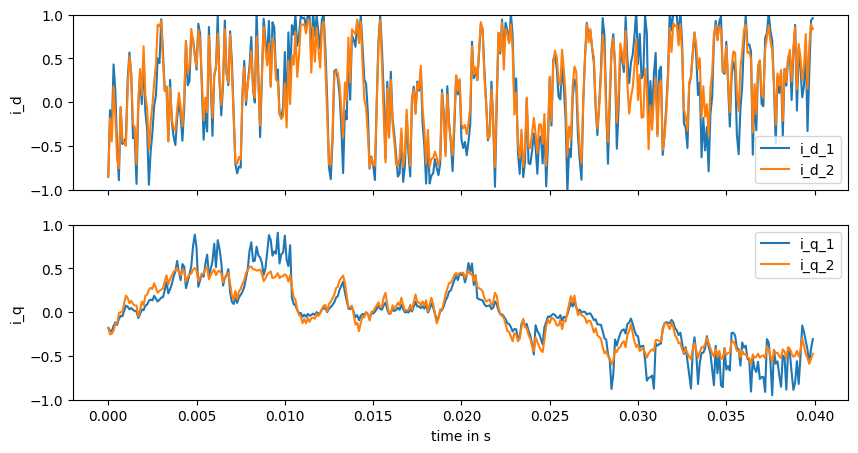

 20%|████████████████████████████████▏                                                                                                                                | 19998/100000 [07:44<30:52, 43.19it/s]

Current val_loss: 0.023940582


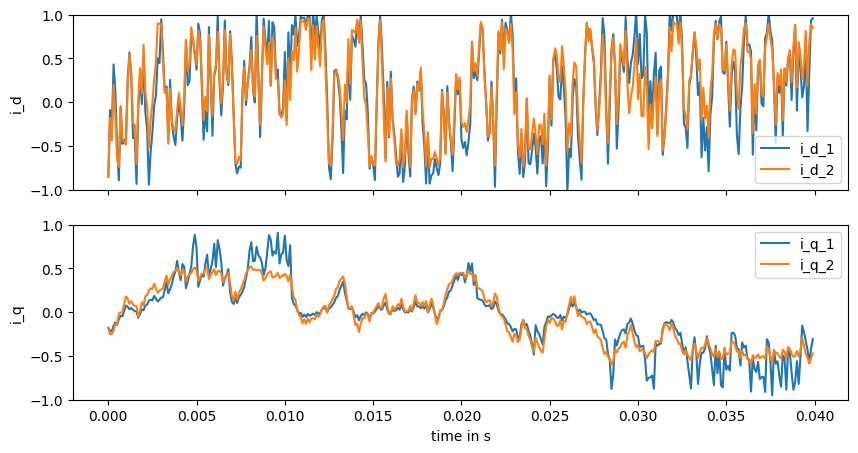

 22%|███████████████████████████████████▍                                                                                                                             | 21998/100000 [08:30<29:34, 43.97it/s]

Current val_loss: 0.022716576


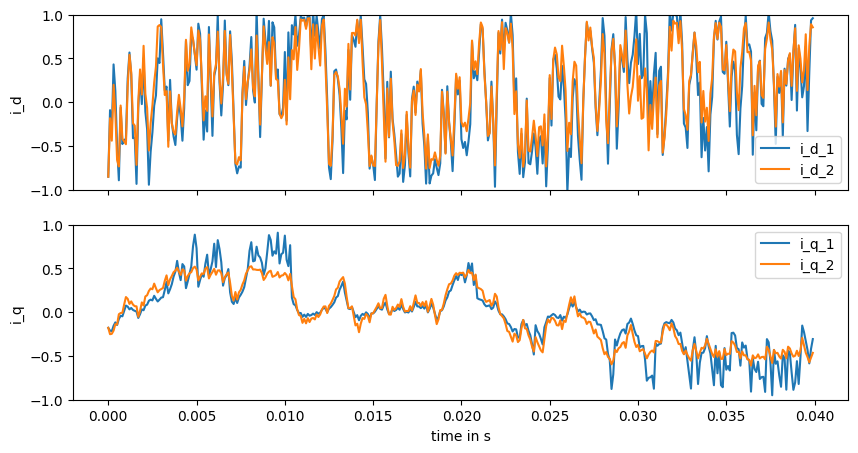

 24%|██████████████████████████████████████▋                                                                                                                          | 23998/100000 [09:20<34:35, 36.62it/s]

Current val_loss: 0.022275107


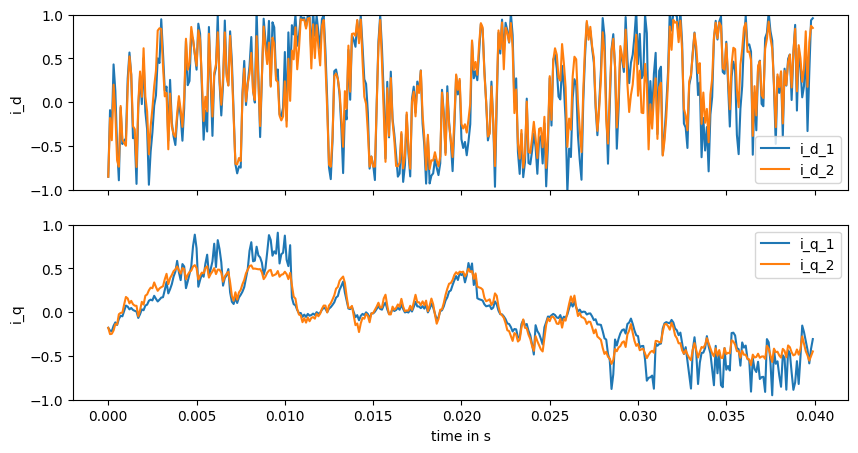

 26%|█████████████████████████████████████████▊                                                                                                                       | 25998/100000 [10:15<33:45, 36.54it/s]

Current val_loss: 0.022628102


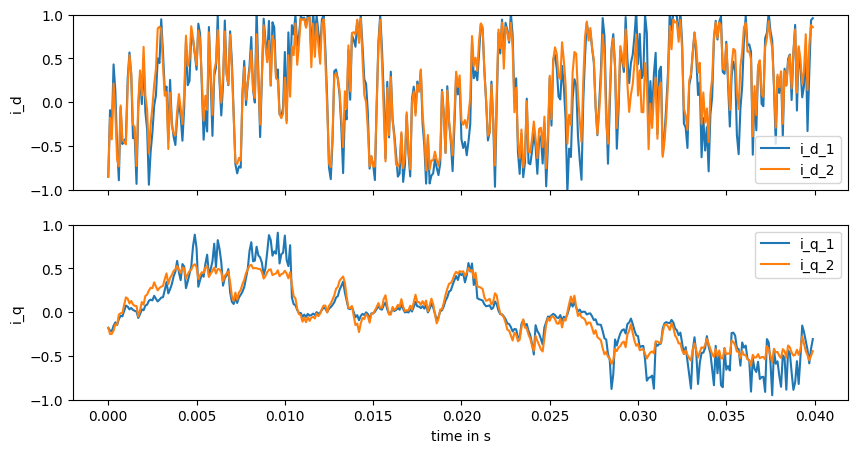

 28%|█████████████████████████████████████████████                                                                                                                    | 27998/100000 [11:10<32:46, 36.61it/s]

Current val_loss: 0.020031955


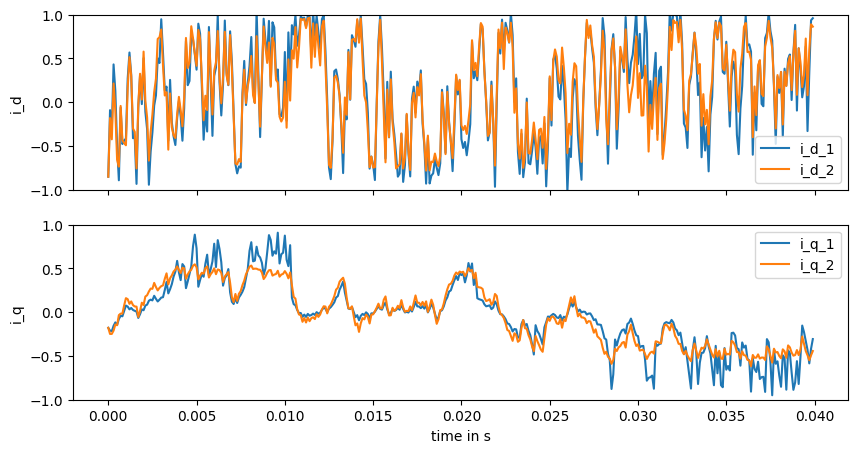

 30%|████████████████████████████████████████████████▎                                                                                                                | 29998/100000 [12:05<31:46, 36.71it/s]

Current val_loss: 0.019428428


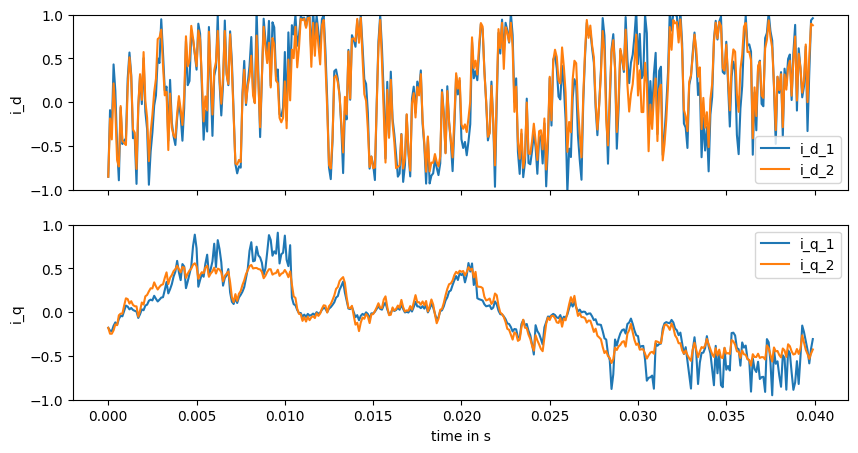

 32%|███████████████████████████████████████████████████▌                                                                                                             | 31998/100000 [13:00<30:53, 36.68it/s]

Current val_loss: 0.018334704


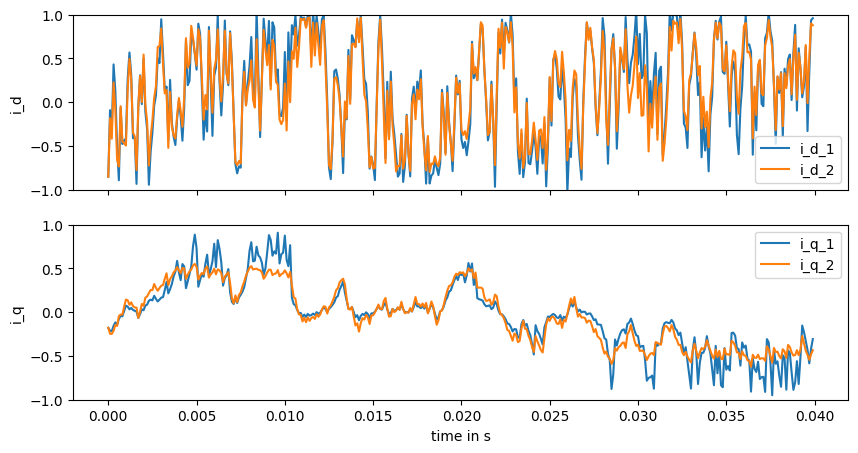

 34%|██████████████████████████████████████████████████████▋                                                                                                          | 33998/100000 [13:55<29:53, 36.79it/s]

Current val_loss: 0.019596472


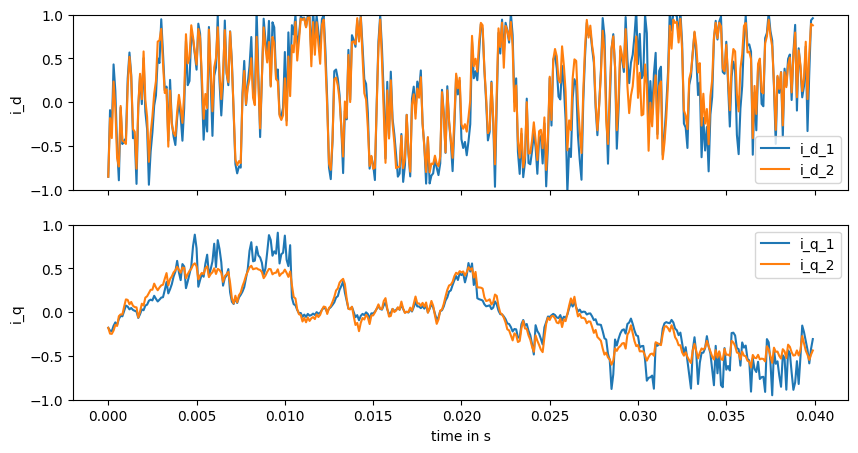

 36%|█████████████████████████████████████████████████████████▉                                                                                                       | 35998/100000 [14:44<24:44, 43.11it/s]

Current val_loss: 0.018105233


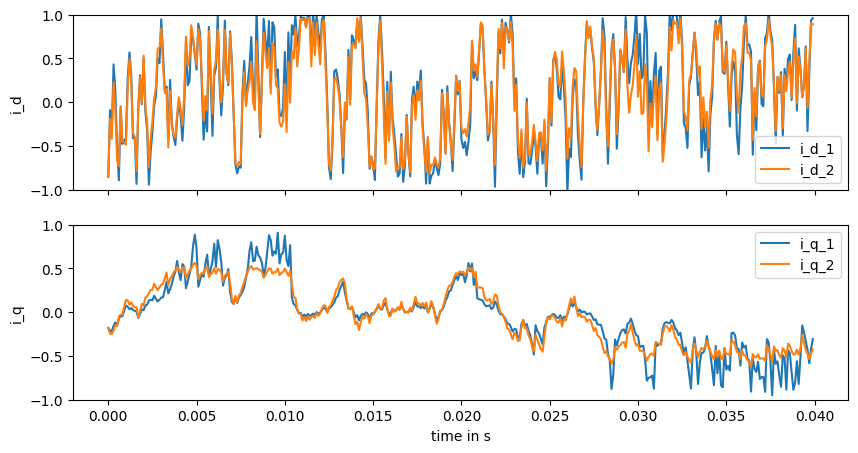

 38%|█████████████████████████████████████████████████████████████▏                                                                                                   | 37998/100000 [15:30<23:30, 43.95it/s]

Current val_loss: 0.01878823


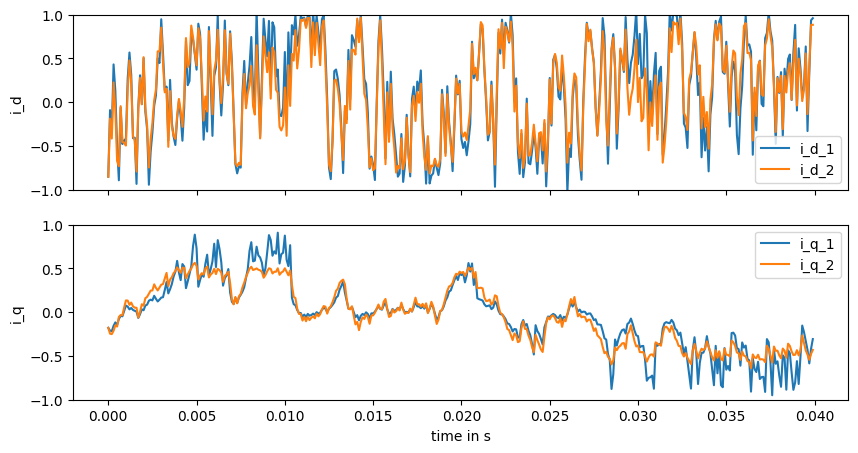

 40%|████████████████████████████████████████████████████████████████▍                                                                                                | 39998/100000 [16:16<23:03, 43.37it/s]

Current val_loss: 0.01942606


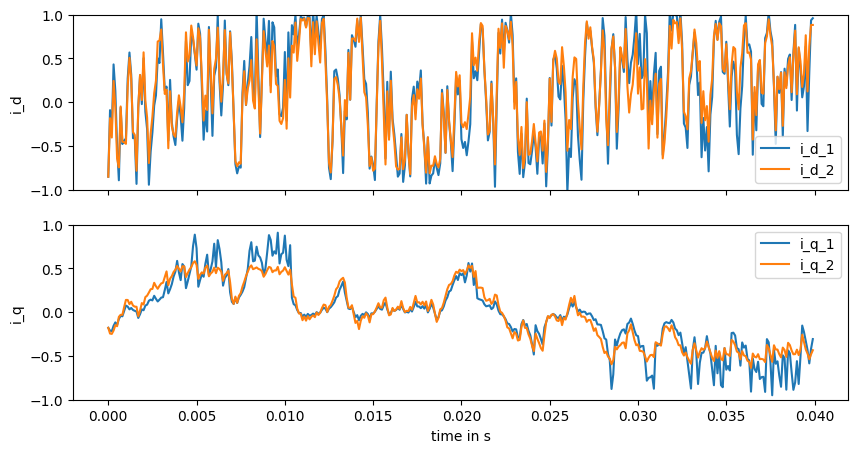

 42%|███████████████████████████████████████████████████████████████████▌                                                                                             | 41998/100000 [17:02<21:56, 44.07it/s]

Current val_loss: 0.018462922


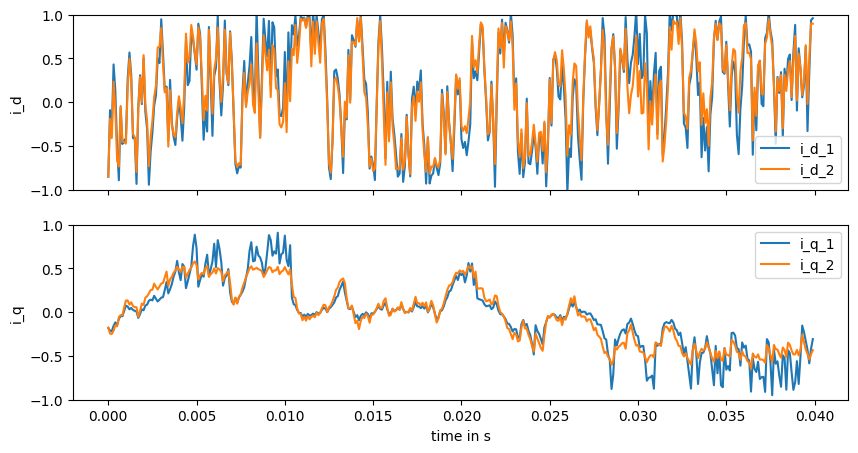

 44%|██████████████████████████████████████████████████████████████████████▊                                                                                          | 43998/100000 [17:48<21:11, 44.05it/s]

Current val_loss: 0.019828731


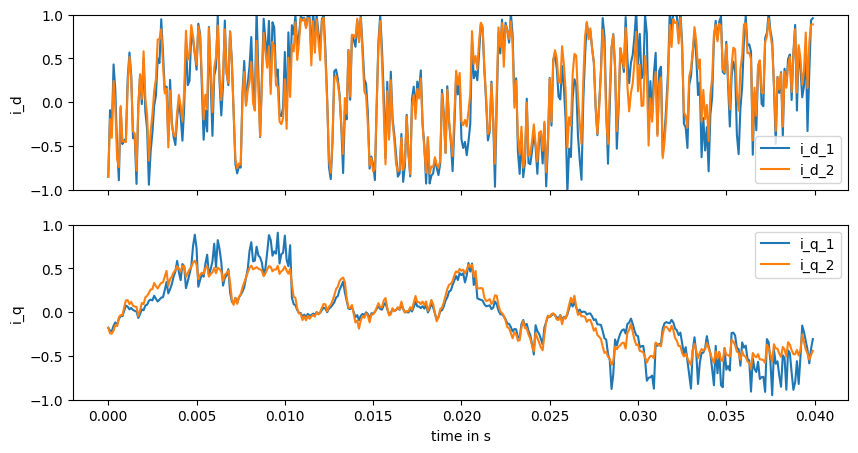

 46%|██████████████████████████████████████████████████████████████████████████                                                                                       | 45998/100000 [18:34<20:25, 44.07it/s]

Current val_loss: 0.018797351


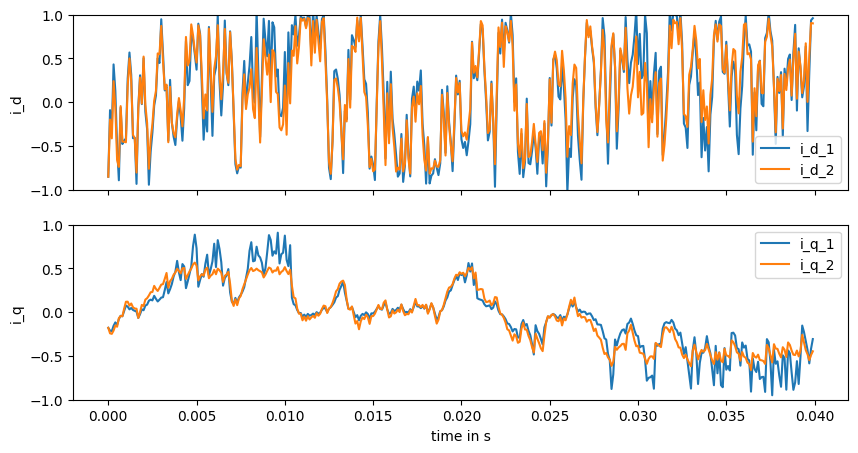

 48%|█████████████████████████████████████████████████████████████████████████████▎                                                                                   | 47998/100000 [19:20<19:43, 43.93it/s]

Current val_loss: 0.01859745


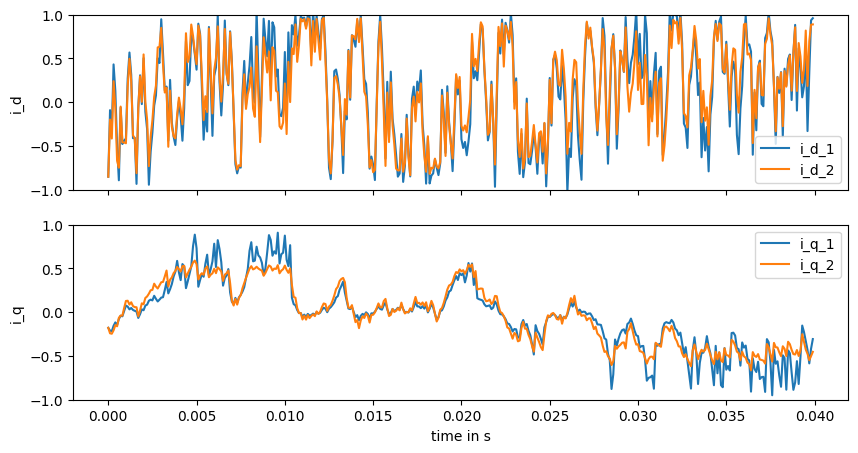

 50%|████████████████████████████████████████████████████████████████████████████████▍                                                                                | 49998/100000 [20:06<18:55, 44.04it/s]

Current val_loss: 0.020445593


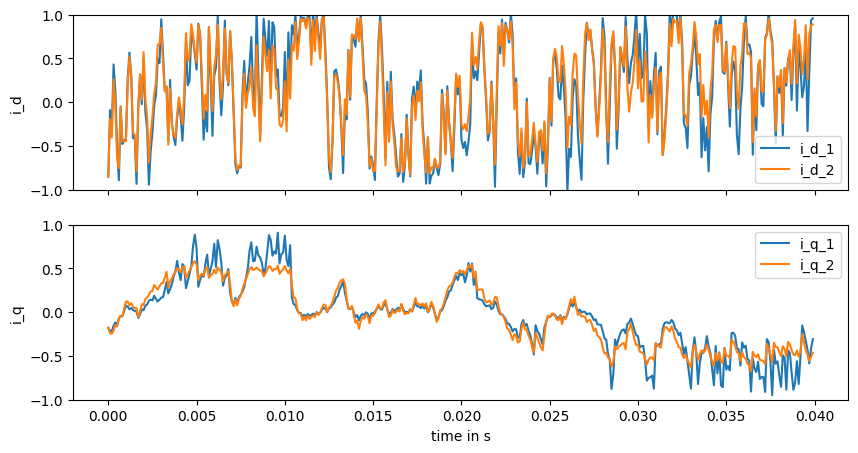

 52%|███████████████████████████████████████████████████████████████████████████████████▋                                                                             | 51998/100000 [20:52<18:08, 44.11it/s]

Current val_loss: 0.018950786


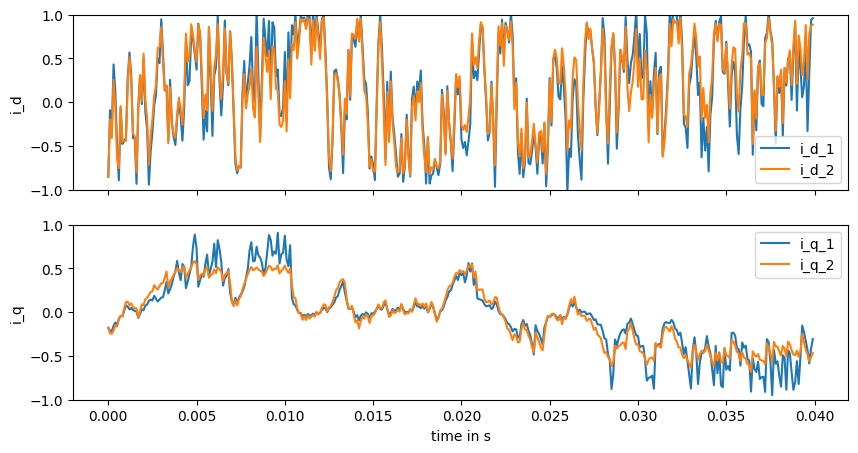

 54%|██████████████████████████████████████████████████████████████████████████████████████▉                                                                          | 53998/100000 [21:38<17:31, 43.74it/s]

Current val_loss: 0.019174673


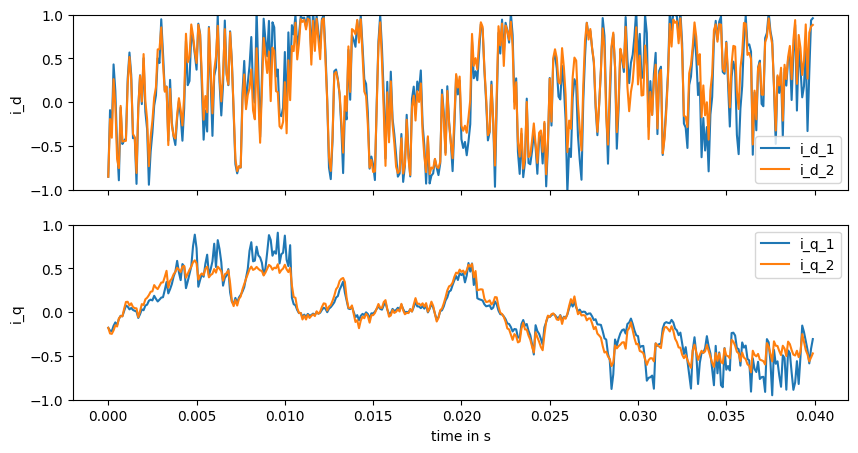

 56%|██████████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 55998/100000 [22:24<16:45, 43.78it/s]

Current val_loss: 0.019640137


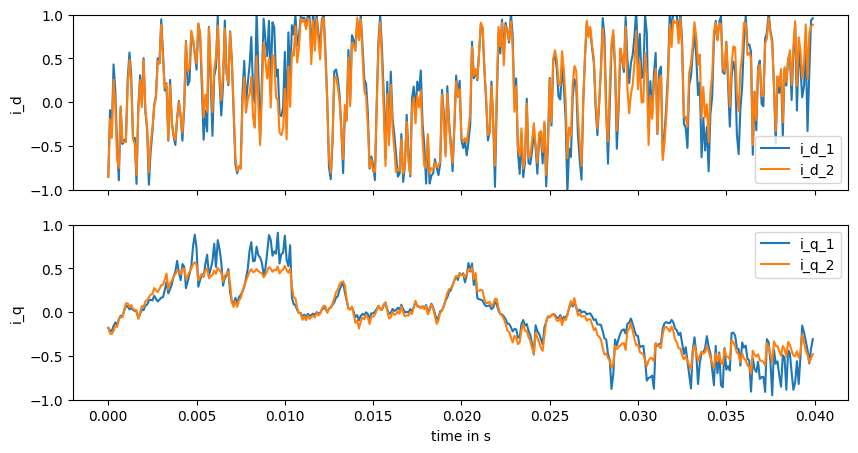

 58%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                                   | 57998/100000 [23:10<15:57, 43.85it/s]

Current val_loss: 0.02046972


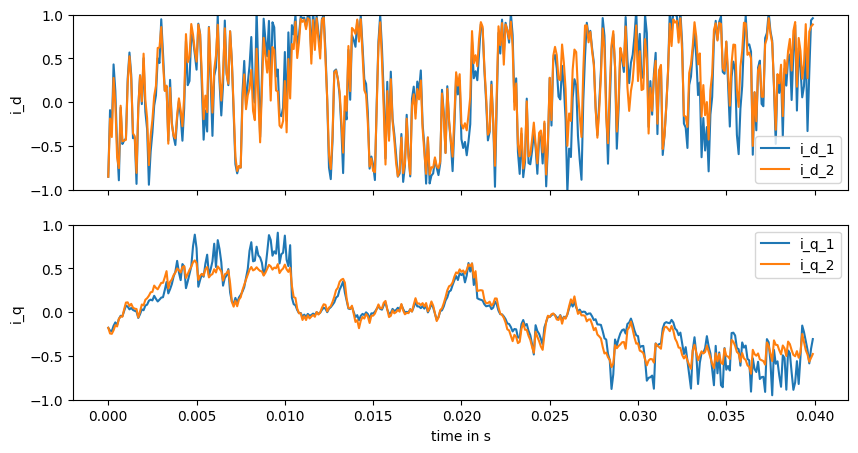

 60%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 59998/100000 [23:57<15:26, 43.19it/s]

Current val_loss: 0.018869065


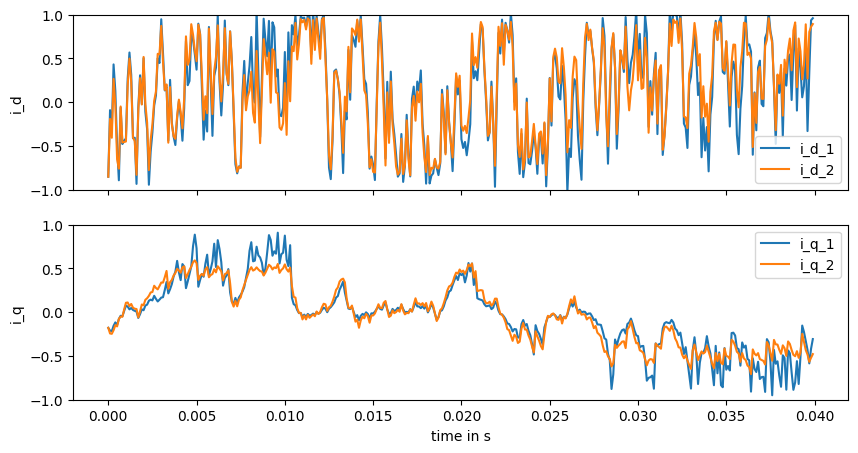

 62%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 62000/100000 [24:51<17:19, 36.57it/s]

Current val_loss: 0.017789396


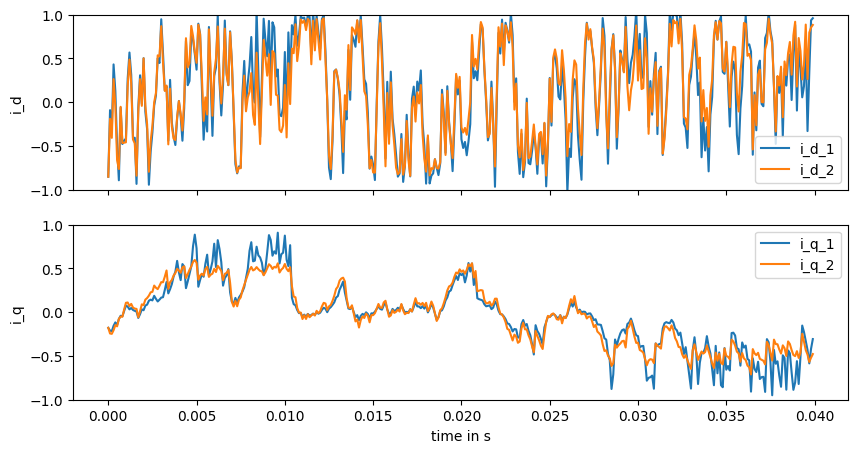

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 63998/100000 [25:42<13:37, 44.03it/s]

Current val_loss: 0.01861964


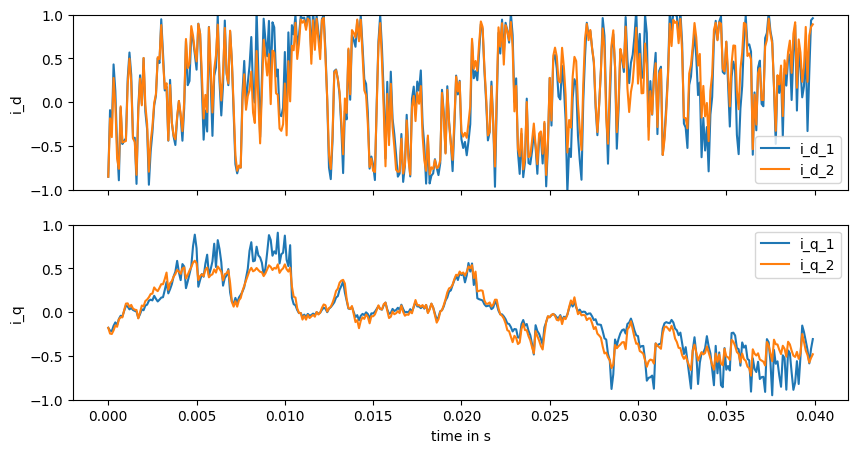

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 65998/100000 [26:29<12:55, 43.87it/s]

Current val_loss: 0.018559314


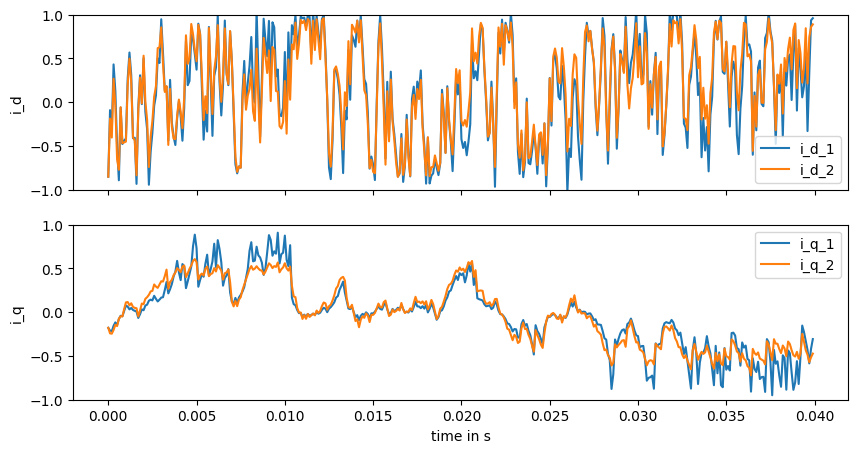

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                   | 67998/100000 [27:16<12:13, 43.61it/s]

Current val_loss: 0.017230133


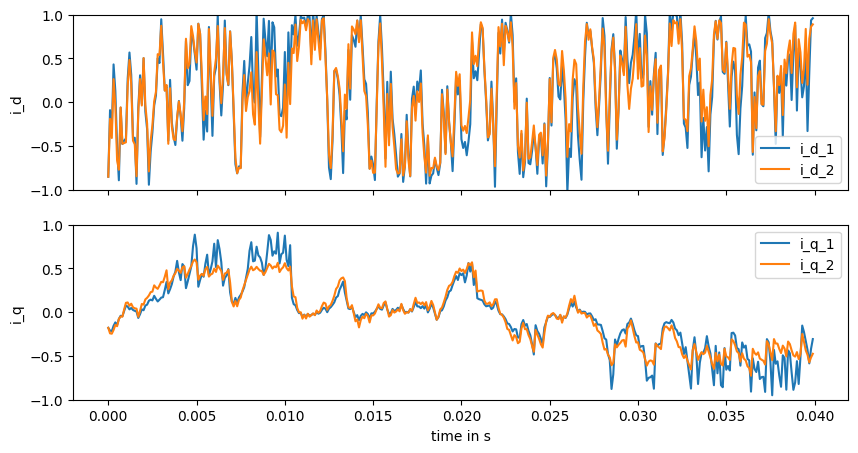

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 69998/100000 [28:02<11:20, 44.06it/s]

Current val_loss: 0.02031885


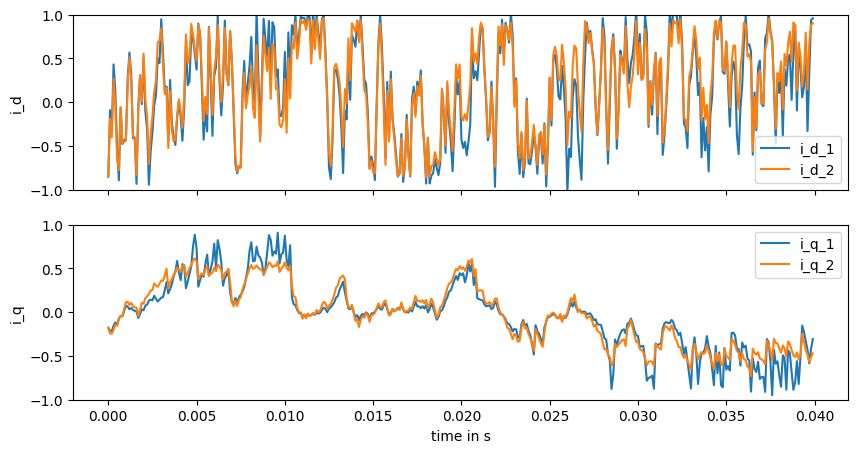

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 71998/100000 [28:48<10:39, 43.78it/s]

Current val_loss: 0.020482035


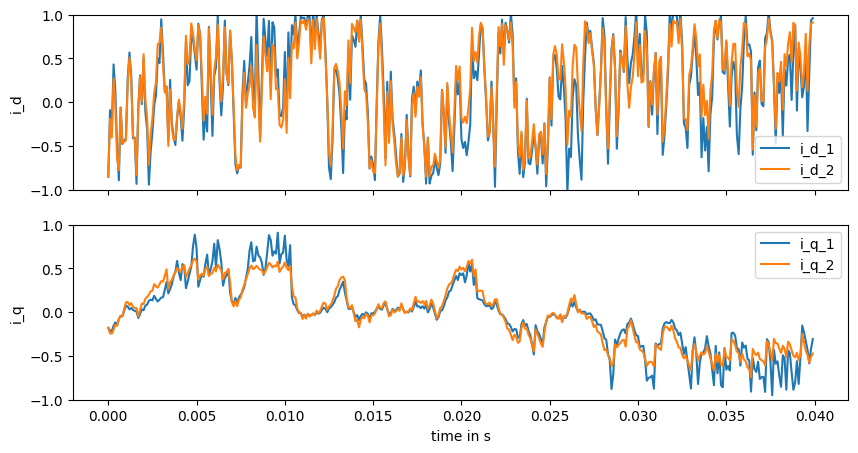

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 73998/100000 [29:34<09:50, 44.04it/s]

Current val_loss: 0.017900623


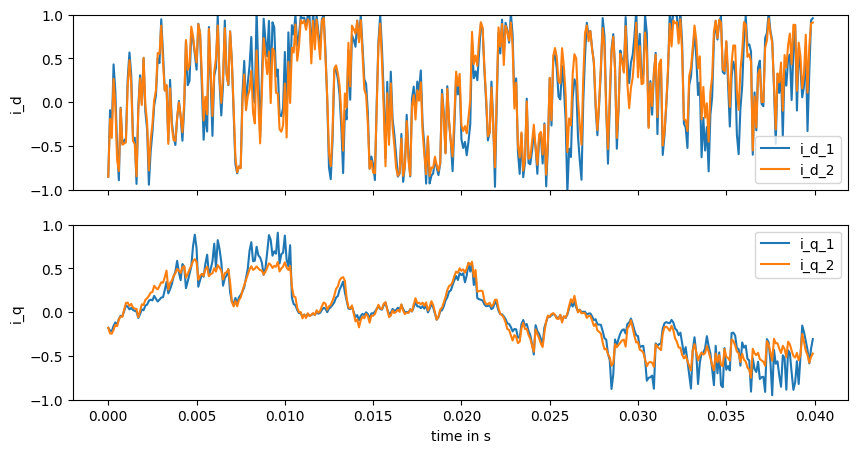

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 75998/100000 [30:20<09:04, 44.06it/s]

Current val_loss: 0.017249836


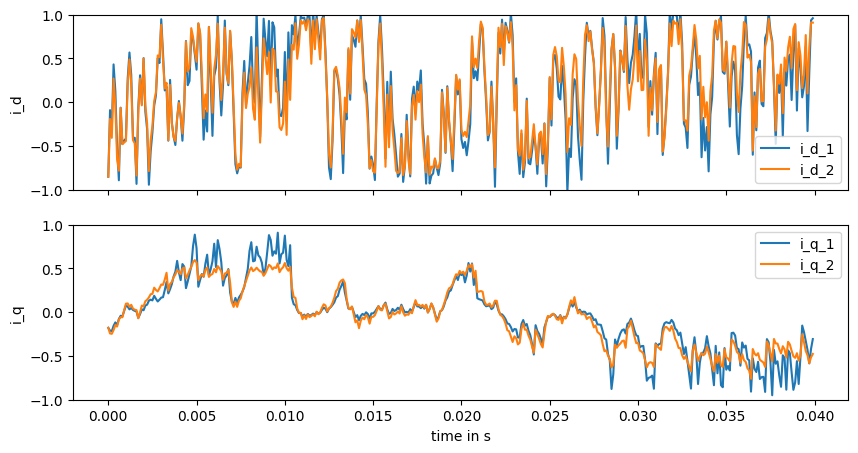

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 77998/100000 [31:06<08:20, 43.96it/s]

Current val_loss: 0.016794123


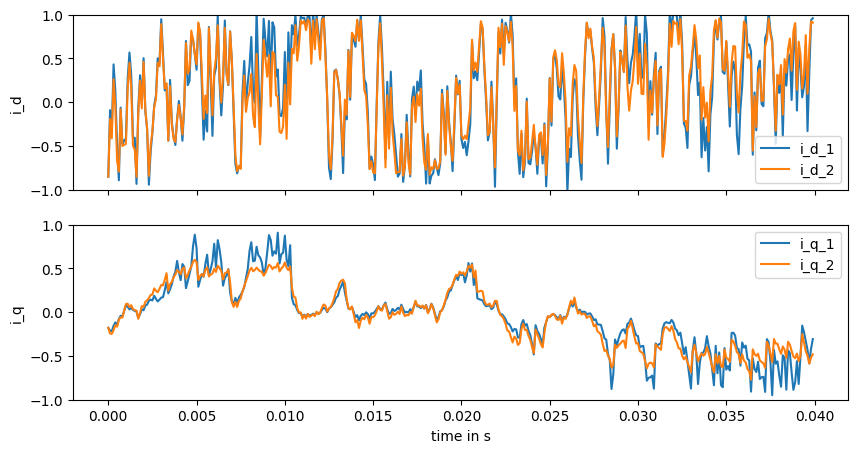

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 79997/100000 [31:52<07:34, 44.01it/s]

Current val_loss: 0.01610058


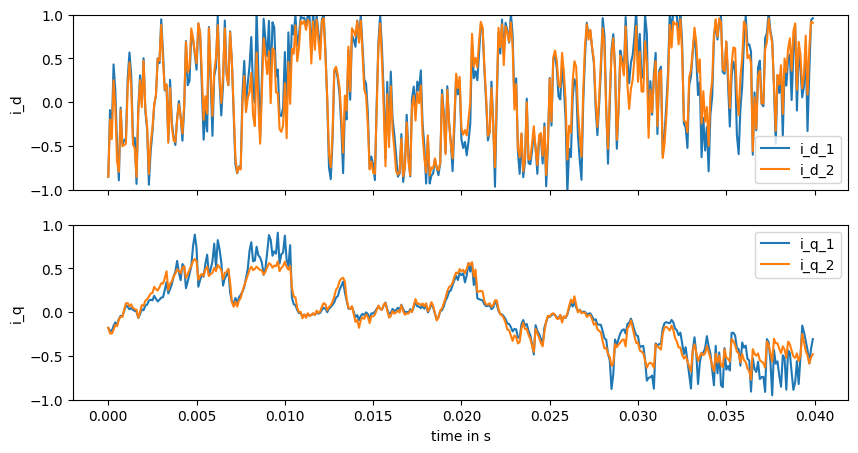

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 81997/100000 [32:38<06:47, 44.16it/s]

Current val_loss: 0.016452923


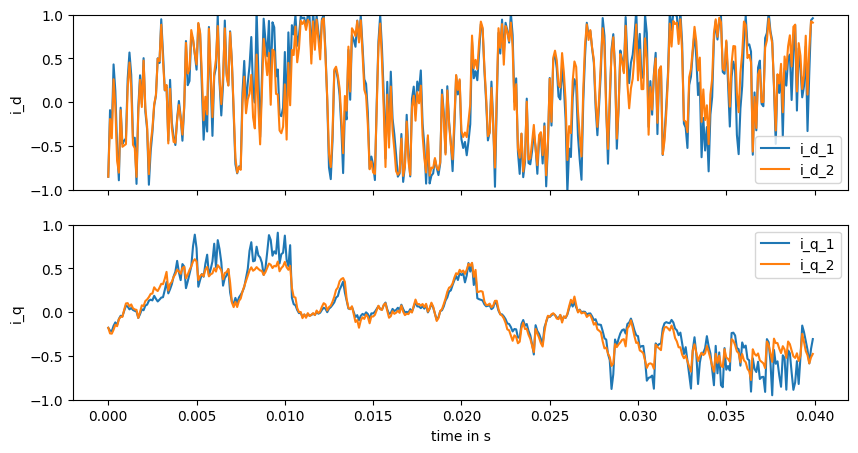

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 83997/100000 [33:24<06:06, 43.70it/s]

Current val_loss: 0.016482018


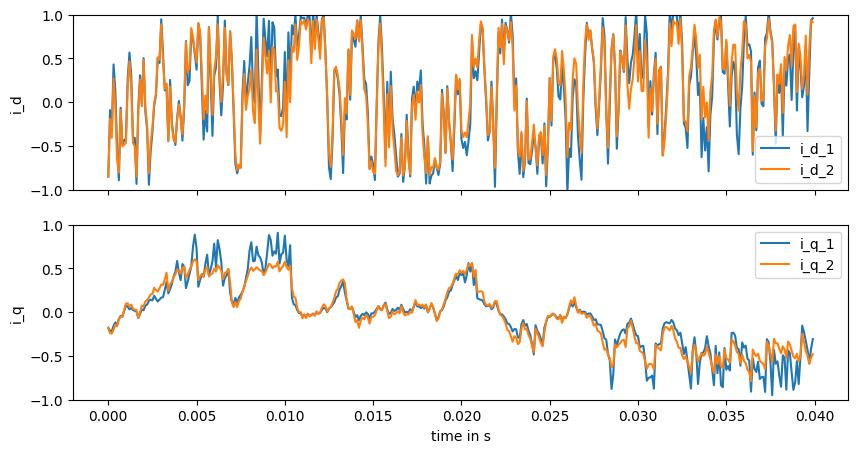

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 85997/100000 [34:10<05:18, 43.99it/s]

Current val_loss: 0.016357394


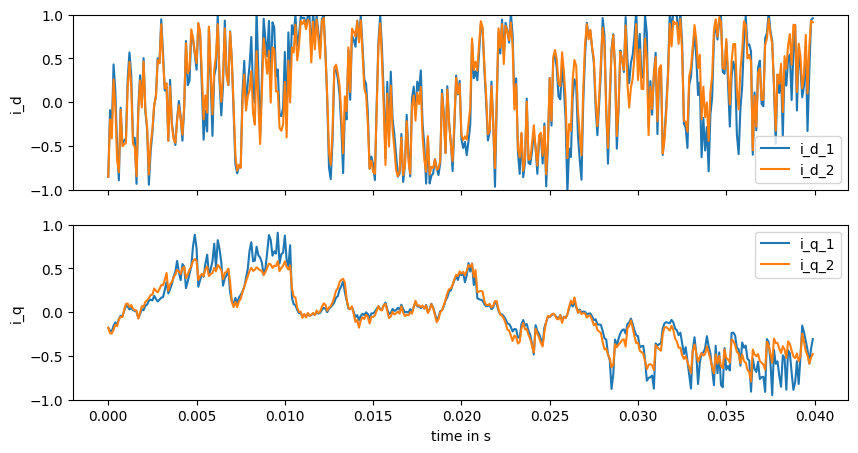

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 87997/100000 [34:56<04:34, 43.76it/s]

Current val_loss: 0.016260192


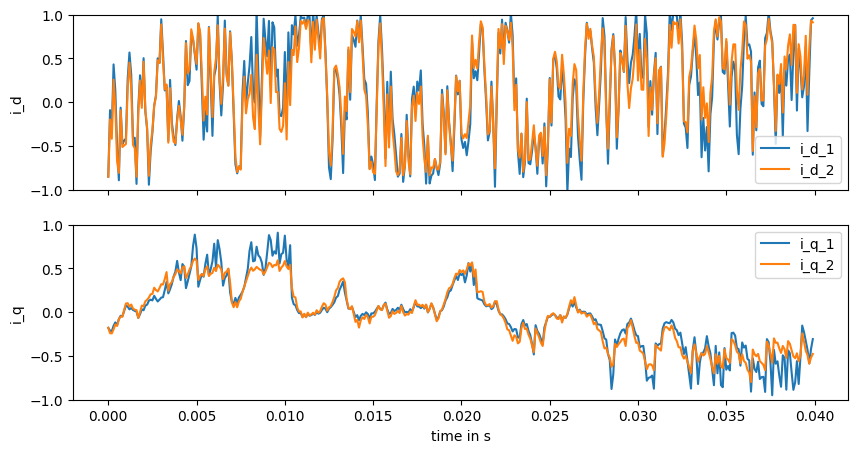

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 89997/100000 [35:42<03:46, 44.07it/s]

Current val_loss: 0.015847037


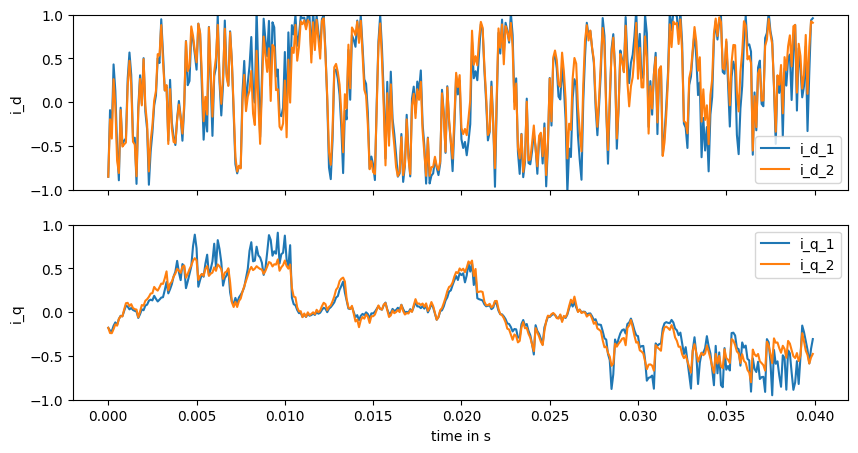

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 91997/100000 [36:28<03:01, 44.01it/s]

Current val_loss: 0.016115047


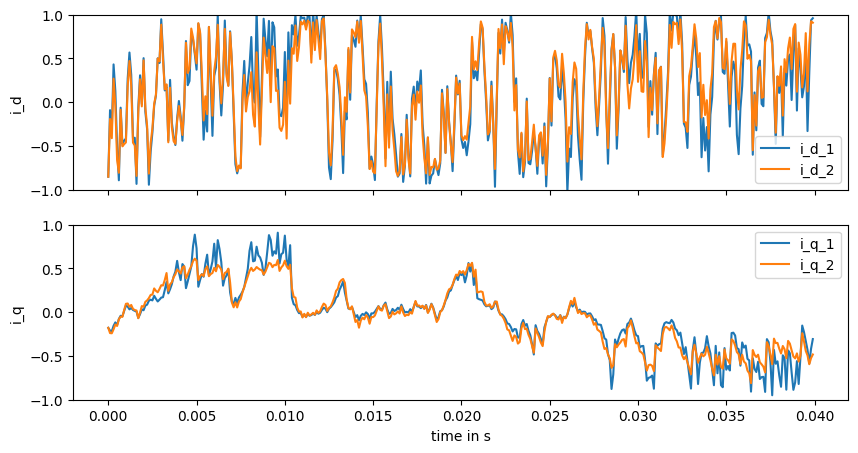

 94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 93997/100000 [37:14<02:16, 44.12it/s]

Current val_loss: 0.015403726


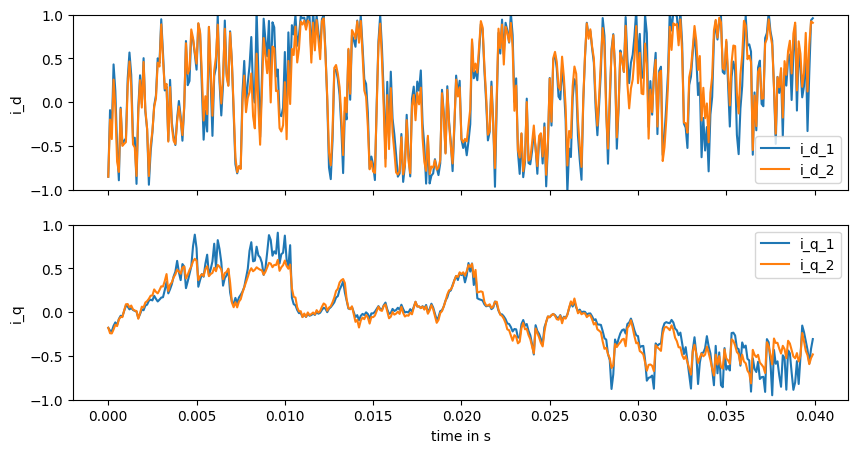

 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 95997/100000 [38:00<01:31, 43.62it/s]

Current val_loss: 0.015327117


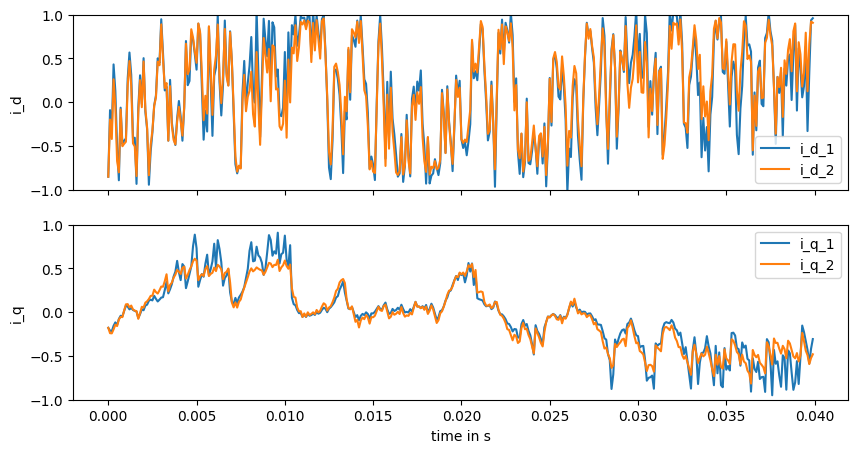

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 97997/100000 [38:46<00:45, 44.14it/s]

Current val_loss: 0.014608566


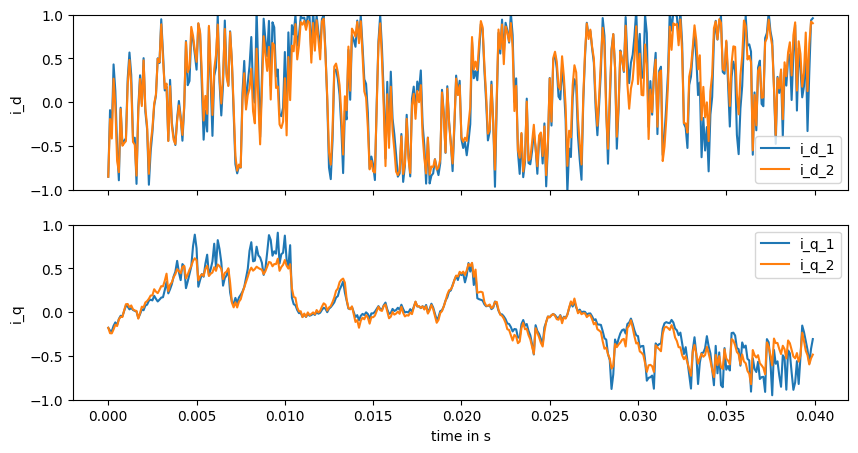

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 100000/100000 [39:32<00:00, 42.15it/s]


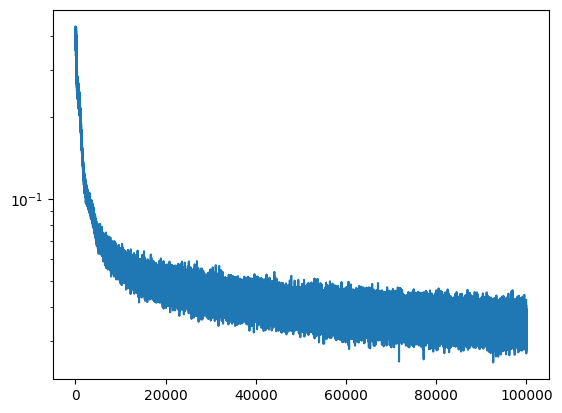

In [21]:
fin_node_100,fin_opt_state,fin_keys,losses, val_losses=mtrainer.fit_non_jit(node,opt_state,keys,plot_every=2000)
plt.plot(losses)
plt.yscale('log')

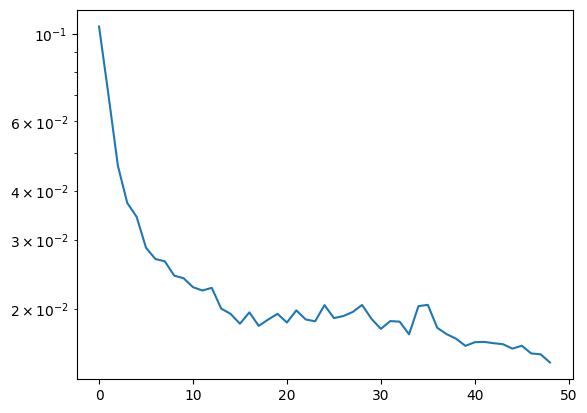

In [24]:
plt.plot(val_losses)
plt.yscale('log')

In [23]:
eqx.tree_serialise_leaves("trained_models/DMPE_Model_100k_100len_100b_step0_0001.eqx", fin_node_100)

In [ ]:
#eqx.tree_serialise_leaves("trained_models/Model_100k_100len_100b_step0_0001.eqx", fin_node_100)
#model_loaded = eqx.tree_deserialise_leaves("trained_models/Model1.eqx", node)

In [ ]:
@eqx.filter_jit
def reset_env(env,rng):
    obs, _ = env.reset(env.env_properties, rng)  #
    obs = obs.at[2].set((3*1500 / 60 * 2 * jnp.pi) / (2 * jnp.pi * 3 * 11000 / 60))
    return obs

In [ ]:
from utils.evaluation import steps_eval_node

In [ ]:
#_,_,_=steps_eval_node(motor_env,fin_node_1,motor_env.tau,reset_env,fin_policy2,featurize,featurize_node,jax.random.PRNGKey(4),2000)